# NotebookProblem Earth.0
## Setup
The following code sets some information on you computer and within python so that we can use NASA's Application Programming Interface or API. Run it by clicking in the cell then typing `Shift-Enter`. Note that each of the Earth problems build upon eachother, so complete them in order.

## Trouble Shooting
If doing that produces any output (an error), make sure that you have run
`pip3.5 install --user nasa-api-wrapper` 
from your bash console, and go to `Kernel->Restart` in the menu.

## Notebook Tips
Don’t forget to `File→Save and Checkpoint` to save your work as you progress throughout the problems. 

In [3]:
from nasa import earth
from IPython.display import display
import os
os.environ["NASA_API_KEY"]="F39Ns48L1oD5eCgTLurLmZFipW6UUyq2t5RkAep6"

# NotebookProblem Earth.1:
## Exploring
Execute the following code to see a real satellite image from the Landsat 8 satellite from February 2, 2017.

The satellite passes over each point on earth roughly once every sixteen days! Wow!

After you have an image, start exploring different dates for the same location.

In [ ]:
from nasa import earth
from IPython.display import display
display(earth.image(lat=-5.126424,lon=105.539658,date='2017-02-01').image)

# NotebookProblem Earth.2: 
## Numerical Types
Execute the following code, there is an error. What does the error say?  Next, try using all different options (A B C D or E) in place of string_lat, which one works?

In [ ]:
from nasa import earth
string_lat = "-5.126424" # Option A)
float_lat = -5.126424    # Option B)
int_lat = -5             # Option C)
bool_lat = False         # Option D)
none_lat = None          # Option E)
my_image = earth.image(lat=float_lat,lon=105.539658,date='2017-02-01')
display(my_image.image)

# NotebookProblem Earth.3: 
## Type function
Use the type function to look into the types by running the following 4 times in a row

In [ ]:
from random import choice
string_lat = "-5.126424" # Option A)
float_lat = -5.126424    # Option B)
int_lat = -5             # Option C)
bool_lat = False         # Option D)
none_lat = None          # Option E)

mystery_lat=choice([string_lat,float_lat,int_lat,bool_lat,none_lat])
type(mystery_lat)

# NotebookProblem Earth.4: 
## Variables
The following line is really long and complicated, fix it by creating new variables named `my_lat` and `my_lon` and doing the computation of their values prior to using them. 

Your solution should be two lines of code longer than the following one, and if it's correct it will output an image!

In [ ]:
my_lat = 0.000424-5.126-6+30003+7-4+9-30009
my_lon = 105+.5+.03+.009+6e-4+5e-5+8e-8
#my_image=earth.image(lat= my_lat, lon=my_lon, date='2017-02-01')

#display(my_image.image)
print(my_lat, my_lon)

# NotebookProblem Earth.5: 
## Assignment Puzzle
One of your fellow students has set the variables my_lat and my_date to the wrong things. The should be `-5.126424`, and `'2017-02-01'` respectively but instead `my_date` is `-5.126424` and `my_lat` is `'2017-02-01'`

Switch them back using just one additional variable `my_tmp`. Your final code should contain only `my_tmp`, `my_lat`, `my_date` and `=`. It should be 3 lines or less and it should NOT contain `-5.126424` or `'2017-02-01'`.

In [ ]:
# Don't change this line lines:
my_lat,my_date=('2017-02-01',-5.126424)

# Your code goes here and should not contain anything but my_date, my_lat, my_tmp and the = sign. 
my_tmp = my_lat
my_lat, my_date = (my_date, my_tmp)



#check
print('my date:', my_date, 'my lat:', my_lat)


# Now we can see if your code is correct
If it is the following will say "you are correct". If it doesn't, then go back to the previous step and keep working. 

In [ ]:
def is_correct(lat,date):
    if lat==-5.126424 and date=='2017-02-01':
        print("you are correct!")
    elif lat==5.125424:
        print("your latitute is positive instead of negative")
        print("keep trying")
    else:
        print("way off keep trying")

is_correct(my_lat,my_date)

# NotebookProblem Earth.6:
## Operators

* The number of kilometers per degree of longitude is approximately
$$2\pi/360 * r_{earth} * \cos(\theta)$$
(where $\theta$ is the latitude in degrees and $r_{earth}$ is approximately 6378 km)
* The number of kilometers per degree of latitude is approximately the same at all locations and is approx
$$2\pi/360 * r_{earth} = 111 \text{km/degree}$$
* As long as dx and dy are small compared to the radius of the earth and you don't get too close to the poles, from an old latitude/longitude you can compute a new latitude/longitude $dx$ and $dy$ kilometers away with the following formulae:
$$\text{latitude}_{new}  = \text{latitude}_{old}  + \frac{dy}{ r_{earth}} * (180 / \pi)$$
$$\text{longitude}_{new} = \text{longitude}_{old} + \frac{dx}{ r_{earth}} * \frac{(180 / \pi)}{ \cos(\text{latitude}_{old} * \pi/180)}$$
* Each Landsat 8 image is 115 miles by 115 miles. The conversion from kilometers to miles is that 1 kilometer is equal to 0.621371 miles.

## Problem:
Start with a latitude of 1.5 and a longitude of 100.75. 
1. Compute the longitude of an image 115 miles away in longitude at the same latitude of 1.5. 
1. Compute the latitude of an image 115 miles away in latitude at the same longitude of 100.75
1. Compute the longitude and latitude of an image 115 miles away in both latitude and in longitude.
1. using `earth.image` as in NotebookProblem Earth.1 display all three images. What do you notice about the images that aren't 115 miles away in both latitude and in longitude?

## Hints
* you might need pi and cosine. try `from math import pi, cos`. Then you can compute the cosine using `cos(variable)` and use pi by typing `pi`. Try it out below before you try anything more complicated.
* you might not find any images for a particular date in your new coordinates. Try instead searching for a range of images, and displaying the first one in that range if any is found with the following code snippet:
```
assets = earth.assets(lat=1.5, lon=100.75, begin='2014-02-01', end='2014-06-01')
if assets:
    display(assets[0].get_asset_image().image)
```

In [ ]:
from math import *
from nasa import earth
from IPython.display import display
dmiles = 2
dkm = dmiles/.621371
initlong = 100.75
rearth = 6378
initlat = 1.5


#part 1
newlong = initlong + (dkm/rearth)*((180/pi)/(cos(initlat * (pi/180))))
print(initlat, newlong)

#part 4
assets = earth.assets(lat=initlat, lon=newlong, begin='2014-02-01', end='2014-06-01')
if assets:
    display(assets[0].get_asset_image().image)
    
#part 2
newlat = initlat + (dkm/rearth)*(180/pi)
print(newlat, initlong)

#part 4
assets = earth.assets(lat=initlat, lon=newlong, begin='2014-02-01', end='2014-06-01')
if assets:
    display(assets[0].get_asset_image().image)
    
#part 3
print(newlat, newlong)

#part 4
assets = earth.assets(lat=initlat, lon=newlong, begin='2014-02-01', end='2014-06-01')
if assets:
    display(assets[0].get_asset_image().image)

# NotebookProblem Earth.7: 
## Conditionals (if/else)
Latitude measurements range from -90° to 90°. Longitude measures how far east or west of the prime meridian a place is located. The prime meridian runs through Greenwich, England. Longitude measurements range from -180 to 180°. 

One of your classmates has defined the variables `my_lat` and `my_lon` for you, and unfortunately they aren't always in the right ranges. Use an *if statement* to check if each variable is in the correct range. If it is, then there's nothing to do. But if it isn't you should set it to 0.

When you are done, have a friend look at or *review* your code, and look at theirs. Do you think it is correct? Did you do the same exact thing, or accomplish the same goals by different means?

In [ ]:
# Don't change these lines
from random import uniform
my_lat=uniform(-400,400)
my_lon=uniform(-400,400)

# Part 1: Create and if statement to check if my_lat is in the correct range, and if not set it to 0
if my_lat > 90 or my_lat < -90:
    my_lat = 0
# Part 2: Create an if statement to check if my_lon is in the correct range, and if not set it to 0
if my_lon > 180 or my_lon < -180:
    my_lon = 0

# NotebookProblem Earth.8:
## While loops

In this problem use a while loop to print out a date of every February 1 from the 1984 - 2017 in the format: 'YEAR-02-01', skipping the year that you were born.

### Hints
* Did you know you can add strings together too with the operator `+`? For example 
`'2014'+'-02-01'` results in `'2014-02-01'`. Try it out!

* Don't forget that you can convert numbers to strings with `str`. For example for `2014` `str(2014)` outputs `'2014'`
* somewhere in the while loop you should be incremeting a variable. If you aren't, the while loop will run forever!

In [ ]:
# Your code goes here
year = 1983
while year <= 2016:
    year += 1
    if year == 2000:
        continue
    print(str(year)+'-02-01')


# NotebookProblem Earth.9:
## For Loops
In the following problem ,the variable `assets` is set to be the result of querying NASA for all Landsat 8 satellite images at a particular location (latitude of 1.5 and a longitude of 100.75) between February 1, 2004 and June 1, 20014. 

Write a `for` loop to print each of the assets. 

### Hint
Your code should add just two lines.
When run, your code should end up printing 8 lines that look something like 
```
<NasaEarthAsset id="LC8_L1T_TOA/LC81270592014035LGN00">
<NasaEarthAsset id="LC8_L1T_TOA/LC81270592014051LGN00">
<NasaEarthAsset id="LC8_L1T_TOA/LC81270592014067LGN00">
<NasaEarthAsset id="LC8_L1T_TOA/LC81270592014083LGN00">
<NasaEarthAsset id="LC8_L1T_TOA/LC81270592014099LGN00">
<NasaEarthAsset id="LC8_L1T_TOA/LC81270592014115LGN00">
<NasaEarthAsset id="LC8_L1T_TOA/LC81270592014131LGN00">
<NasaEarthAsset id="LC8_L1T_TOA/LC81270592014147LGN00">
```

In [ ]:
from nasa import earth
assets = earth.assets(lat=1.5, lon=100.75, begin='2014-02-01', end='2014-06-01')
# your for loop goes here:

for i in assets:
    print(str(i)+"\n")

# NotebookProblem Earth.10:
## Capstone Problem: Estimating Cloud Cover and Diagnosing Droughts
This problem will require significantly more effort than any NotebookProblem or Exercise thus far, as it is a capstone problem incorporating skills you have learned throughout the chapter.

Throughout this Notebook we've been working with Landsat 8 imager. In this exercise we will use this imagery to estimate how much rain a particular area of Los Angeles has received over the past two years.

According to https://earthobservatory.nasa.gov/blogs/elegantfigures/2013/10/22/how-to-make-a-true-color-landsat-8-image/:
> Since its launch in February 2013, Landsat 8 has collected about 400 scenes of the Earth’s surface per day. Each of these scenes covers an area of about 185 by 185 kilometers (115 by 115 miles)—34,200 square km (13,200 square miles)—for a total of 13,690,000 square km (5,290,000 square miles) per day. An area about 40% larger than the united states. Every day.



## Part 1
Explore the following code which has a rough estimation of how much cloud cover is in an image. Run the code and look at the output. Try changing the percentage white, and see if you agree with the results more or less.

In [ ]:
def fraction_white_pixels(image):
    # Greyscale ranges from 0 (black) to 255 (white). 
    image_dimensions_in_pixels=image.size[0]*image.size[1]
    colors=image.convert('L').getcolors(image_dimensions_in_pixels) #converts image to greyscale then gets colors
    n_pixels_closeto_white=0
    for pixel_count,color in colors:
        if color/255>0.80: # this is checking if it's more than 80% white
            n_pixels_closeto_white+=pixel_count
    return n_pixels_closeto_white/image_dimensions_in_pixels


assets = earth.assets(lat=1.5, lon=100.75, begin='2014-02-01', end='2014-06-01')
for a in assets:
    f=fraction_white_pixels(a.get_asset_image().image)
    print("Cloud cover fraction:",f)
    display(a.get_asset_image().image)


## Part 2
In this section figure out a particular place in California, for example Pasadena, and use its latitude and longitude to retrieve some Landsat 8 images. Note that if you remove the end date from `earth.assets` that will retrieve all the images up to the present day. Get out some images and display them, using a `for` loop and the `display` command as above. 

In [ ]:
# Your code goes here
from nasa import earth
from IPython.display import display
assets = earth.assets(lat=34.145, lon=-118.25, begin='2014-02-01', end='2014-06-01')
for i in assets:
    display(i.get_asset_image().image)

## Part 3
In this section work with the same images as you did in part 2, but by creating two new variables compute the average cloud cover over the given dates. Feel free to paste some of your code from part 2 into the cell to get started.

In [ ]:
from nasa import earth
from IPython.display import display


def fraction_white_pixels(image):
    # Greyscale ranges from 0 (black) to 255 (white). 
    image_dimensions_in_pixels=image.size[0]*image.size[1]
    colors=image.convert('L').getcolors(image_dimensions_in_pixels) #converts image to greyscale then gets colors
    n_pixels_closeto_white=0
    for pixel_count,color in colors:
        if color/255>0.70: # this is checking if it's more than 80% white
            n_pixels_closeto_white+=pixel_count
    return n_pixels_closeto_white/image_dimensions_in_pixels


assets = earth.assets(lat=32.7157, lon=117.1611, begin='2014-02-01', end='2014-06-01')
alldatecoverage = 0
counter = 0
for a in assets:
    f=fraction_white_pixels(a.get_asset_image().image)
    alldatecoverage += f
    counter+=1
    print("Cloud cover fraction:",f)
    display(a.get_asset_image().image)
print("The average cloud coverage is: " + str(alldatecoverage/counter))


## Part 4
In this section we'll again ignore cloud cover. As a reminder, Landsat 8's images are 115 x 115 mile square, and the latitude and longitude asked for are at the center of the image.

1. For a given latitude of 1.5 and longitude of 100.75, write some code to compute the latitude and longitude of the center of all the images bordering the original latitude and longitude specified 
* how many patches bordering the original latitude/longitude should there be?
* what is the total surface area of the entire patch including the center square? use python to compute it
2. Once you have the coordinates, try retrieving Landsat 8 images corresponding to those coordinates. Refer back to **NotebookProblem Earth.6** to recall how to approximate latitude/longitude to mile changes and feel free to copy and paste some of your code here for usage. 

In [ ]:
# Your code goes here, and you should be able to print out the centers of images bordering this latitude/longitude.
from math import *
from nasa import earth
from IPython.display import display
dmiles = 2
dkm = dmiles/.621371
initlong = 100.75
rearth = 6378
initlat = 1.5

#center
print(initlat, initlong)
assets = earth.assets(lat=initlat, lon=initlong, begin='2014-02-01', end='2014-06-01')
if assets:
    display(assets[0].get_asset_image().image)

#top
newlongtop = initlong + (dkm/rearth)*((180/pi)/(cos(initlat * (pi/180))))
print("top", initlat, newlongtop)

assets = earth.assets(lat=initlat, lon=newlongtop, begin='2014-02-01', end='2014-06-01')
if assets:
    display(assets[0].get_asset_image().image)

#right
newlatright = initlat + (dkm/rearth)*(180/pi)
print("r", newlatright, initlong)

assets = earth.assets(lat=newlatright, lon=initlong, begin='2014-02-01', end='2014-06-01')
if assets:
    display(assets[0].get_asset_image().image)

#bottom
newlongbottom = initlong + (-dkm/rearth)*((180/pi)/(cos(initlat * (pi/180))))
print("bottom", initlat, newlongbottom)

assets = earth.assets(lat=initlat, lon=newlongbottom, begin='2014-02-01', end='2014-06-01')
if assets:
    display(assets[0].get_asset_image().image)

#left
newlatleft = initlat + (-dkm/rearth)*(180/pi)
print("l", newlatleft, initlong)

assets = earth.assets(lat=newlatleft, lon=initlong, begin='2014-02-01', end='2014-06-01')
if assets:
    display(assets[0].get_asset_image().image)

#topright
print("tr", newlatright, newlongtop)

assets = earth.assets(lat=newlatright, lon=newlongtop, begin='2014-02-01', end='2014-06-01')
if assets:
    display(assets[0].get_asset_image().image)

#bottomright
print("br", newlatright, newlongbottom)

assets = earth.assets(lat=newlatright, lon=newlongbottom, begin='2014-02-01', end='2014-06-01')
if assets:
    display(assets[0].get_asset_image().image)

#topleft
print("tl", newlatleft, newlongtop)

assets = earth.assets(lat=newlatleft, lon=newlongtop, begin='2014-02-01', end='2014-06-01')
if assets:
    display(assets[0].get_asset_image().image)

#bottomleft
print("bl", newlatleft, newlongbottom)

assets = earth.assets(lat=newlatleft, lon=newlongbottom, begin='2014-02-01', end='2014-06-01')
if assets:
    display(assets[0].get_asset_image().image)

#surfacearea
print("Needed 8 surrounding patches, total surface area is: " + str(115*115*9) + " miles squared.")

# Once you have the code working, try displaying the images. Does it look like it is working?



## Part 5
We've done a lot now working with the coordinates, let's instead work with dates. Reference **NotebookProblem Earth.8** to recall how to manipulate dates. 

1. Here write some code to print out the number of images in every 3 month period for the latitude of 1.5
and longitude of 100.75. 
2. Now try it for some coordinates in California (in Pasadena for example, or elsewhere in California). Are there enough images to work with? Keep trying until you find a location where you are sure to have enough images. Landsat 8 revisits the same location everywhere on earth every 16 days, so hopefully this will not be too hard for your chose location.
 


In [1]:
# Your code goes here
from nasa import earth
from IPython.display import display
initlong = 100.75
initlat = 1.5

counter = 0
assets = earth.assets(lat=initlat, lon=initlong, begin='2014-02-01', end='2014-05-01')
for i in assets:
    counter += 1
print(counter)

KeyError: 'NASA_API_KEY'

## Part 6
Putting it all together! First for the latitude of 1.5 and longitude of 100.75 
1. Compute the average cloud cover (reference **Part 1** of this problem for an approximate method) in a $345 \times 345$ mile squared area every six months from 2014 to the present. Print out the results. Do you see any changes?
1. Repeat this exercises for a few places in California. Can you see the effects of the drought? Can you see when the drought started to end?

Note that the algorithm to computer cloud cover that was defined for you in **Part 1** of this problem is highly approximate. If you can't see effects try varying the times scales or the surface area over which you average, or try changing cloud cover detection algorithm to be more accurate.

run check
1.5 100.75 2014-01-01 2014-06-30
Cloud cover fraction: 0.2270965576171875


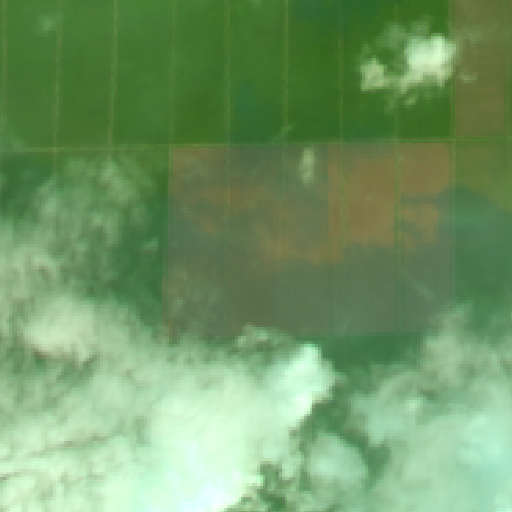

Cloud cover fraction: 0.0


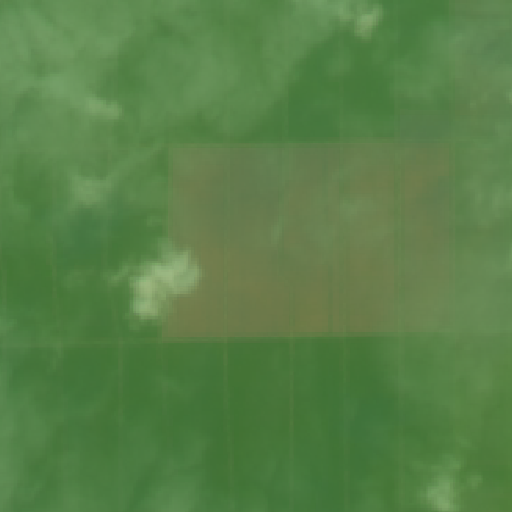

Cloud cover fraction: 0.0047454833984375


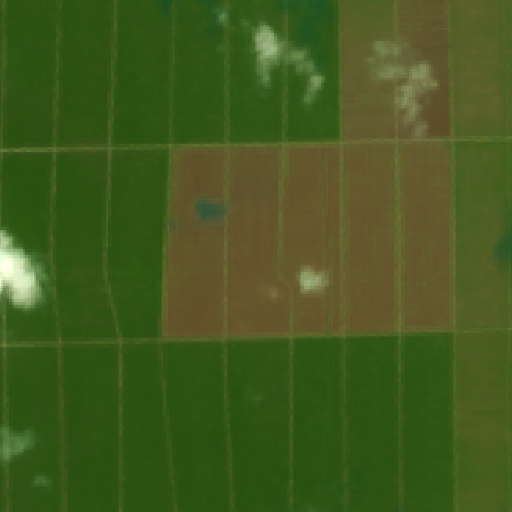

Cloud cover fraction: 1.0


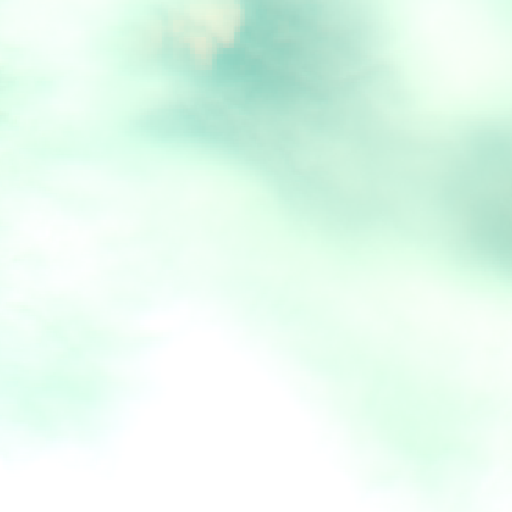

Cloud cover fraction: 1.0


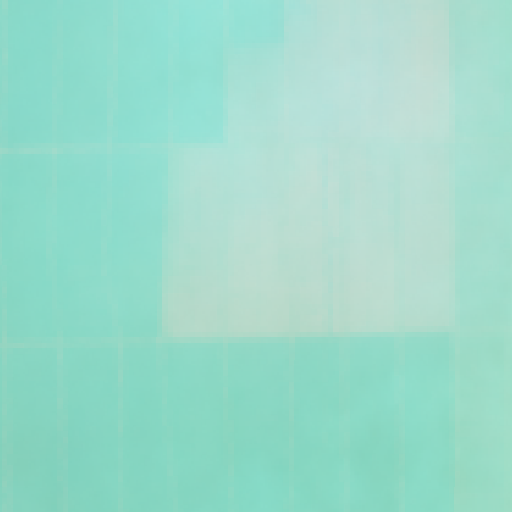

Cloud cover fraction: 0.09877777099609375


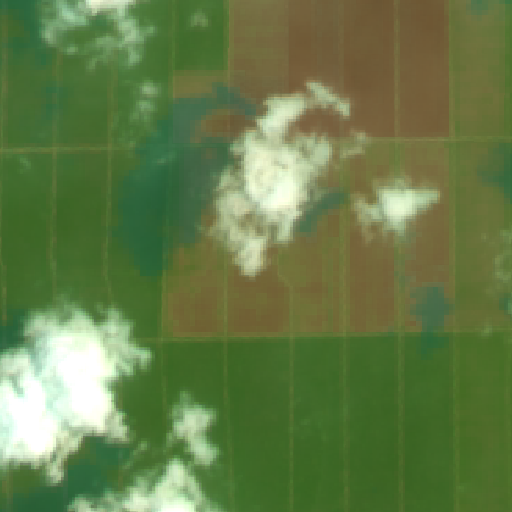

Cloud cover fraction: 0.20326614379882812


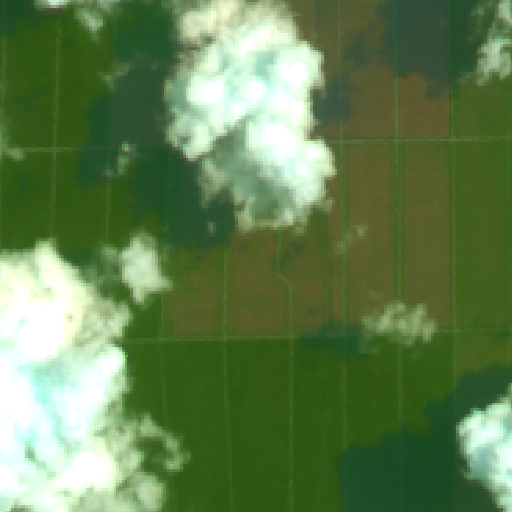

Cloud cover fraction: 0.00237274169921875


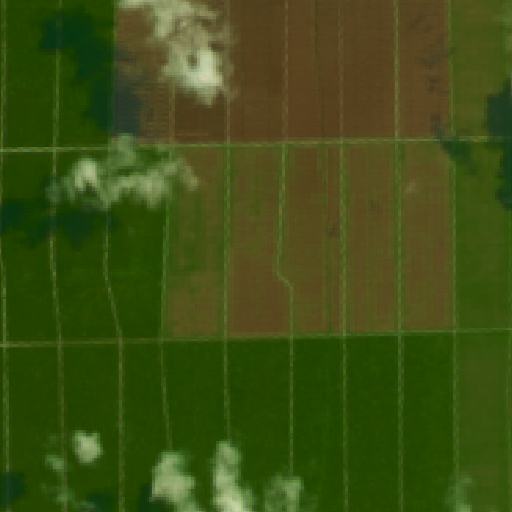

Cloud cover fraction: 0.0


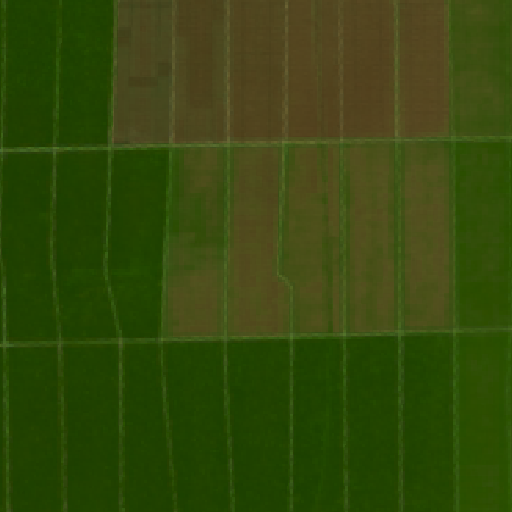

Cloud cover fraction: 0.0


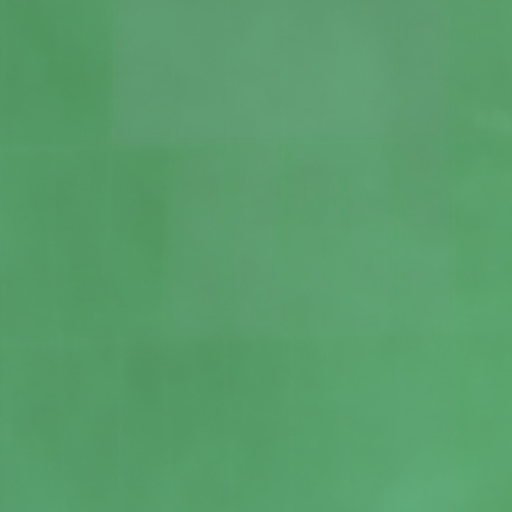

Cloud cover fraction: 0.0


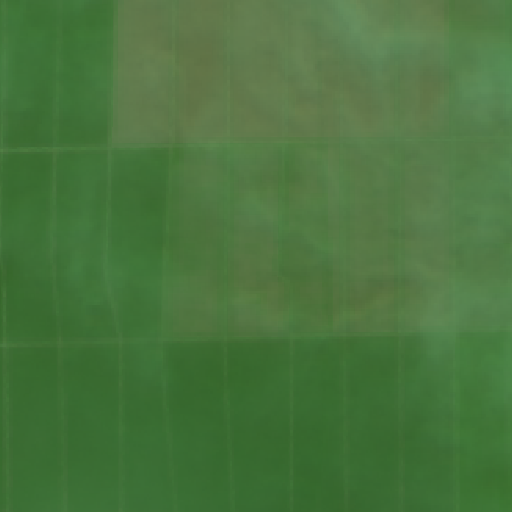

Cloud cover fraction: 0.0


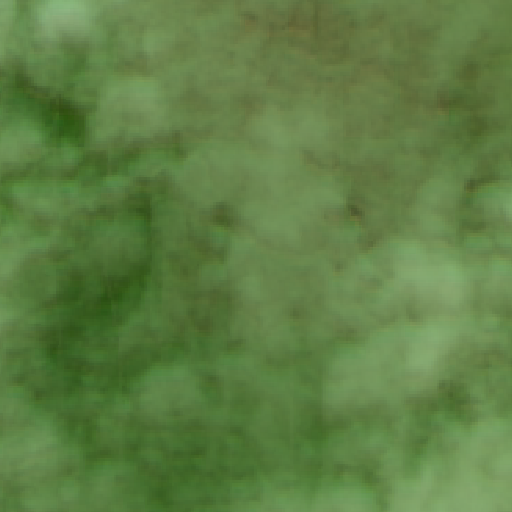

1.5 100.775 2014-01-01 2014-06-30
Cloud cover fraction: 0.28258514404296875


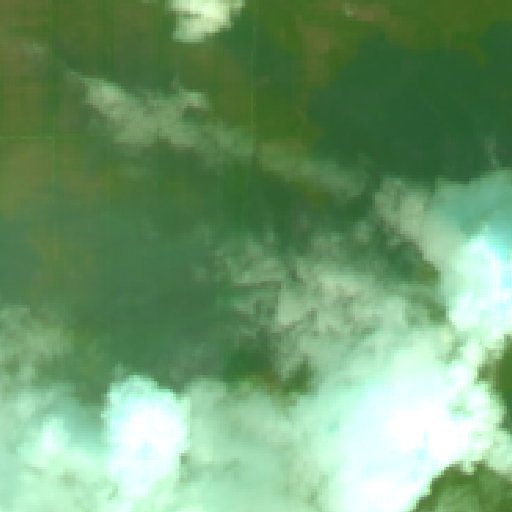

Cloud cover fraction: 0.0


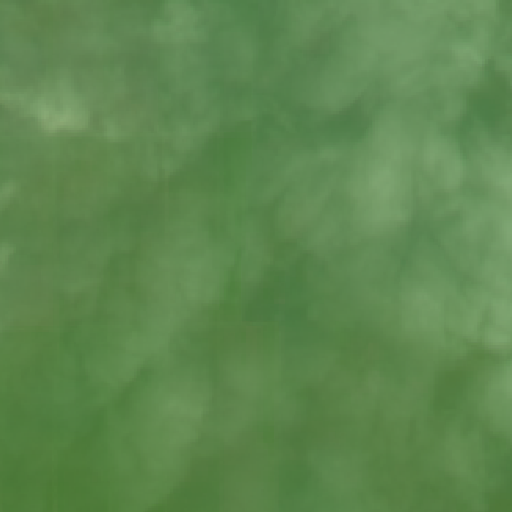

Cloud cover fraction: 0.10490036010742188


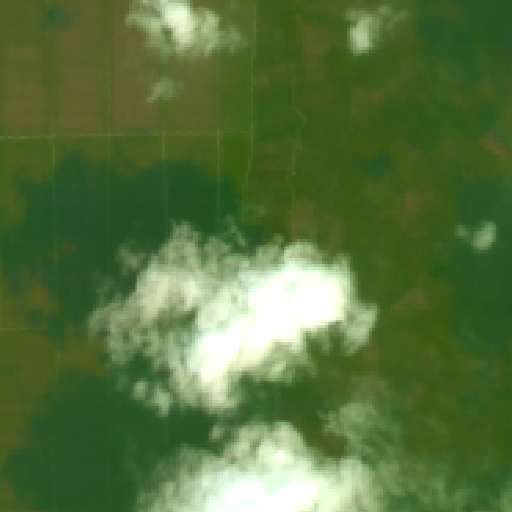

Cloud cover fraction: 1.0


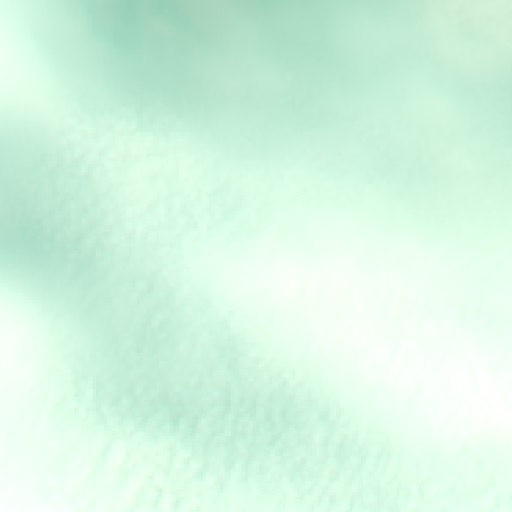

Cloud cover fraction: 1.0


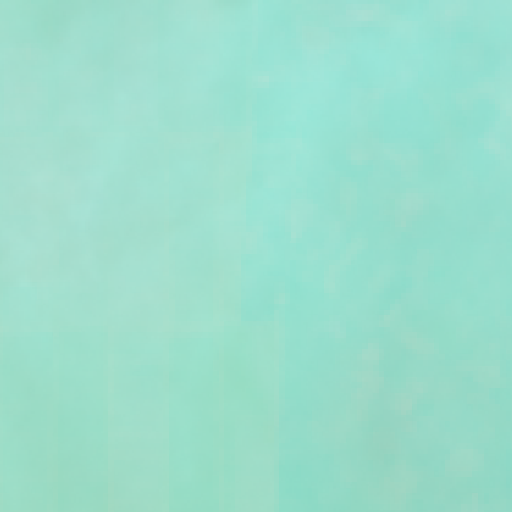

Cloud cover fraction: 0.02484130859375


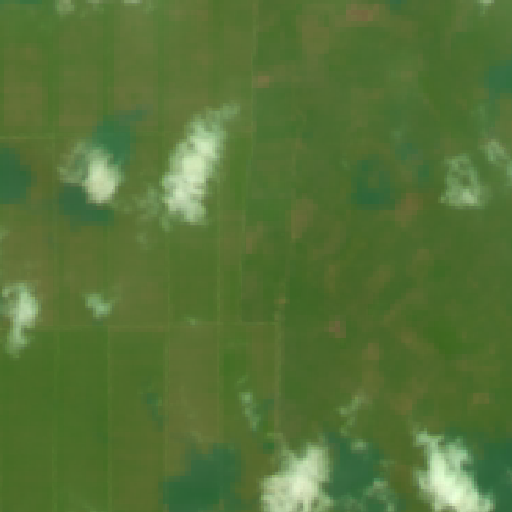

Cloud cover fraction: 0.1746826171875


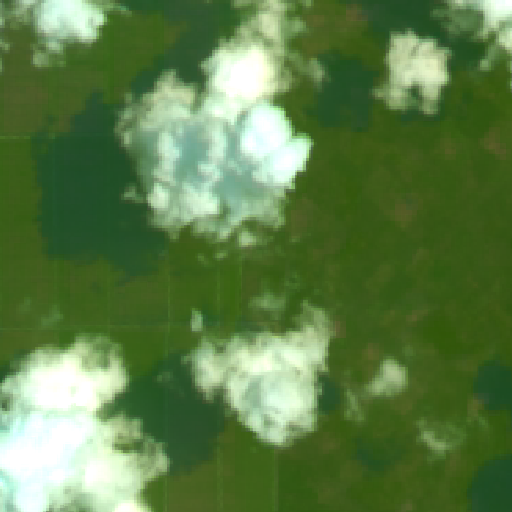

Cloud cover fraction: 0.08724212646484375


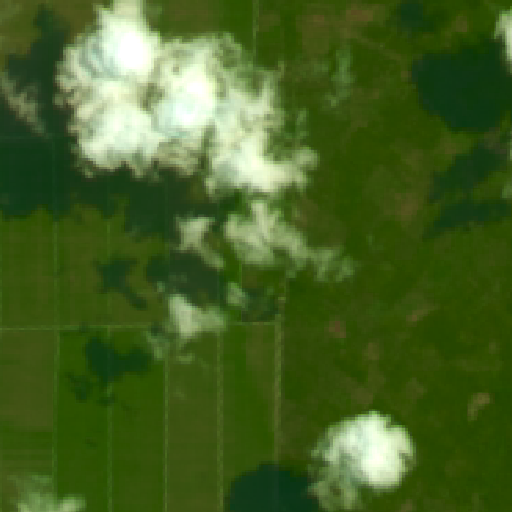

Cloud cover fraction: 1.9073486328125e-05


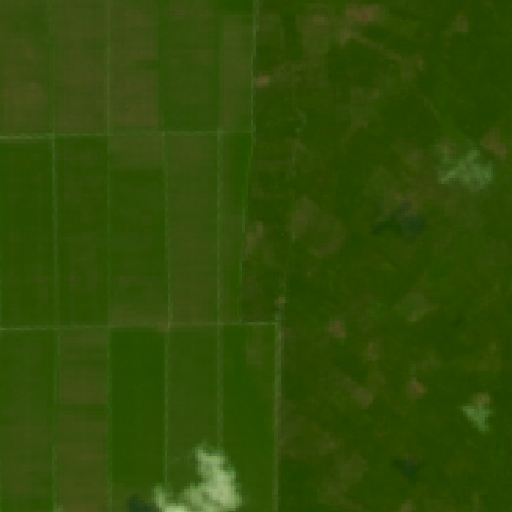

Cloud cover fraction: 0.0


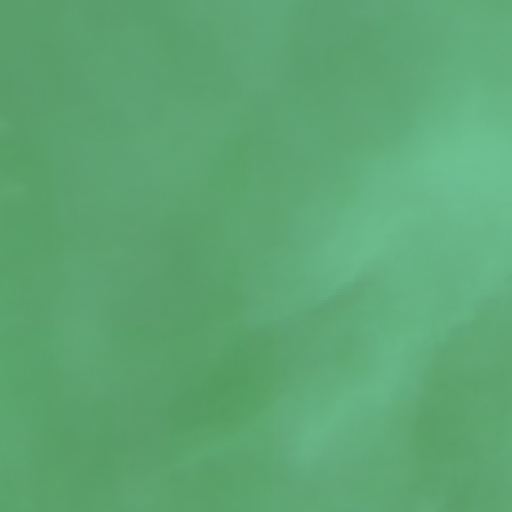

Cloud cover fraction: 0.0


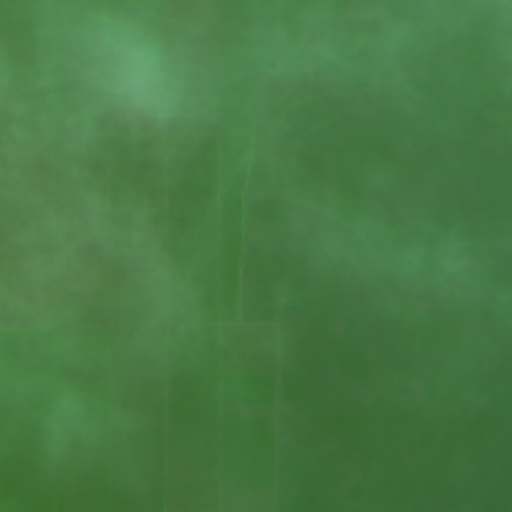

Cloud cover fraction: 0.0


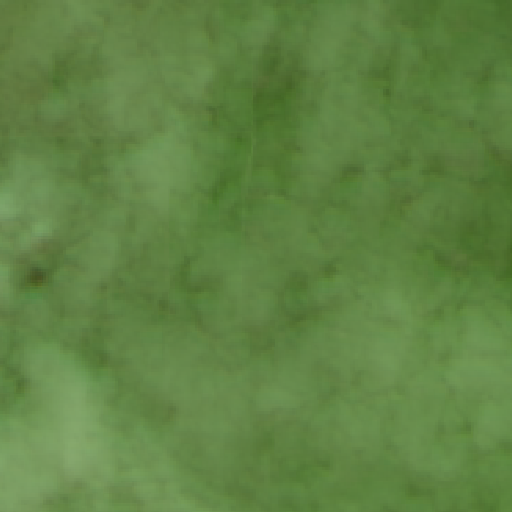

1.5 100.725 2014-01-01 2014-06-30
Cloud cover fraction: 0.2940788269042969


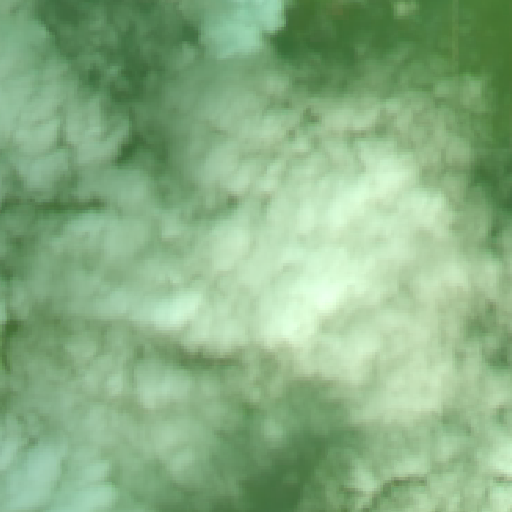

Cloud cover fraction: 0.0


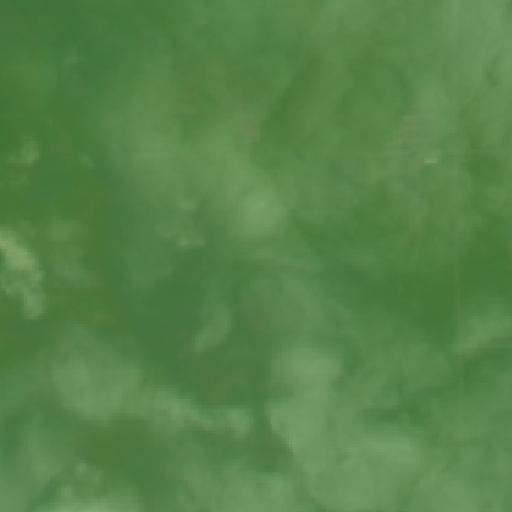

Cloud cover fraction: 0.04689788818359375


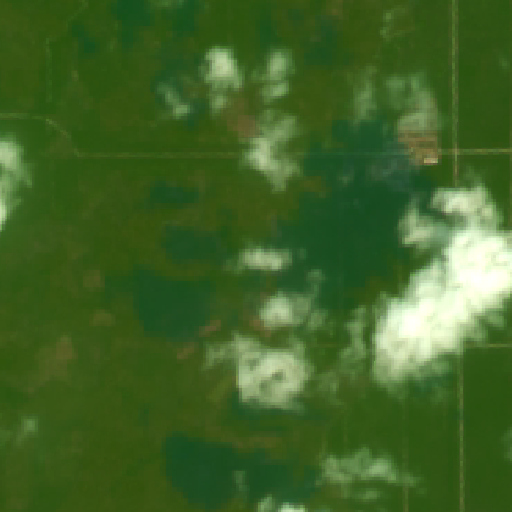

Cloud cover fraction: 0.9779815673828125


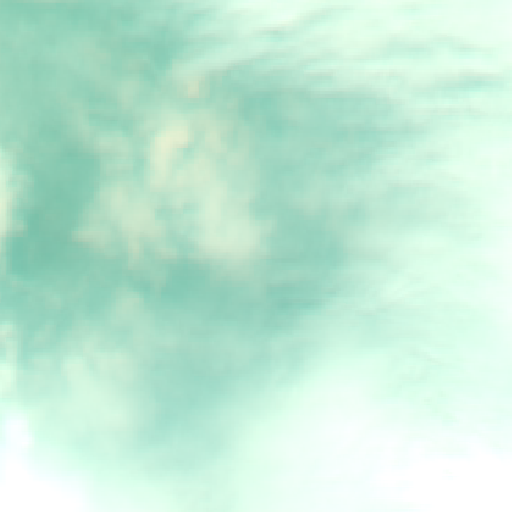

Cloud cover fraction: 0.9414939880371094


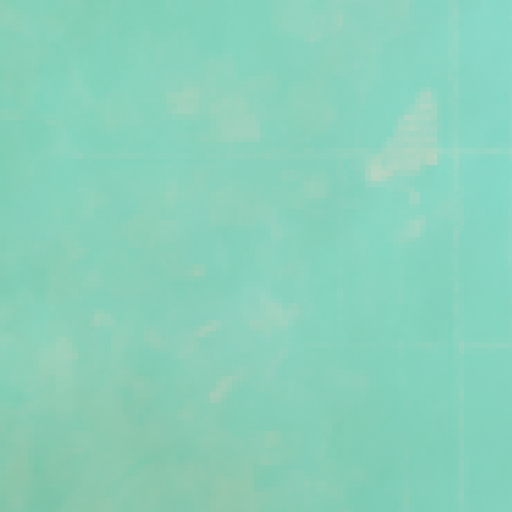

Cloud cover fraction: 0.0980682373046875


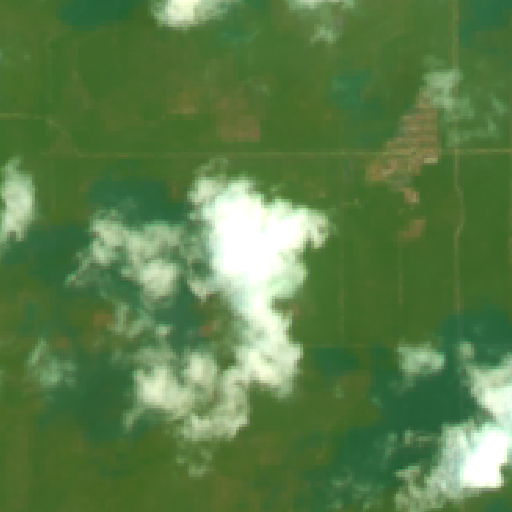

Cloud cover fraction: 0.17238998413085938


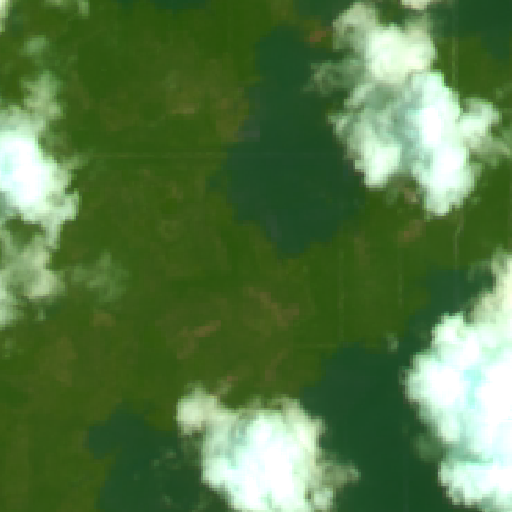

Cloud cover fraction: 0.011669158935546875


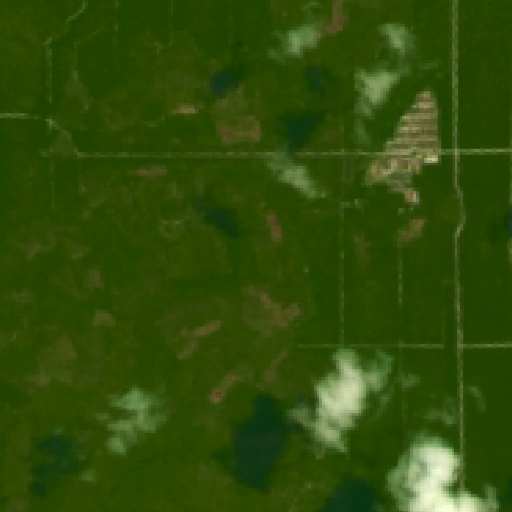

Cloud cover fraction: 0.008296966552734375


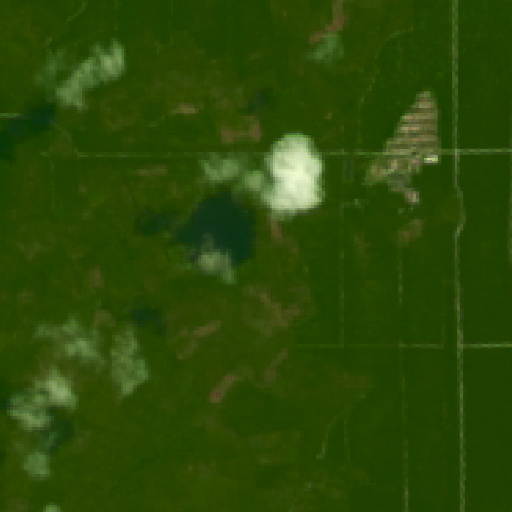

Cloud cover fraction: 0.0


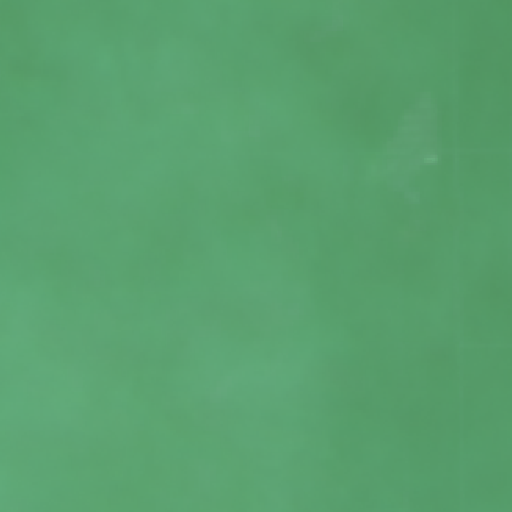

Cloud cover fraction: 0.0


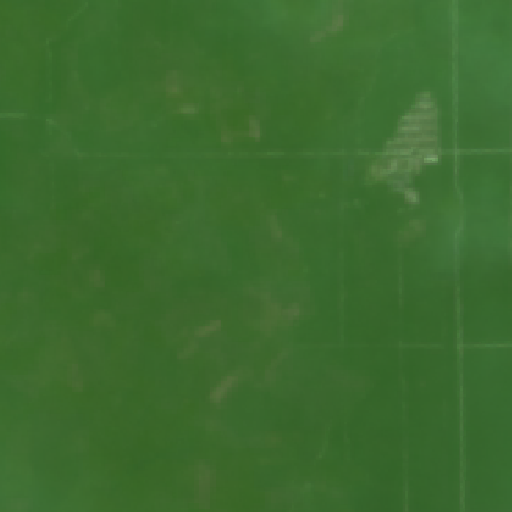

Cloud cover fraction: 0.0


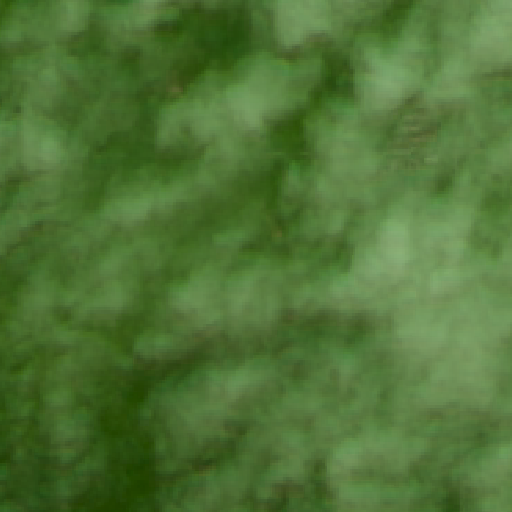

1.525 100.75 2014-01-01 2014-06-30
Cloud cover fraction: 0.6282119750976562


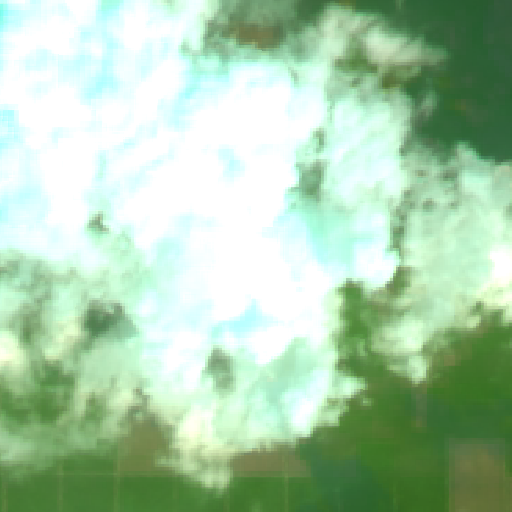

Cloud cover fraction: 0.0


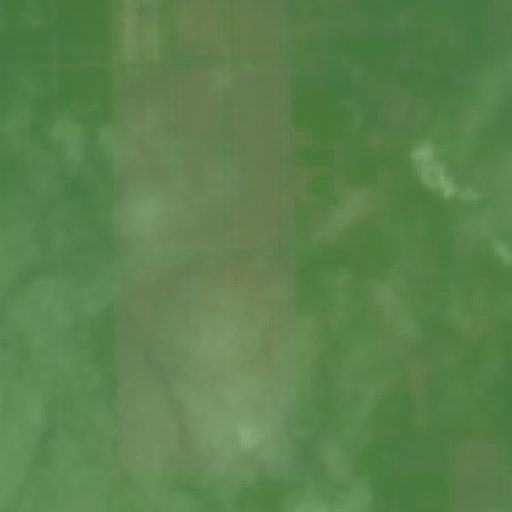

Cloud cover fraction: 0.02649688720703125


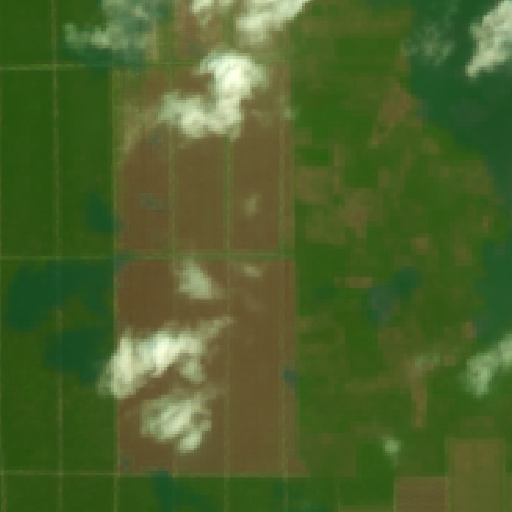

Cloud cover fraction: 0.9136810302734375


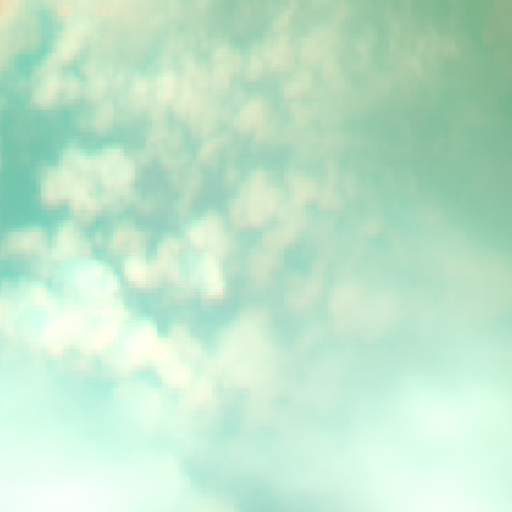

Cloud cover fraction: 1.0


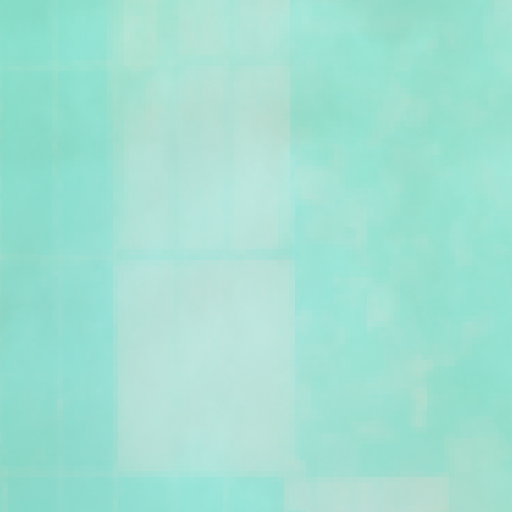

Cloud cover fraction: 0.01380157470703125


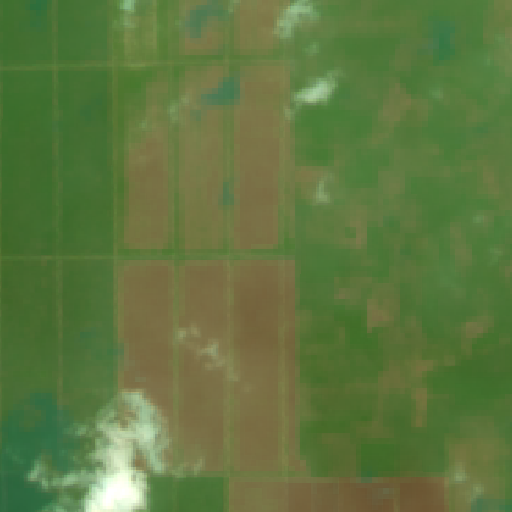

Cloud cover fraction: 0.21759796142578125


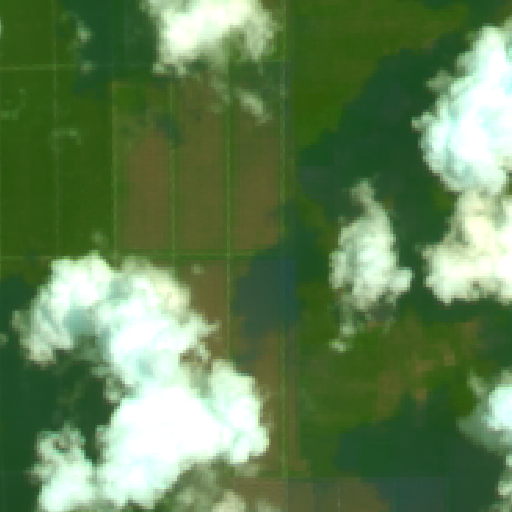

Cloud cover fraction: 0.002223968505859375


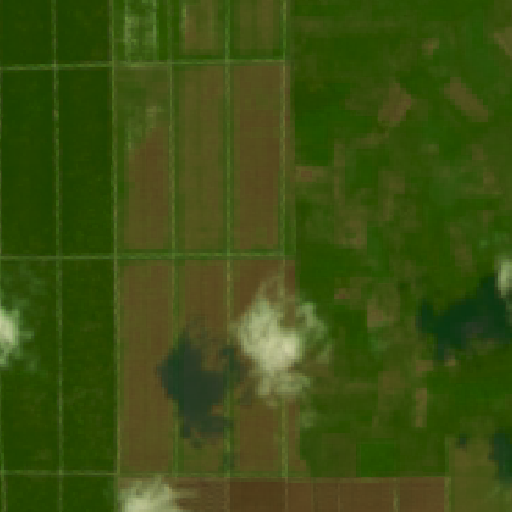

Cloud cover fraction: 0.0


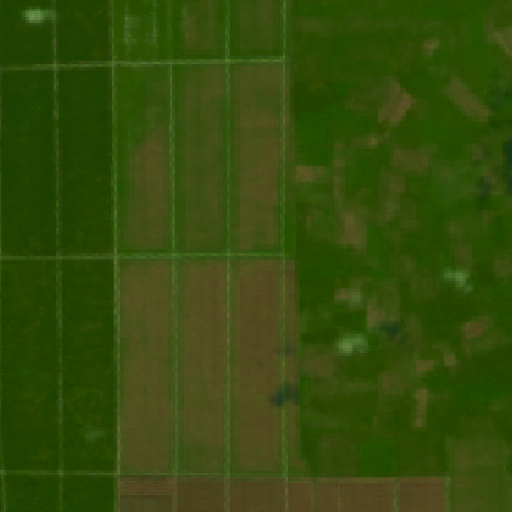

Cloud cover fraction: 0.0


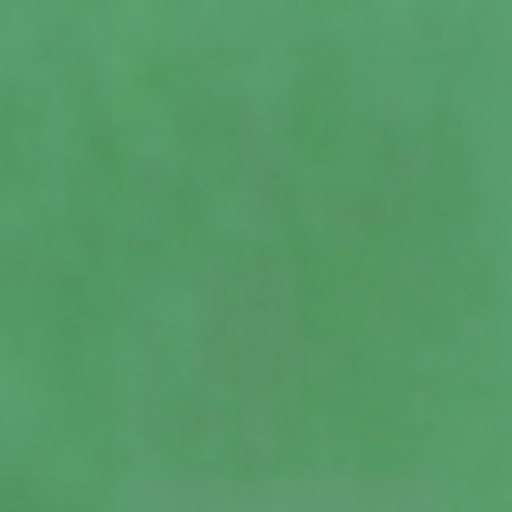

Cloud cover fraction: 0.0


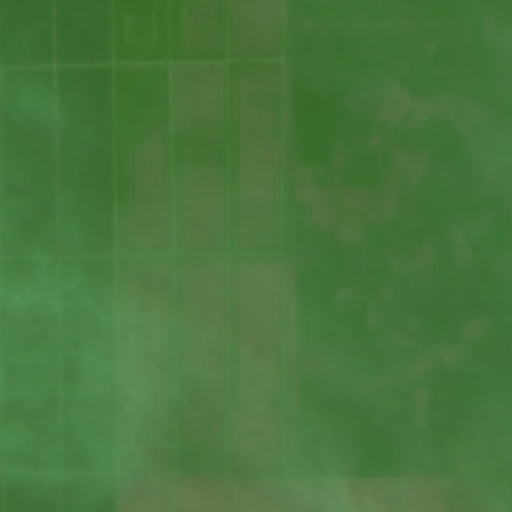

Cloud cover fraction: 0.0


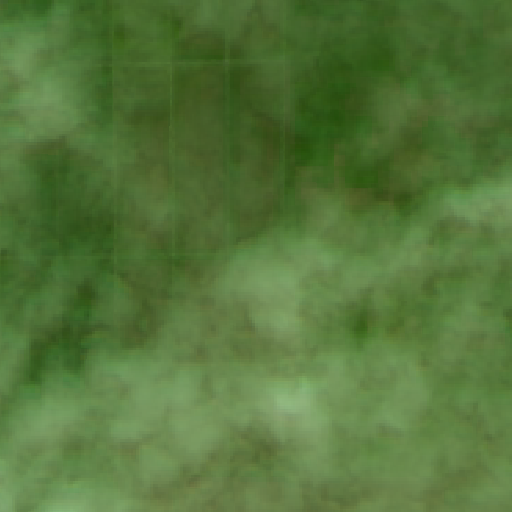

1.475 100.75 2014-01-01 2014-06-30
Cloud cover fraction: 0.4307975769042969


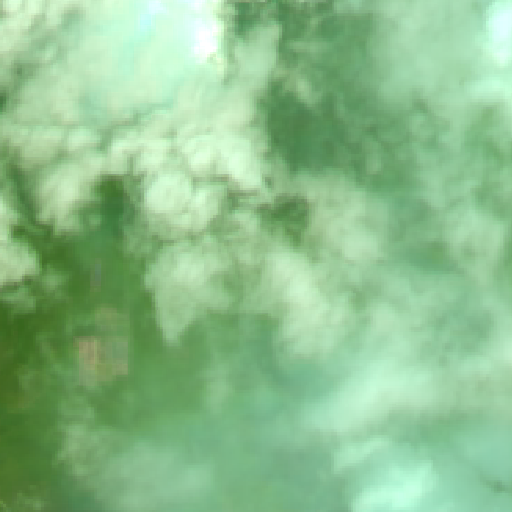

Cloud cover fraction: 0.0


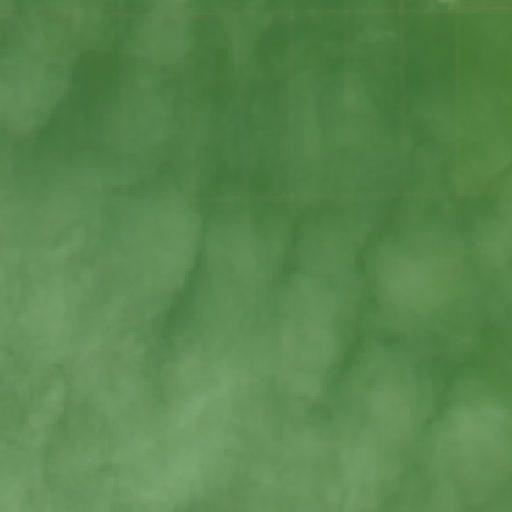

Cloud cover fraction: 0.000141143798828125


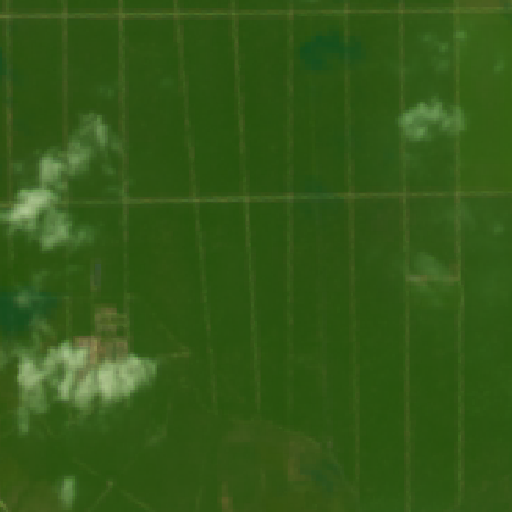

Cloud cover fraction: 1.0


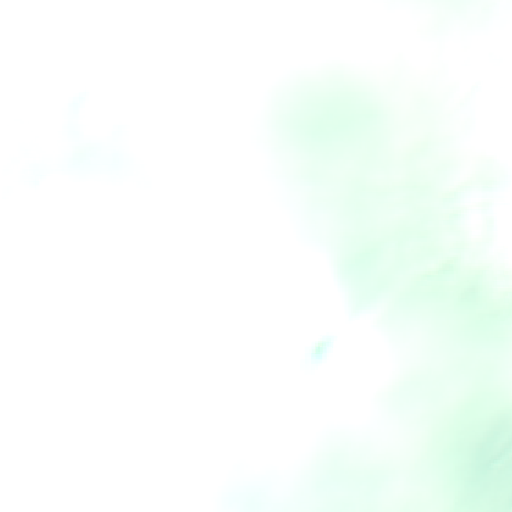

Cloud cover fraction: 0.7977027893066406


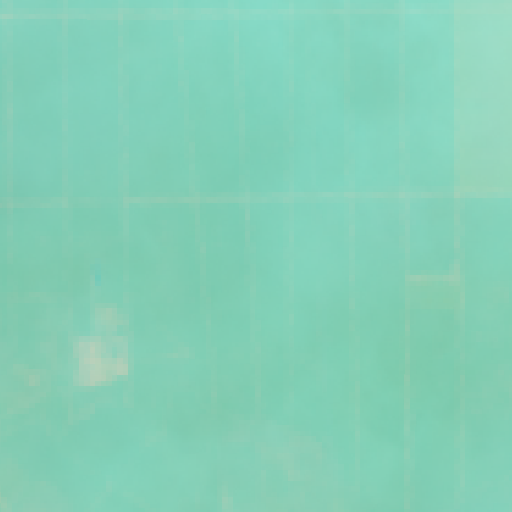

Cloud cover fraction: 0.11748886108398438


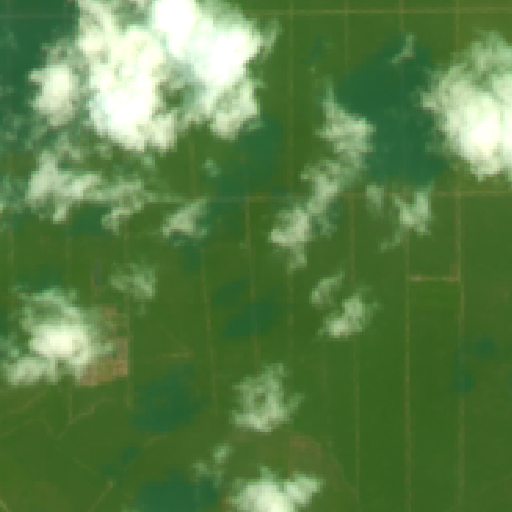

Cloud cover fraction: 0.214935302734375


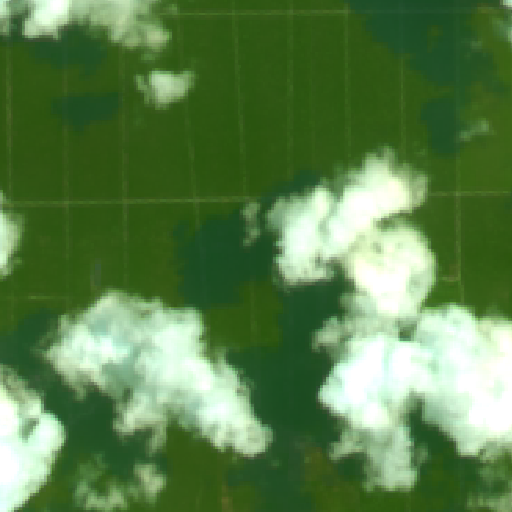

Cloud cover fraction: 0.07149887084960938


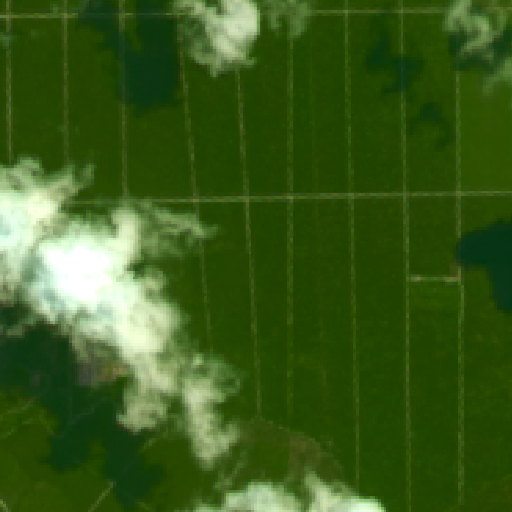

Cloud cover fraction: 0.0


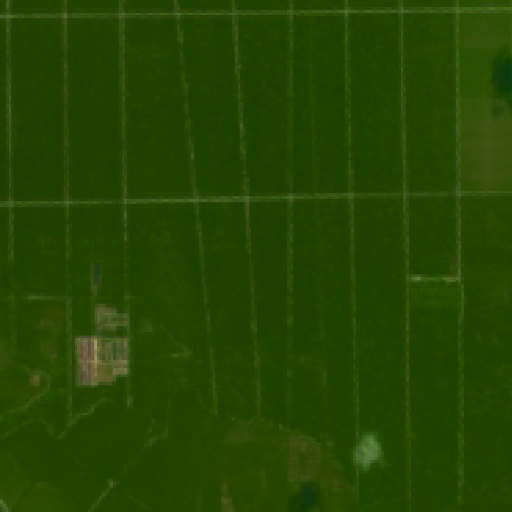

Cloud cover fraction: 0.0


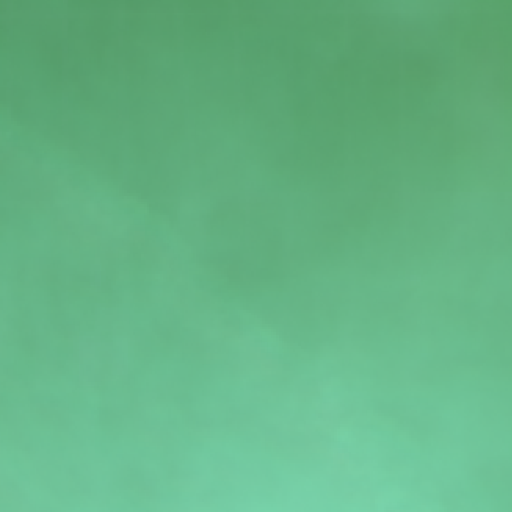

Cloud cover fraction: 0.0


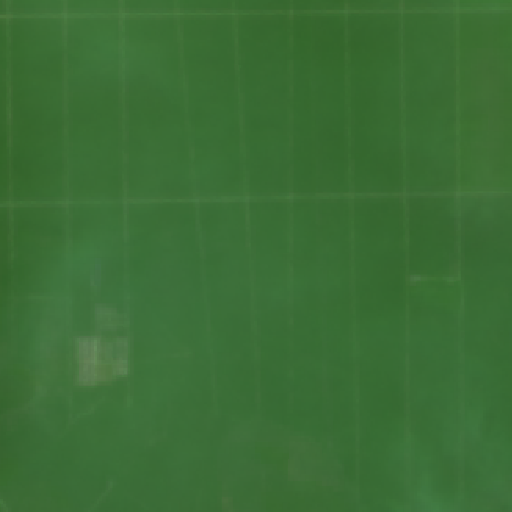

Cloud cover fraction: 0.0


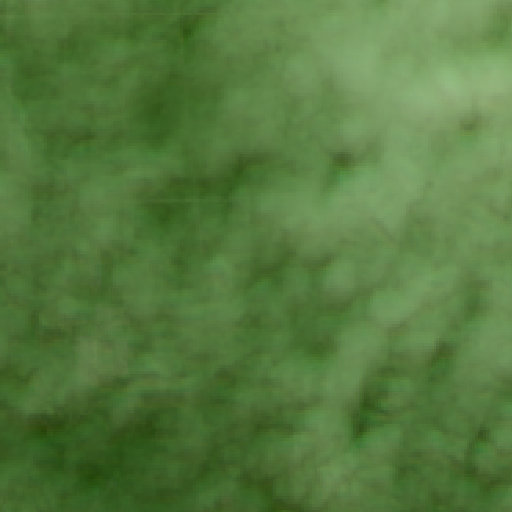

1.525 100.775 2014-01-01 2014-06-30
Cloud cover fraction: 0.6540756225585938


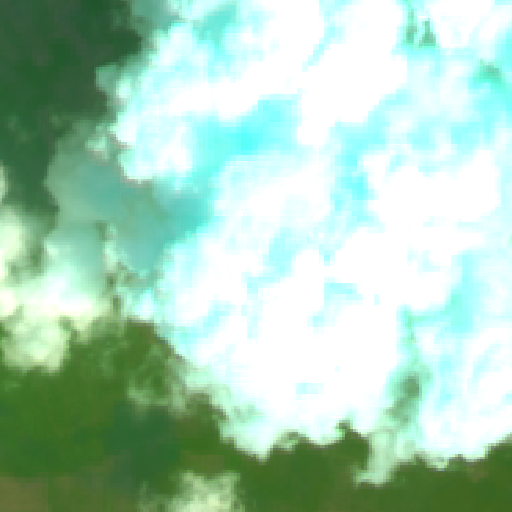

Cloud cover fraction: 0.0


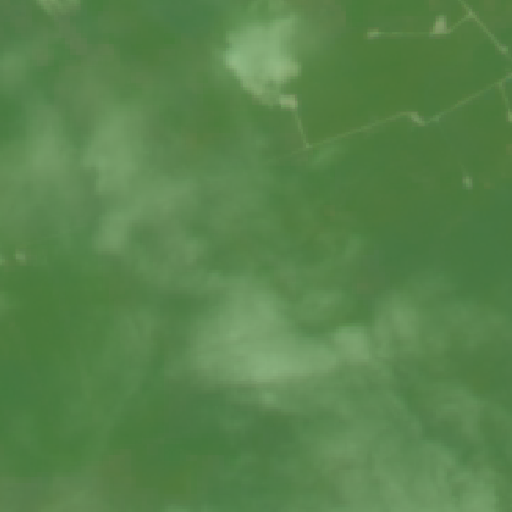

Cloud cover fraction: 0.30340576171875


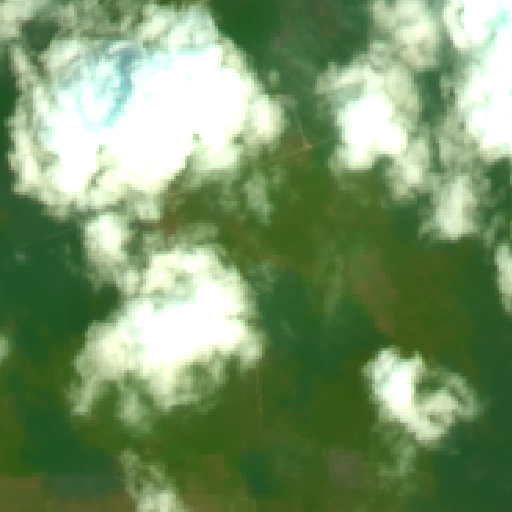

Cloud cover fraction: 0.3585014343261719


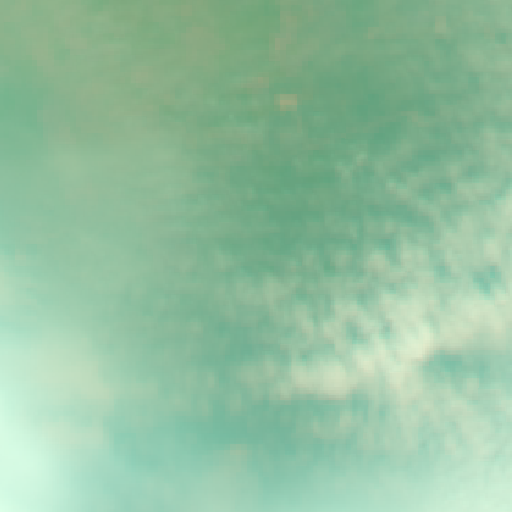

Cloud cover fraction: 1.0


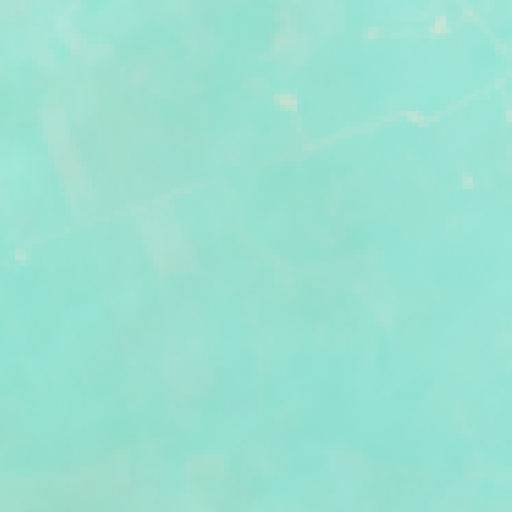

Cloud cover fraction: 0.0083770751953125


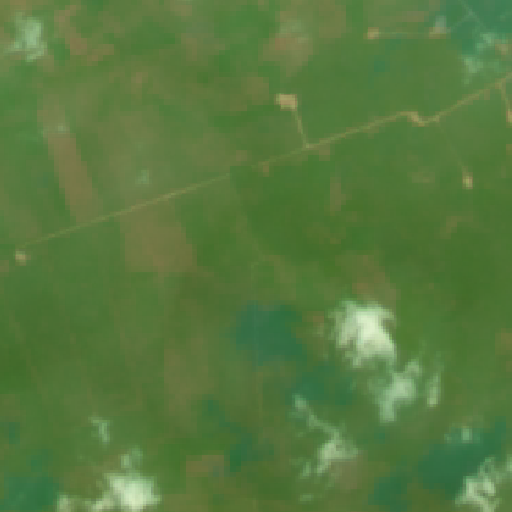

Cloud cover fraction: 0.3647117614746094


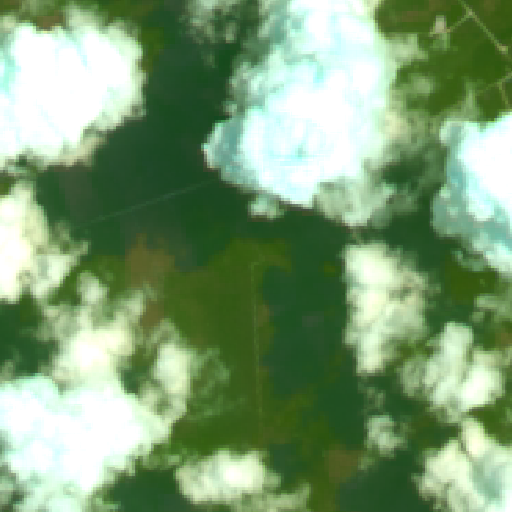

Cloud cover fraction: 0.07184219360351562


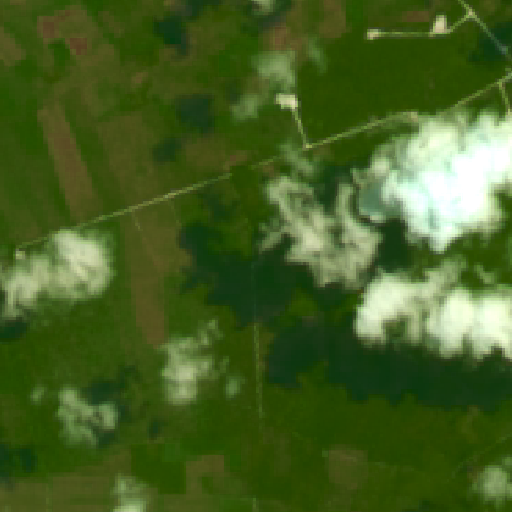

Cloud cover fraction: 0.002475738525390625


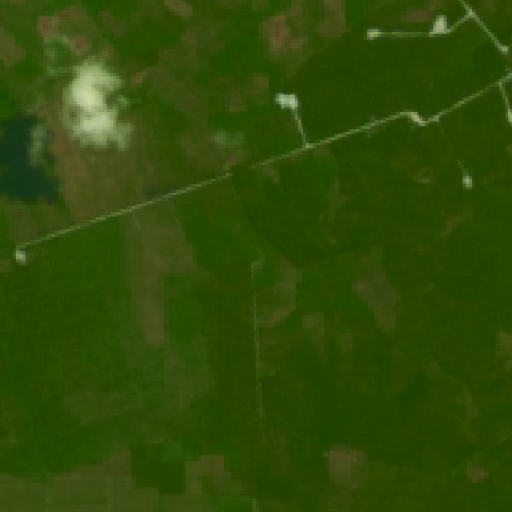

Cloud cover fraction: 0.0


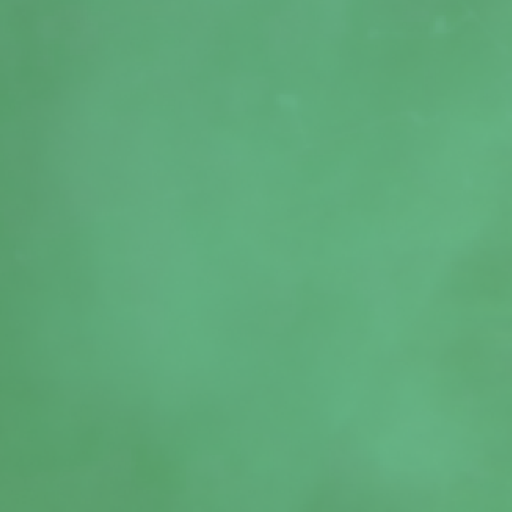

Cloud cover fraction: 0.0


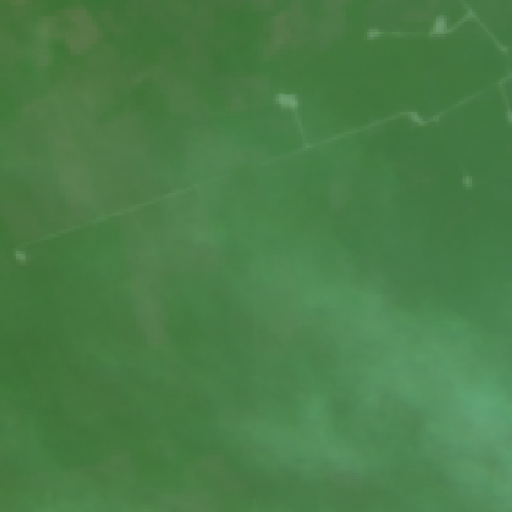

Cloud cover fraction: 0.0


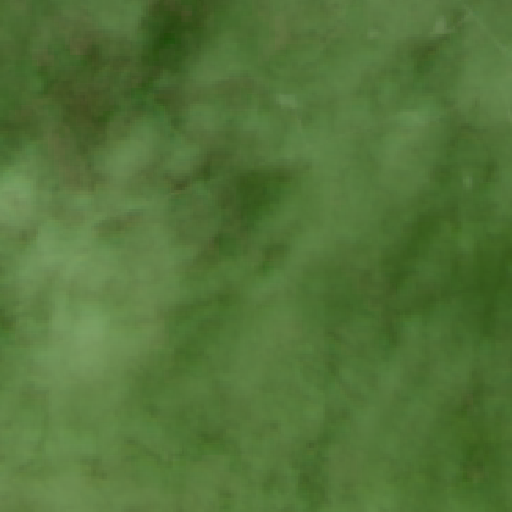

1.475 100.775 2014-01-01 2014-06-30
Cloud cover fraction: 0.3642692565917969


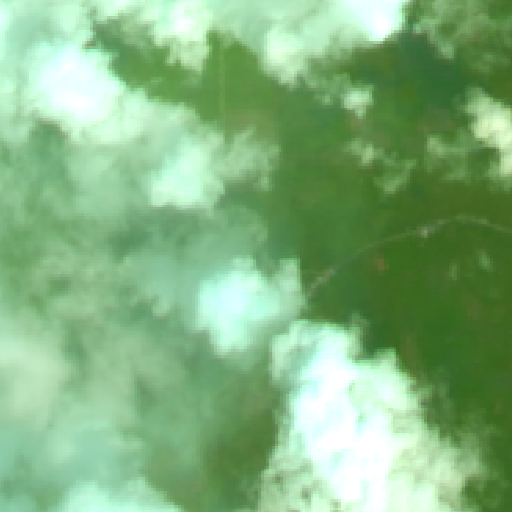

Cloud cover fraction: 0.0


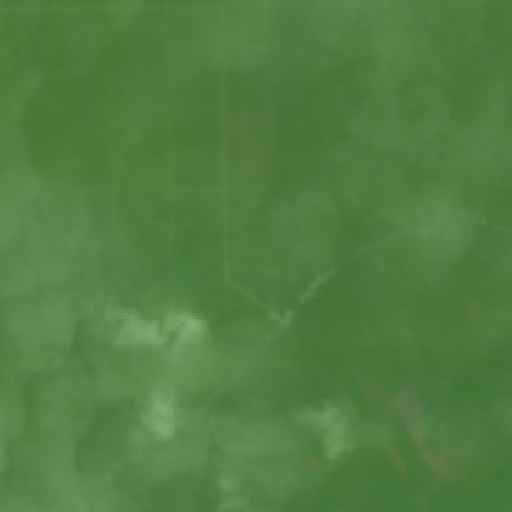

Cloud cover fraction: 0.14236068725585938


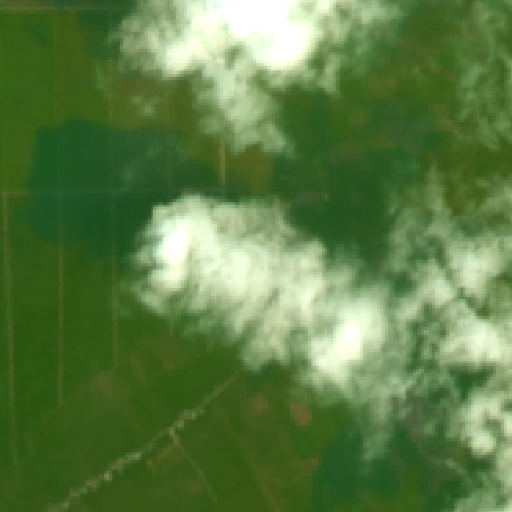

Cloud cover fraction: 1.0


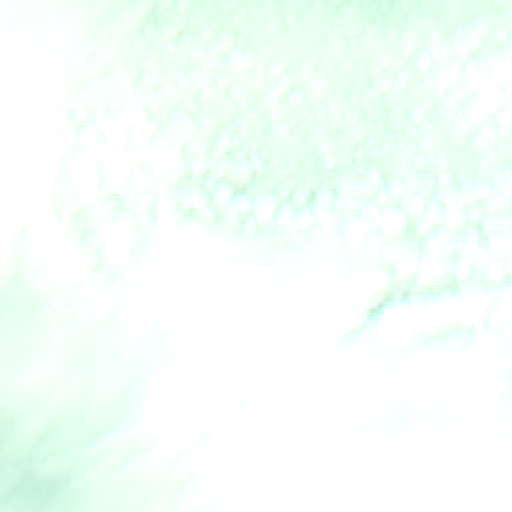

Cloud cover fraction: 0.9940414428710938


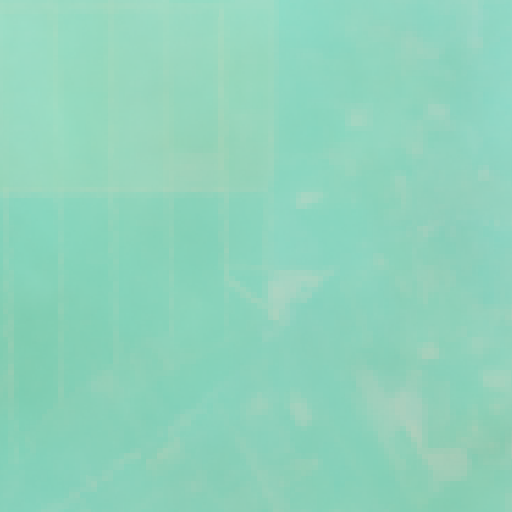

Cloud cover fraction: 0.10037994384765625


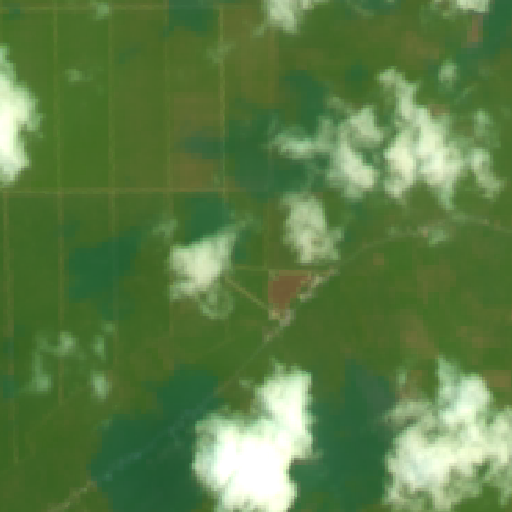

Cloud cover fraction: 0.12464523315429688


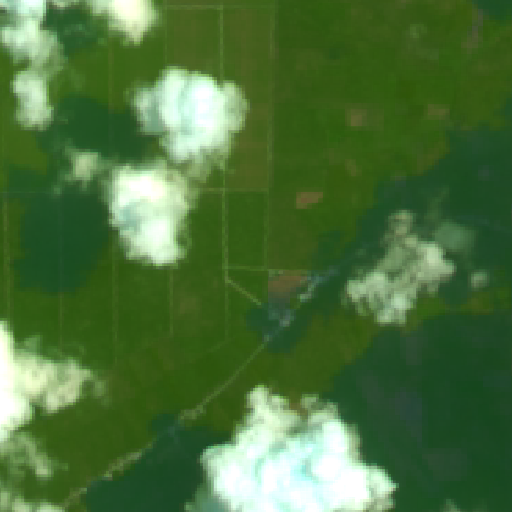

Cloud cover fraction: 0.0137481689453125


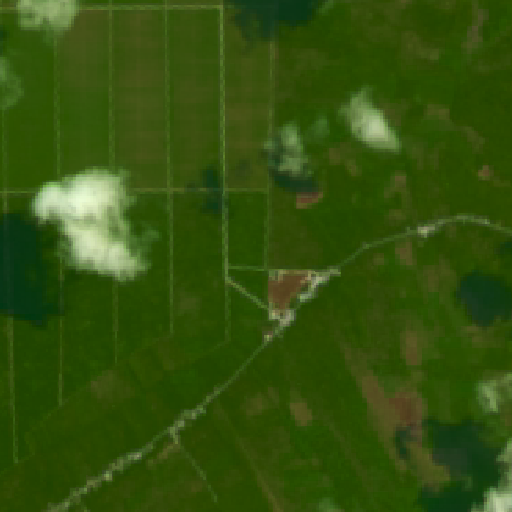

Cloud cover fraction: 0.001506805419921875


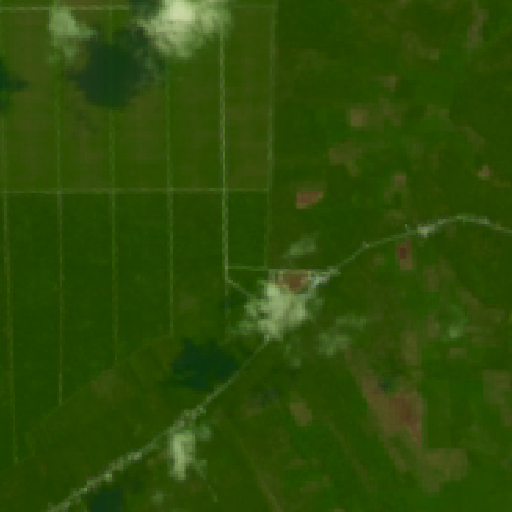

Cloud cover fraction: 0.0


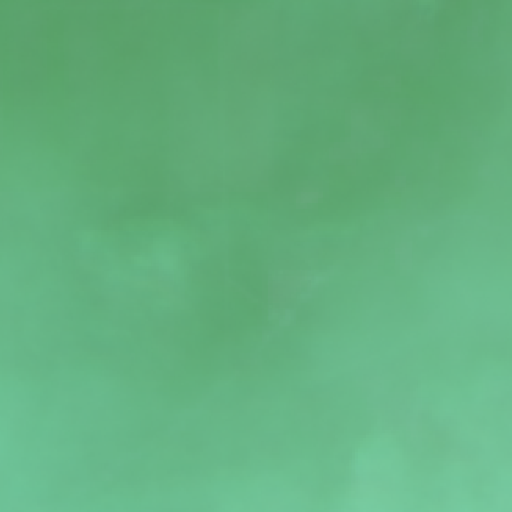

Cloud cover fraction: 0.0


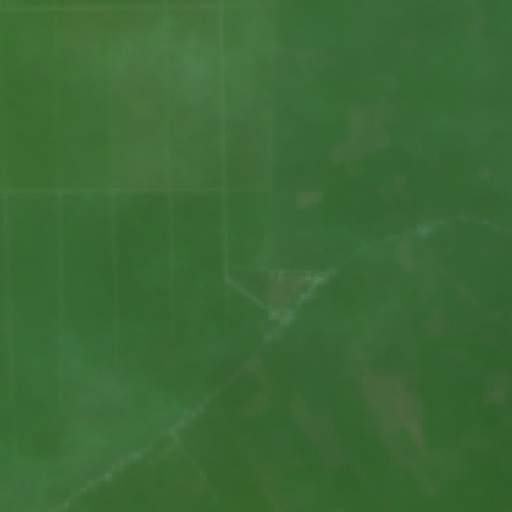

Cloud cover fraction: 0.0


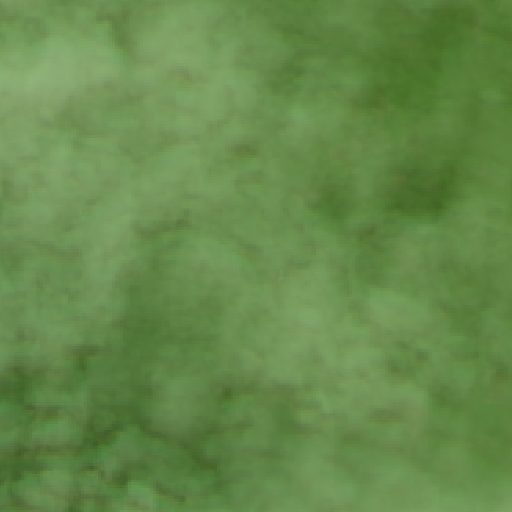

1.525 100.725 2014-01-01 2014-06-30
Cloud cover fraction: 0.16238784790039062


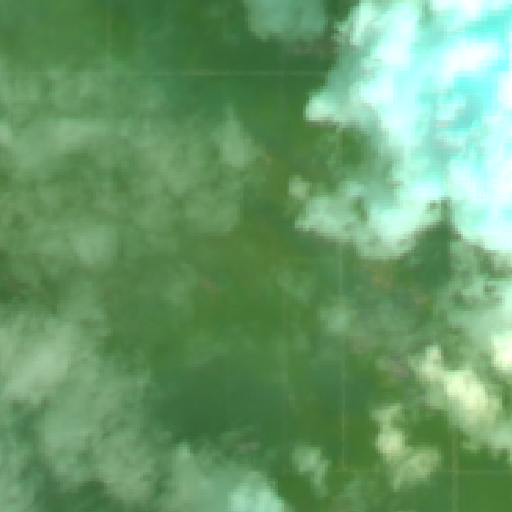

Cloud cover fraction: 0.00341796875


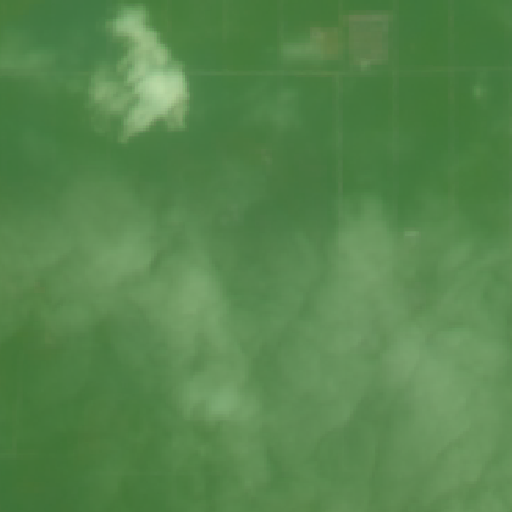

Cloud cover fraction: 0.08108139038085938


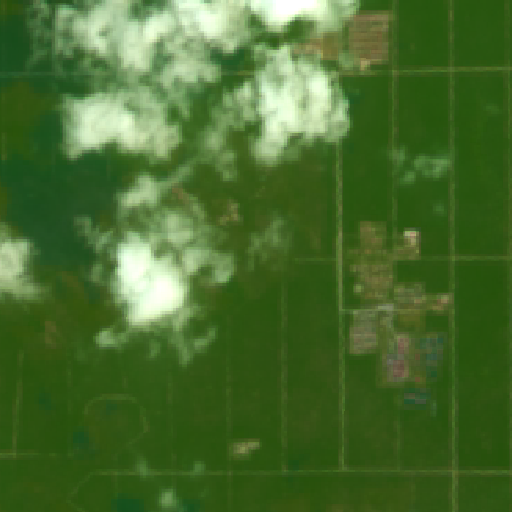

Cloud cover fraction: 0.98724365234375


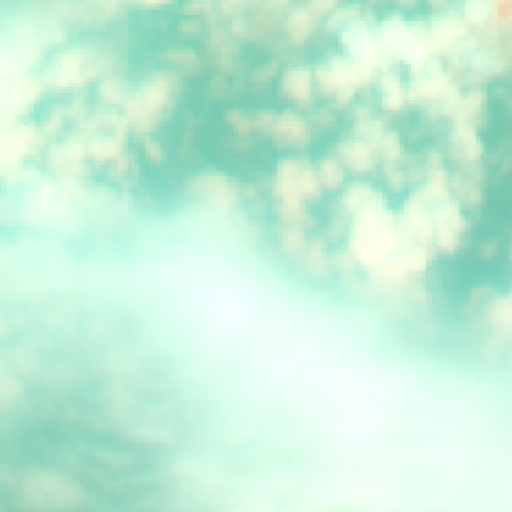

Cloud cover fraction: 0.9999237060546875


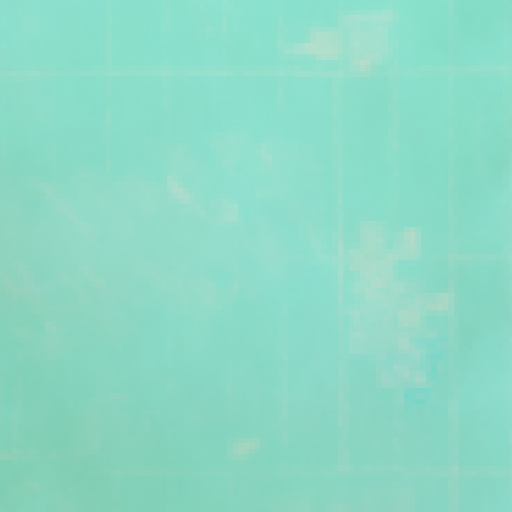

Cloud cover fraction: 0.07074737548828125


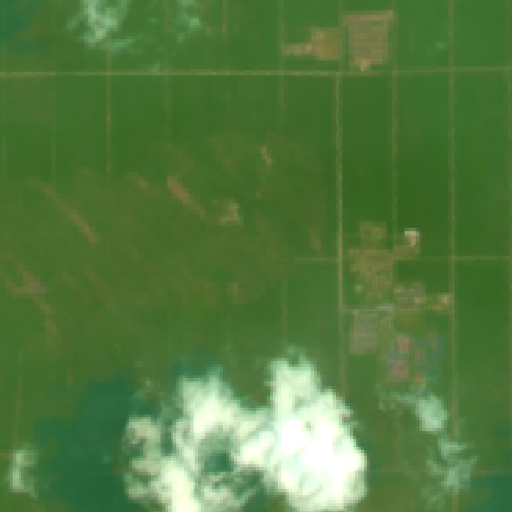

Cloud cover fraction: 0.21326828002929688


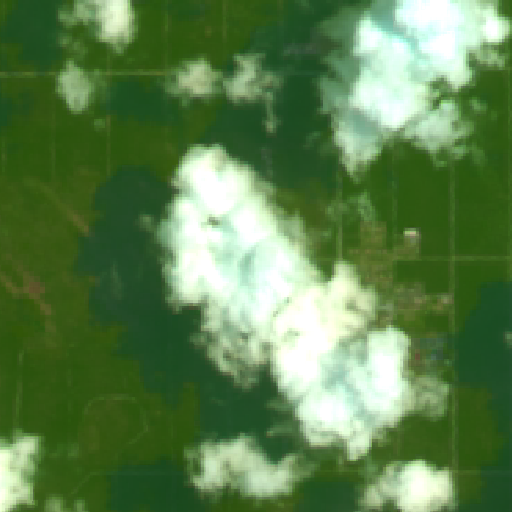

Cloud cover fraction: 0.011928558349609375


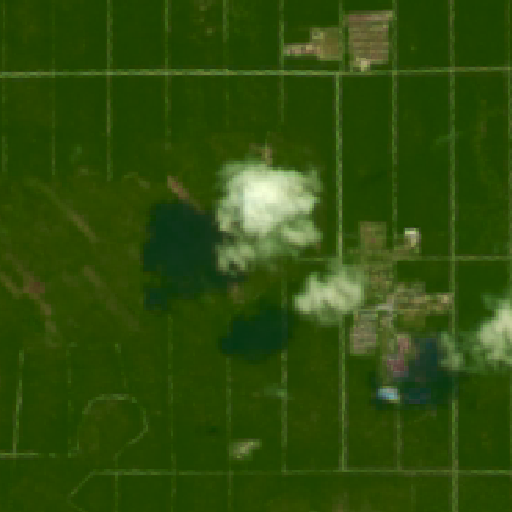

Cloud cover fraction: 0.003597259521484375


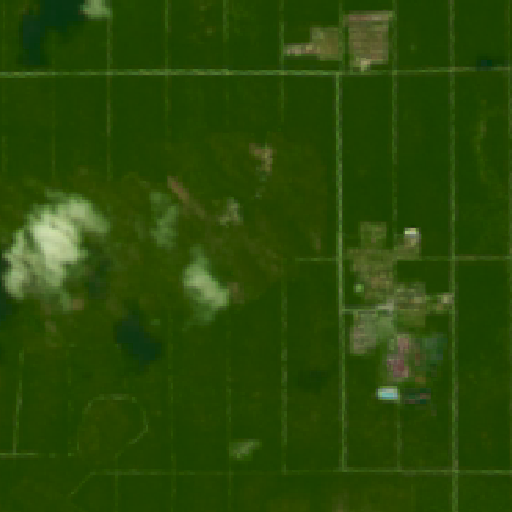

Cloud cover fraction: 0.0


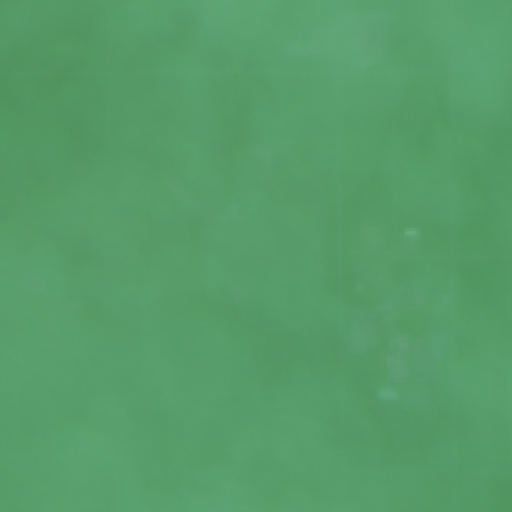

Cloud cover fraction: 0.0


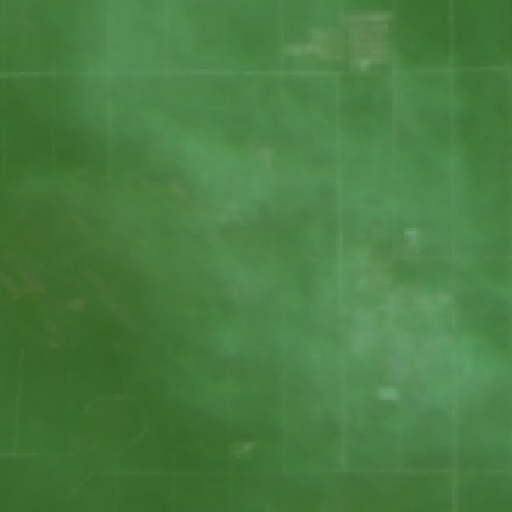

Cloud cover fraction: 0.0


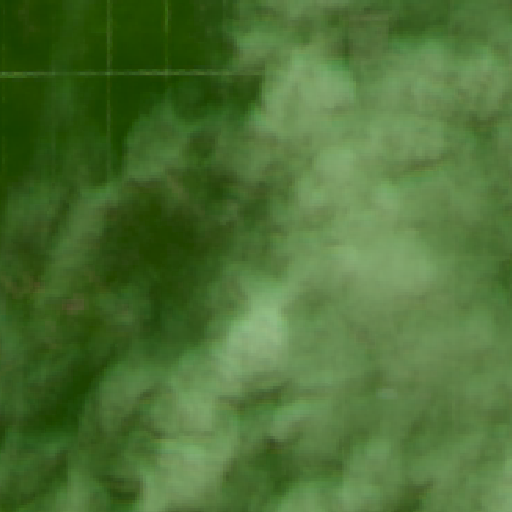

1.475 100.725 2014-01-01 2014-06-30
Cloud cover fraction: 0.2931365966796875


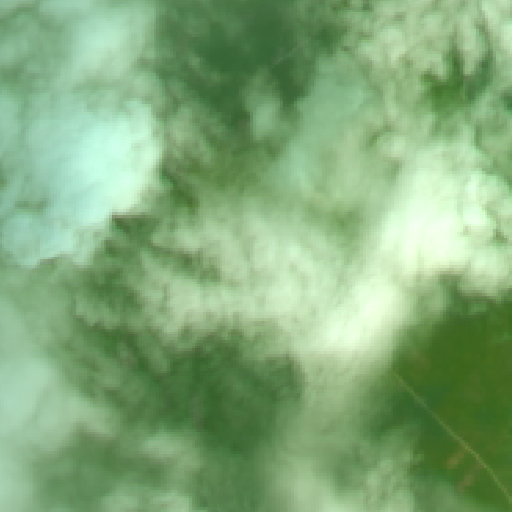

Cloud cover fraction: 0.0


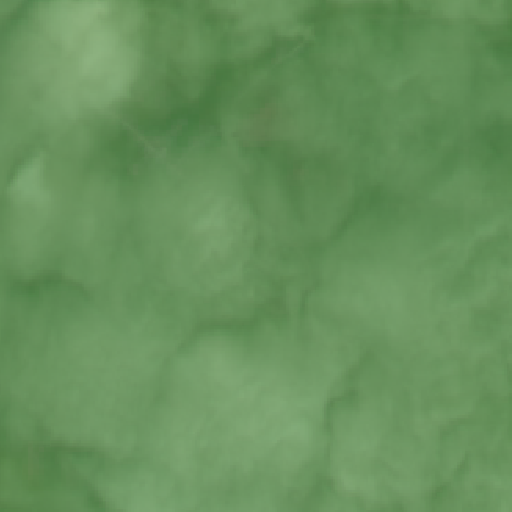

Cloud cover fraction: 0.046535491943359375


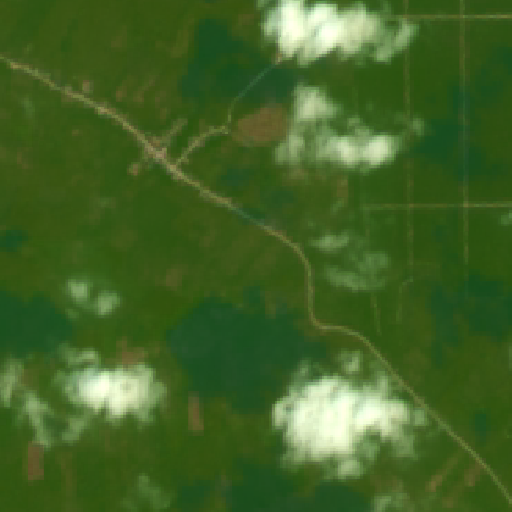

Cloud cover fraction: 1.0


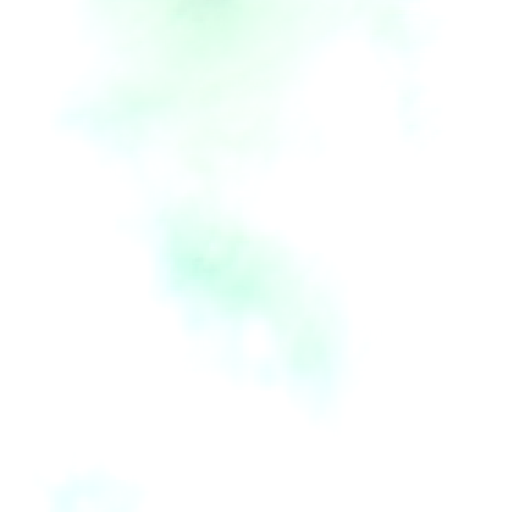

Cloud cover fraction: 0.14442825317382812


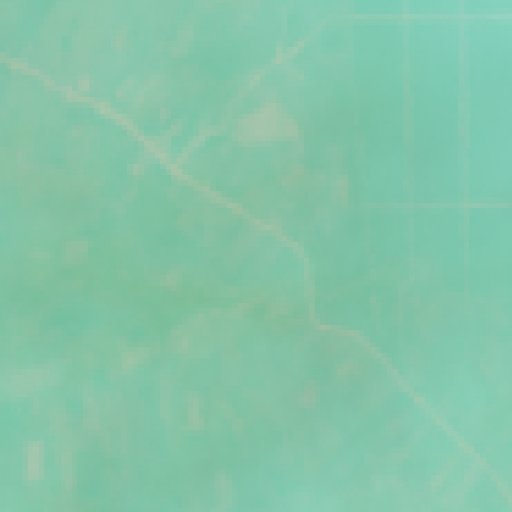

Cloud cover fraction: 0.22092056274414062


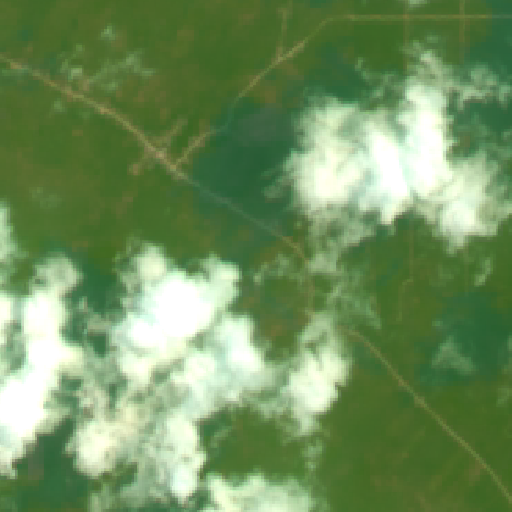

Cloud cover fraction: 0.22883987426757812


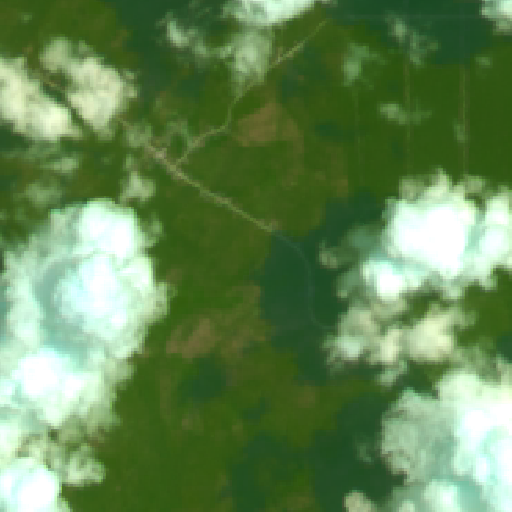

Cloud cover fraction: 0.0743560791015625


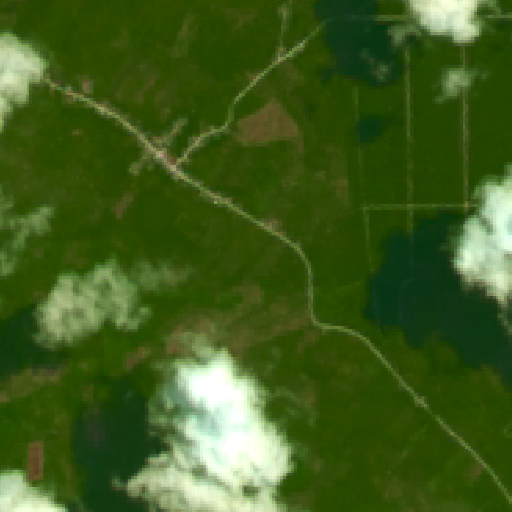

Cloud cover fraction: 0.004459381103515625


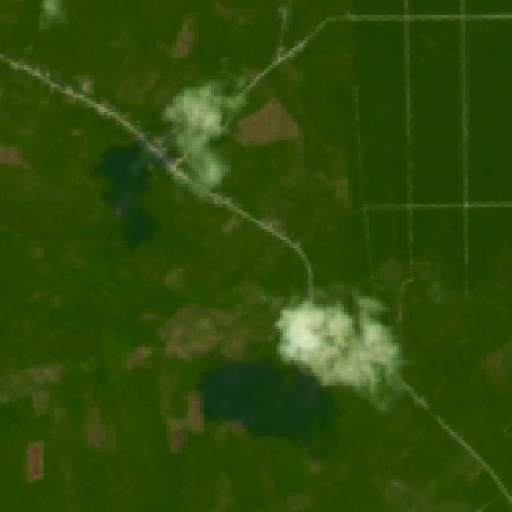

Cloud cover fraction: 0.0


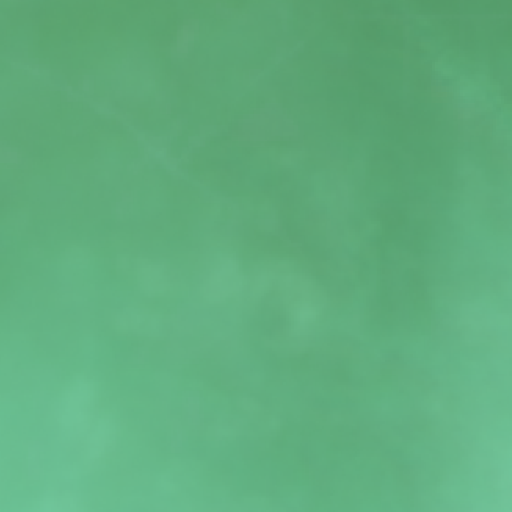

Cloud cover fraction: 0.0


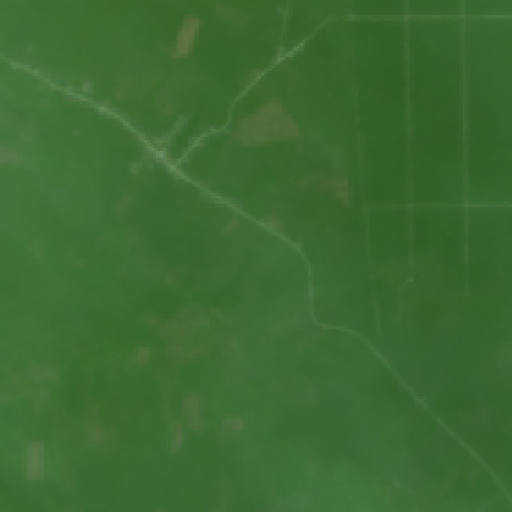

Cloud cover fraction: 0.0


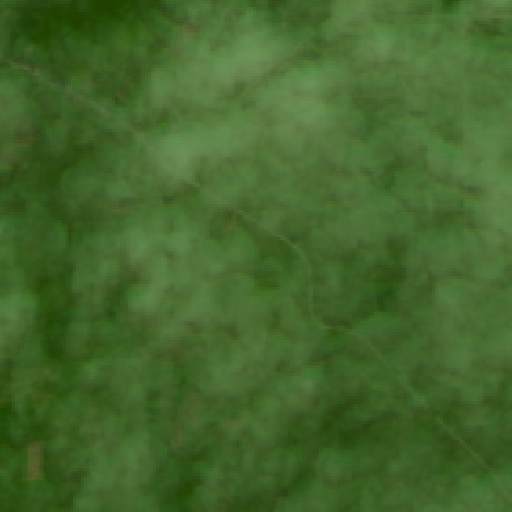

2014-01-01 2014-06-30

The average cloud coverage is: 0.21524627120406536 from 2014-01-01 to 2014-06-30.

1.5 100.75 2014-07-01 2014-12-31
Cloud cover fraction: 0.0


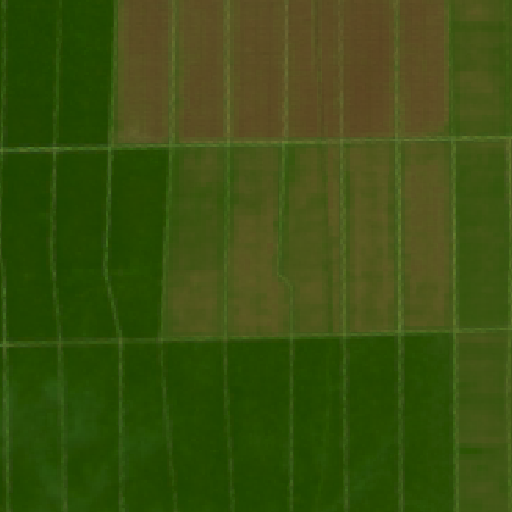

Cloud cover fraction: 0.0


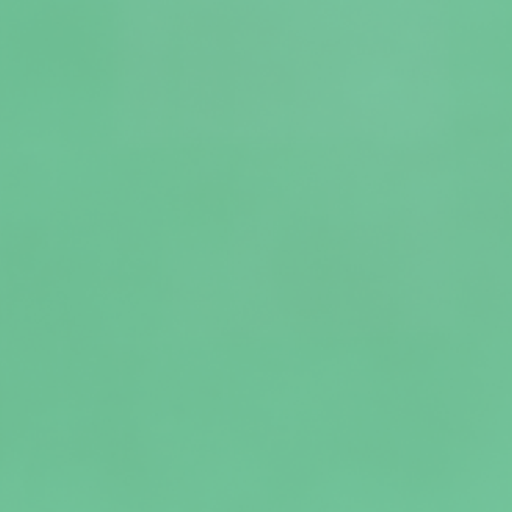

Cloud cover fraction: 0.0


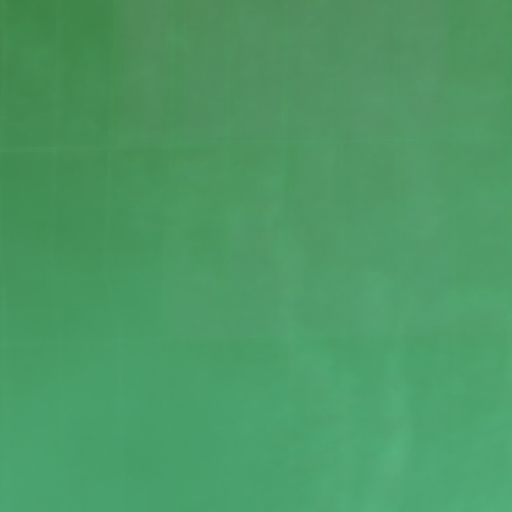

Cloud cover fraction: 0.0


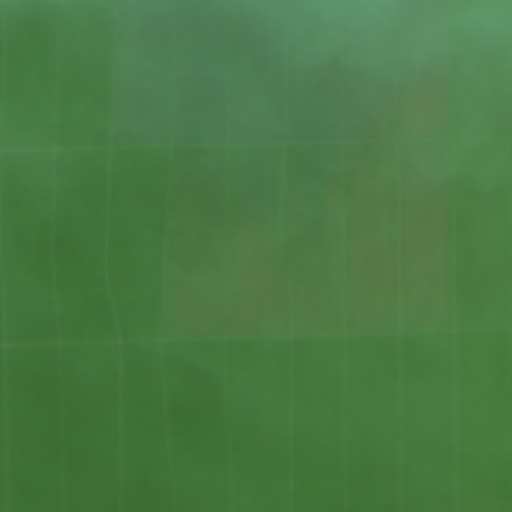

Cloud cover fraction: 0.0


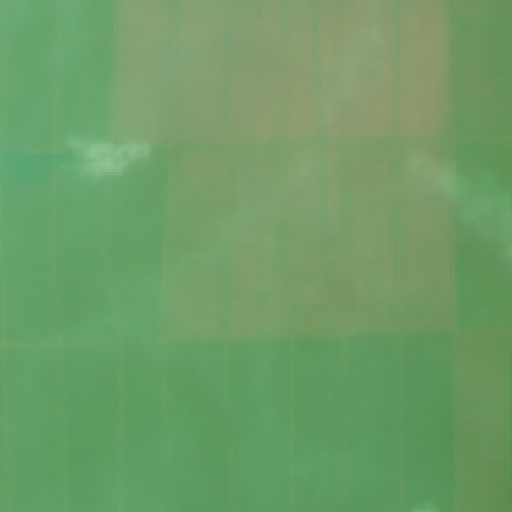

Cloud cover fraction: 0.050357818603515625


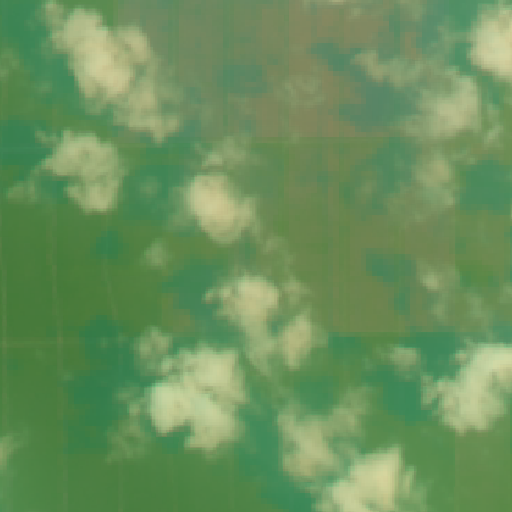

Cloud cover fraction: 0.12553787231445312


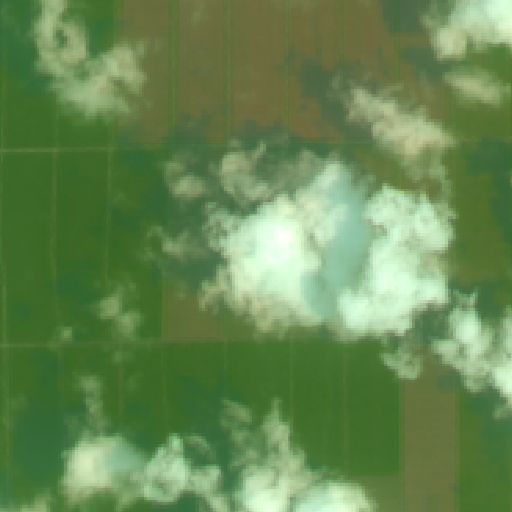

Cloud cover fraction: 0.0


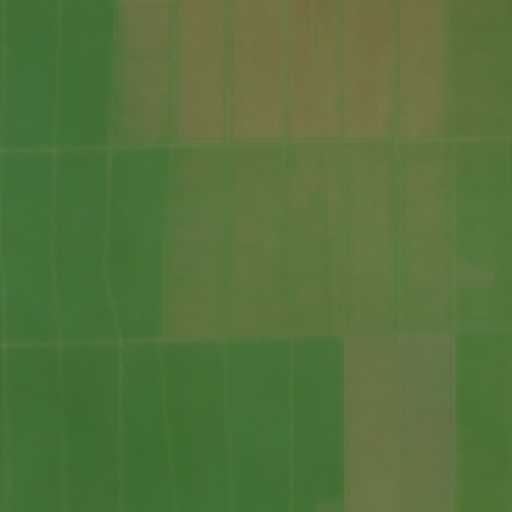

Cloud cover fraction: 0.5829315185546875


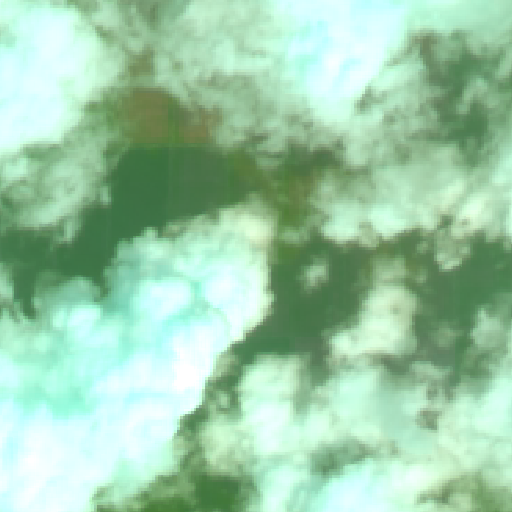

Cloud cover fraction: 0.0


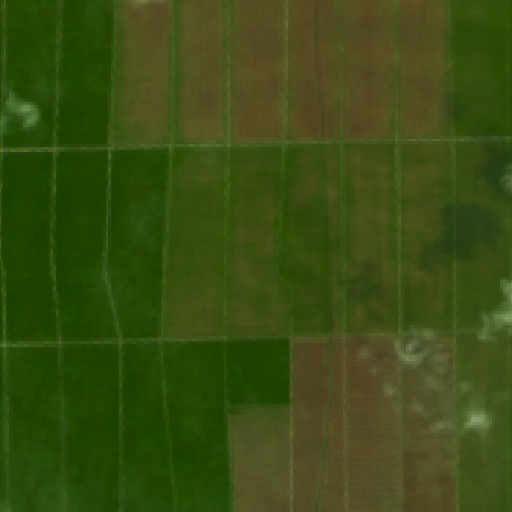

Cloud cover fraction: 0.061748504638671875


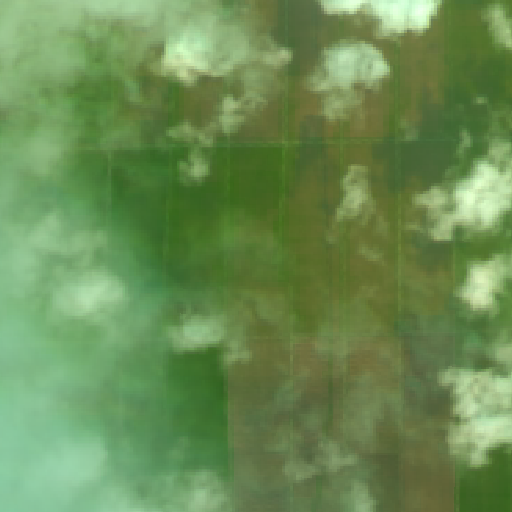

1.5 100.775 2014-07-01 2014-12-31
Cloud cover fraction: 0.0


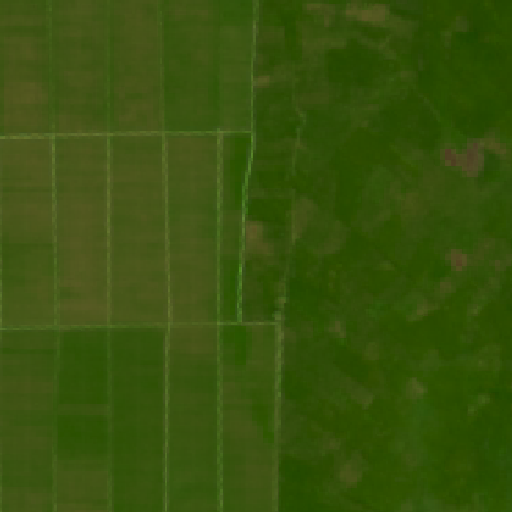

Cloud cover fraction: 0.0


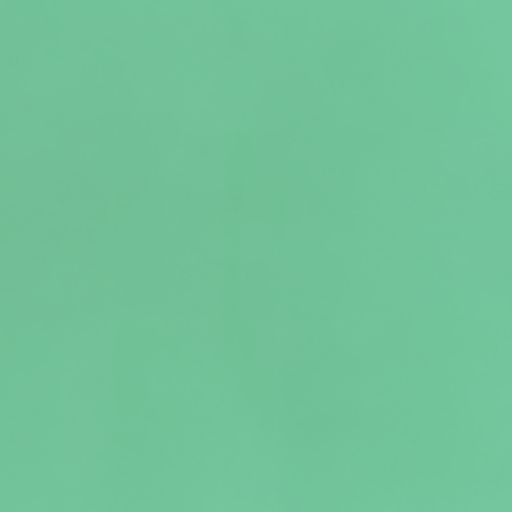

Cloud cover fraction: 0.0


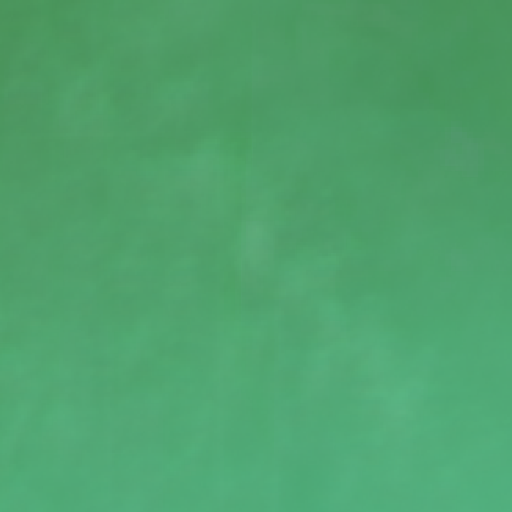

Cloud cover fraction: 0.0


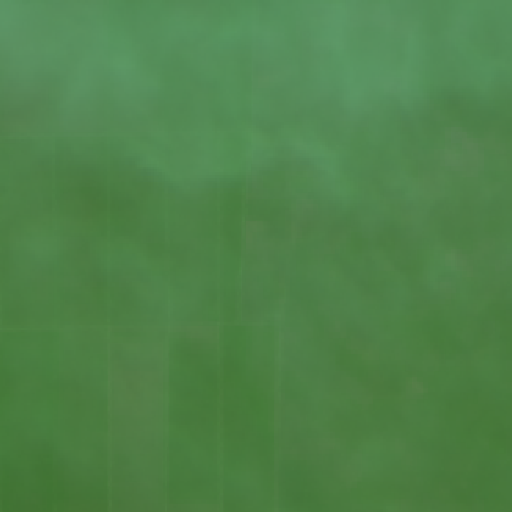

Cloud cover fraction: 0.003574371337890625


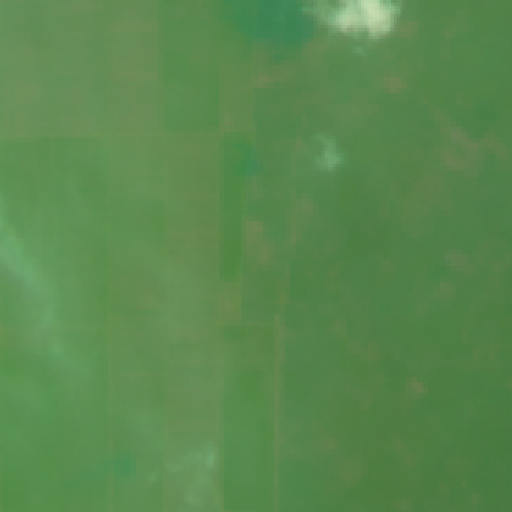

Cloud cover fraction: 0.35579681396484375


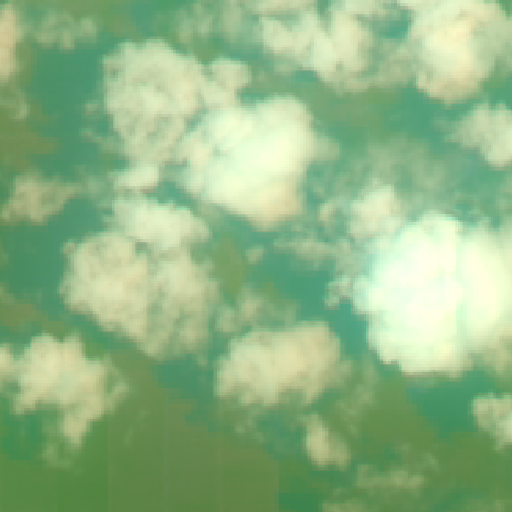

Cloud cover fraction: 0.21344375610351562


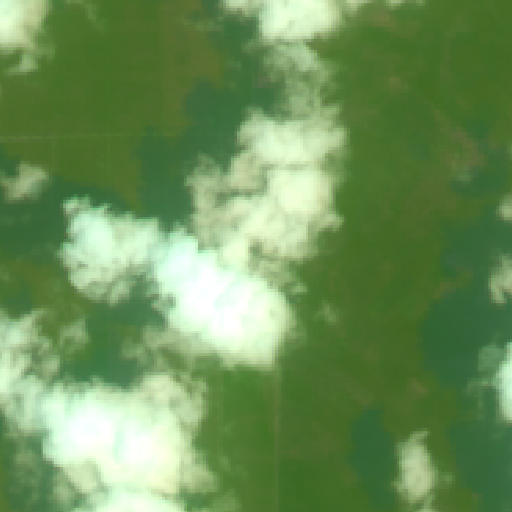

Cloud cover fraction: 0.0


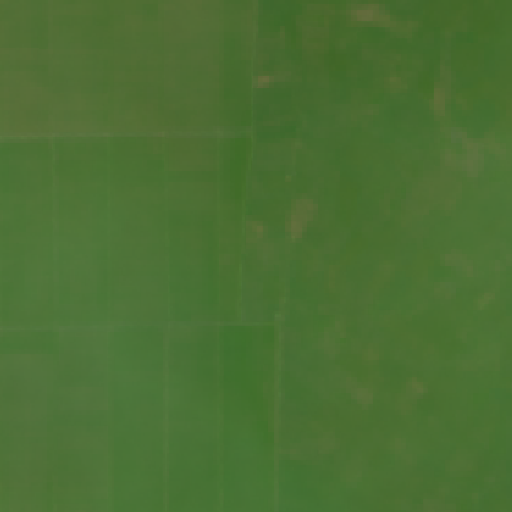

Cloud cover fraction: 0.40035247802734375


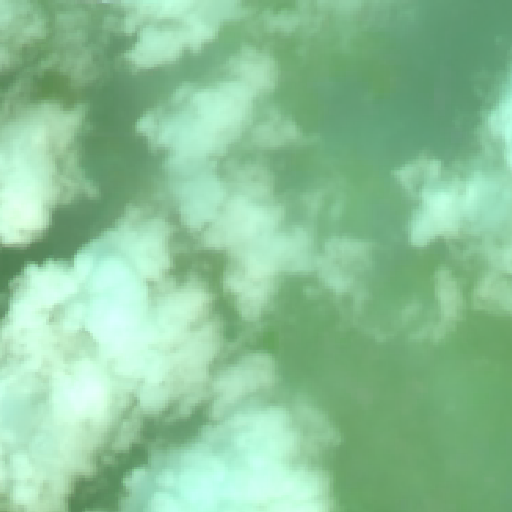

Cloud cover fraction: 0.0006256103515625


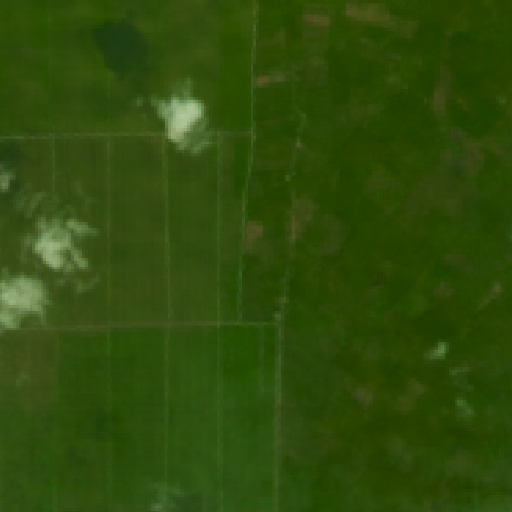

Cloud cover fraction: 0.037982940673828125


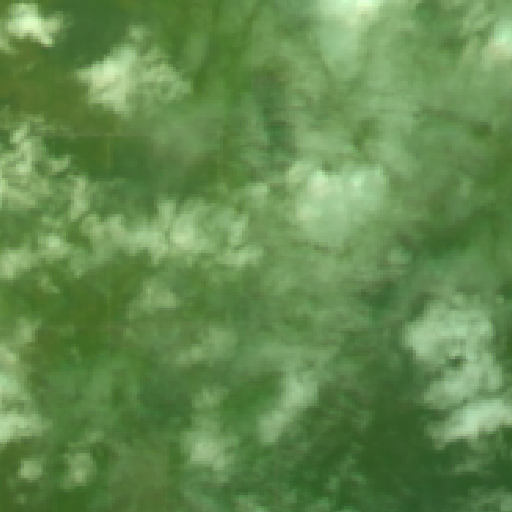

1.5 100.725 2014-07-01 2014-12-31
Cloud cover fraction: 7.2479248046875e-05


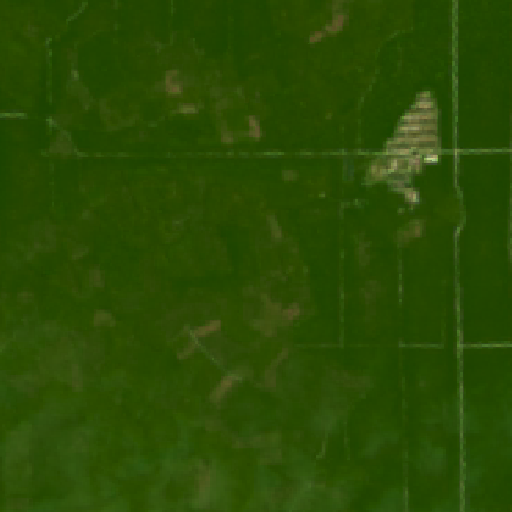

Cloud cover fraction: 0.0


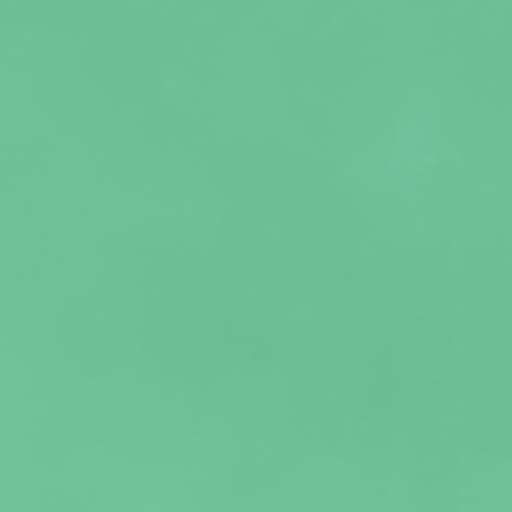

Cloud cover fraction: 0.0


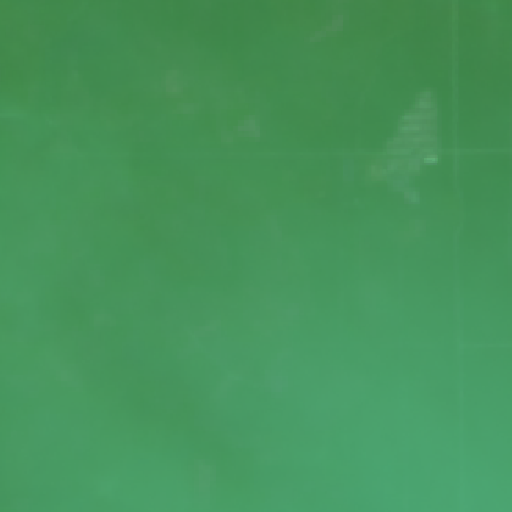

Cloud cover fraction: 0.0


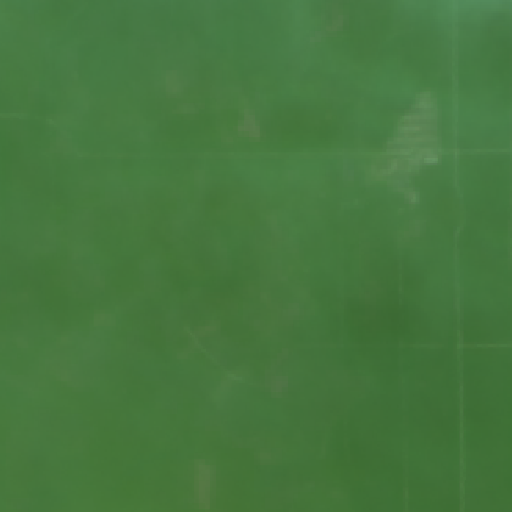

Cloud cover fraction: 0.0235137939453125


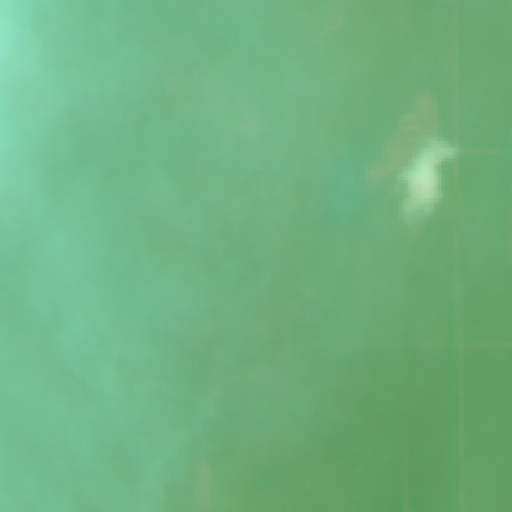

Cloud cover fraction: 0.097137451171875


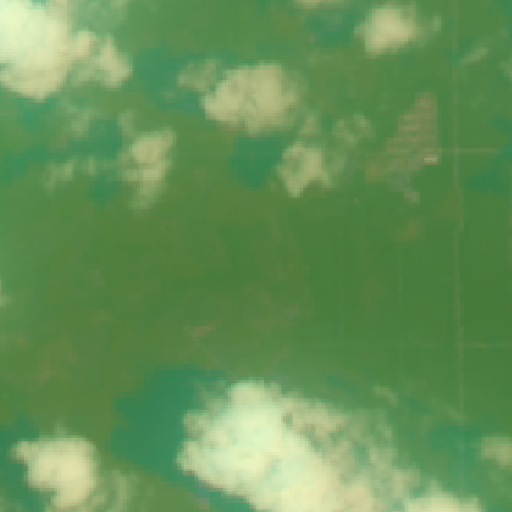

Cloud cover fraction: 0.28885650634765625


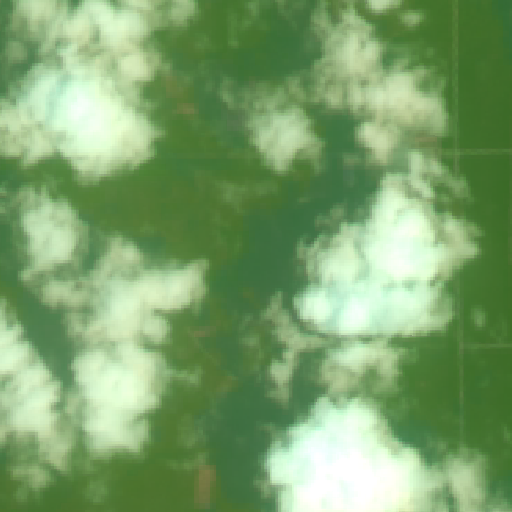

Cloud cover fraction: 0.0


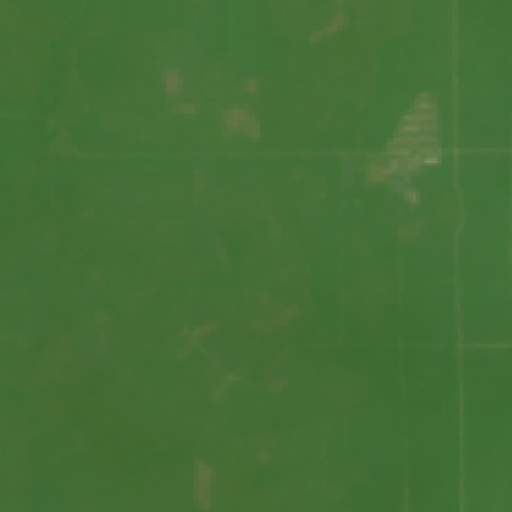

Cloud cover fraction: 0.7503700256347656


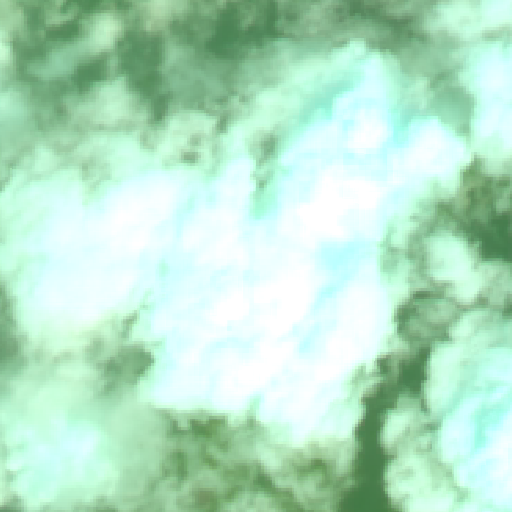

Cloud cover fraction: 8.0108642578125e-05


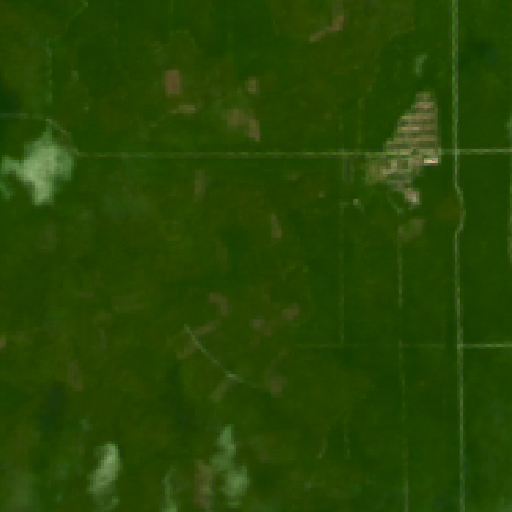

Cloud cover fraction: 0.49678802490234375


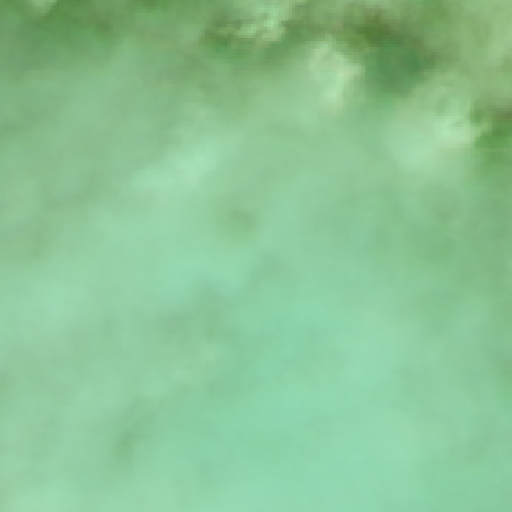

1.525 100.75 2014-07-01 2014-12-31
Cloud cover fraction: 0.0


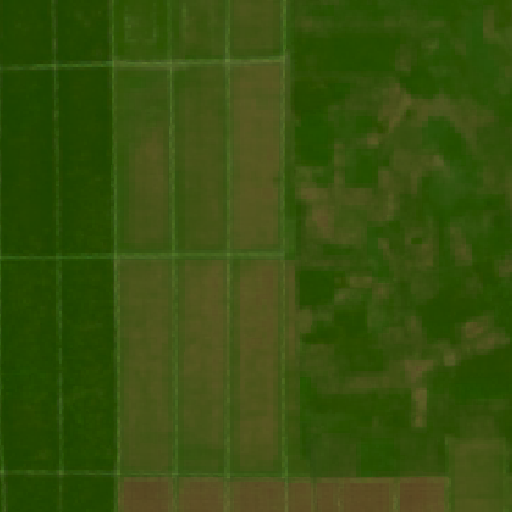

Cloud cover fraction: 0.0


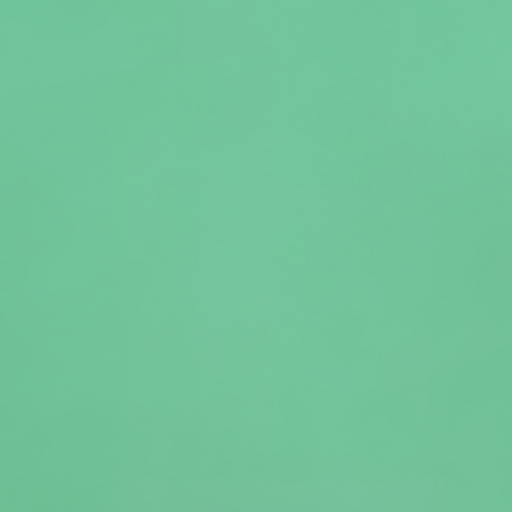

Cloud cover fraction: 0.0


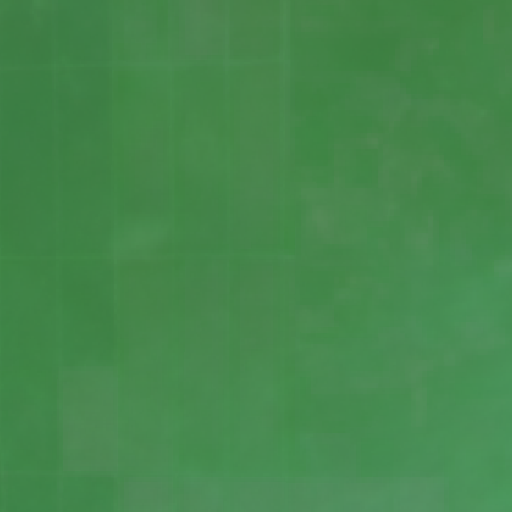

Cloud cover fraction: 0.0


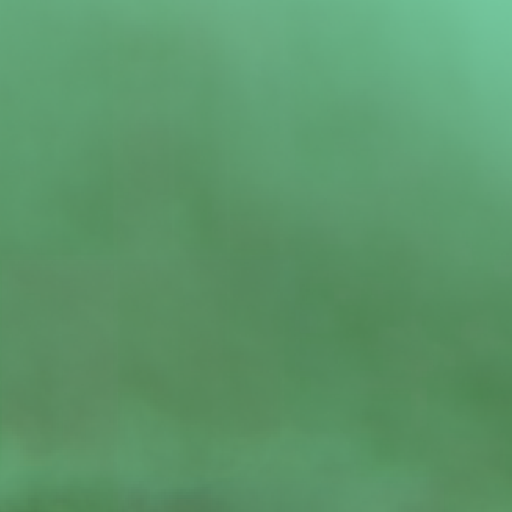

Cloud cover fraction: 0.0080718994140625


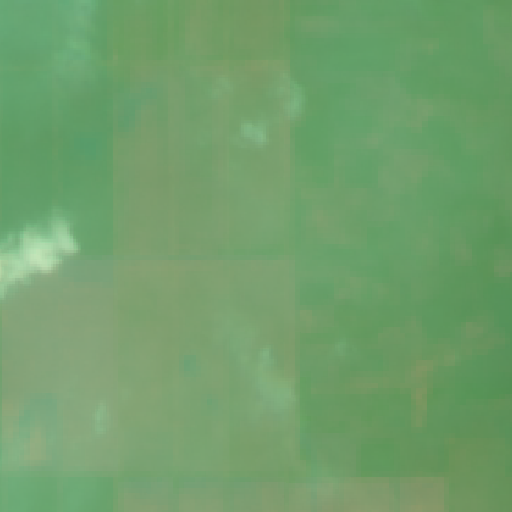

Cloud cover fraction: 0.13214492797851562


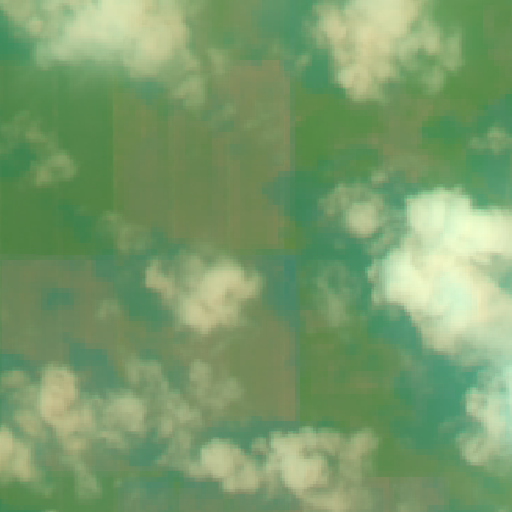

Cloud cover fraction: 0.15143966674804688


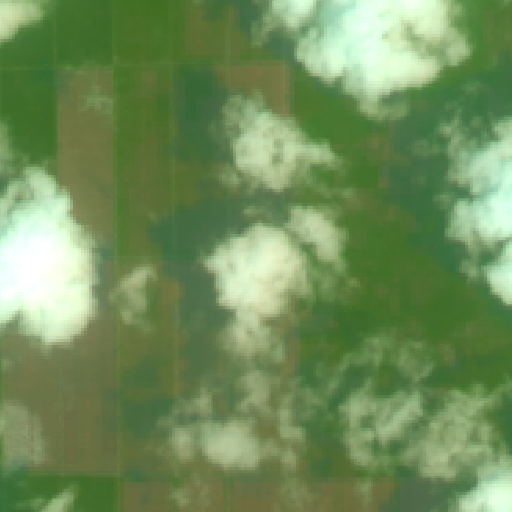

Cloud cover fraction: 0.0


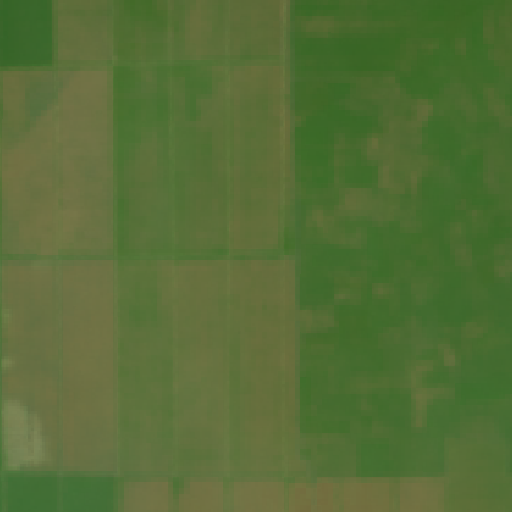

Cloud cover fraction: 0.6345367431640625


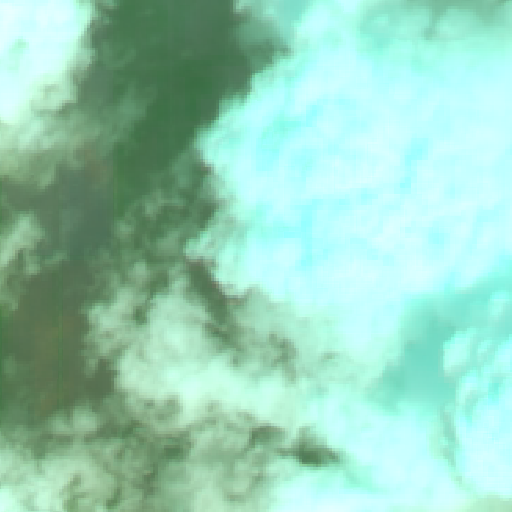

Cloud cover fraction: 0.003482818603515625


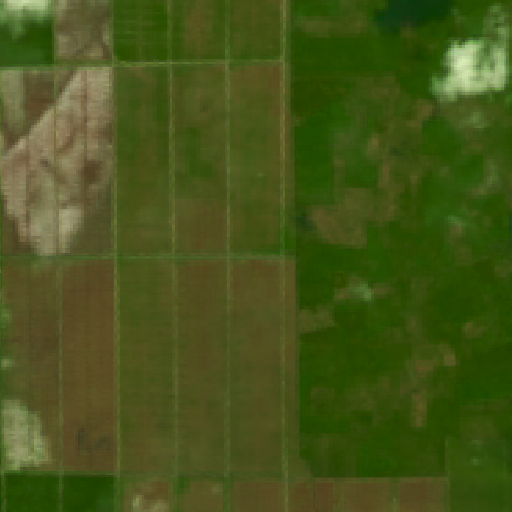

Cloud cover fraction: 0.27747344970703125


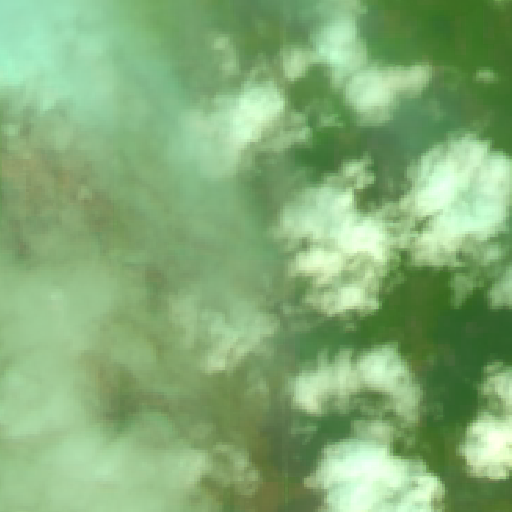

1.475 100.75 2014-07-01 2014-12-31
Cloud cover fraction: 0.0


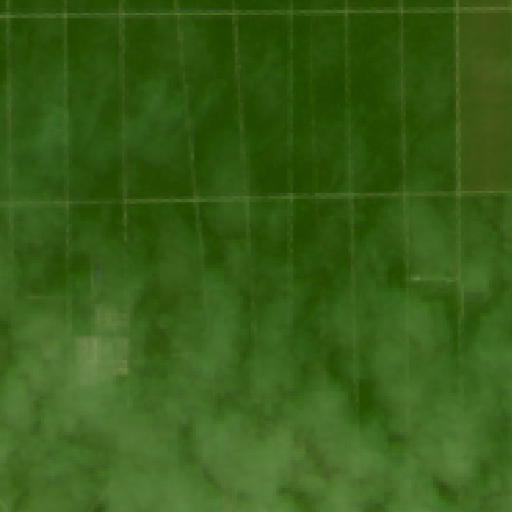

Cloud cover fraction: 0.0


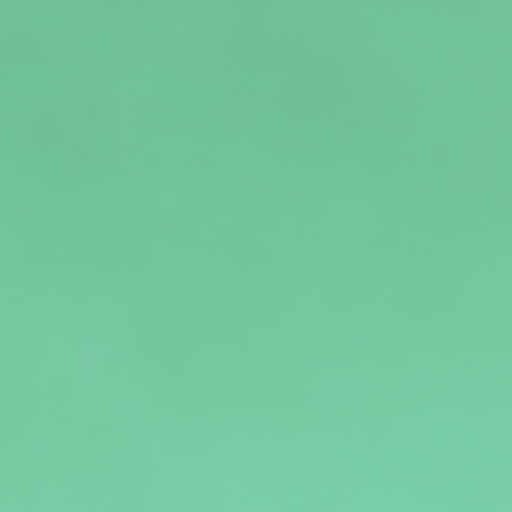

Cloud cover fraction: 0.0


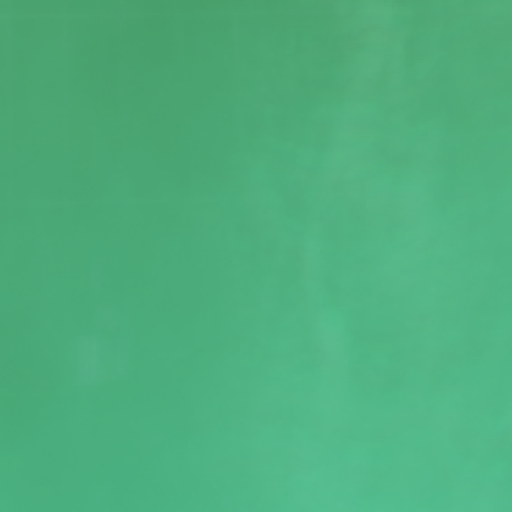

Cloud cover fraction: 0.0


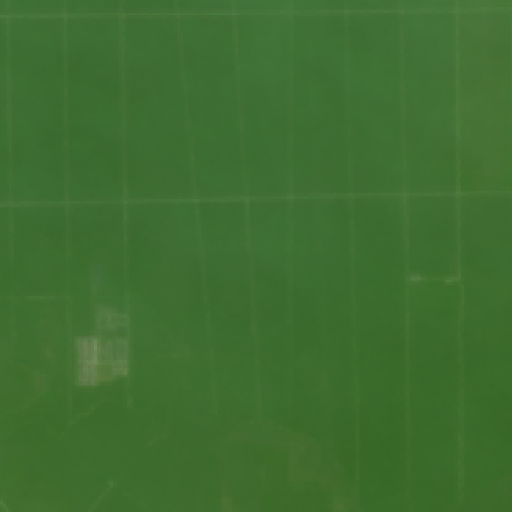

Cloud cover fraction: 0.0


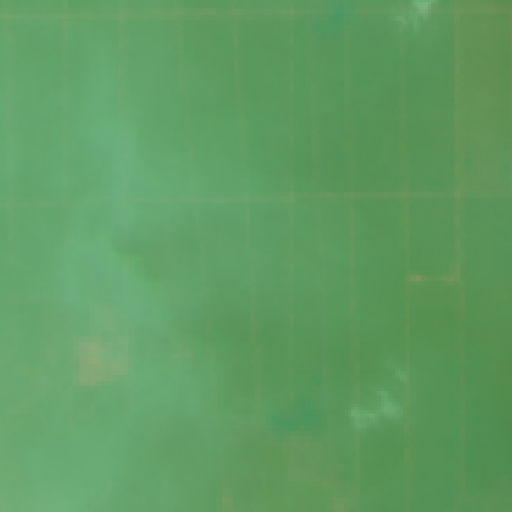

Cloud cover fraction: 0.075897216796875


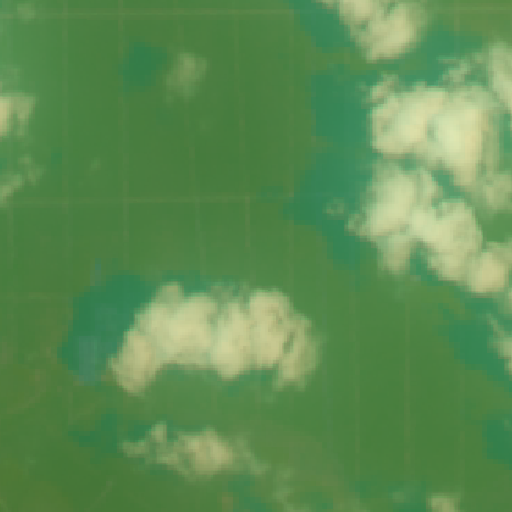

Cloud cover fraction: 0.182830810546875


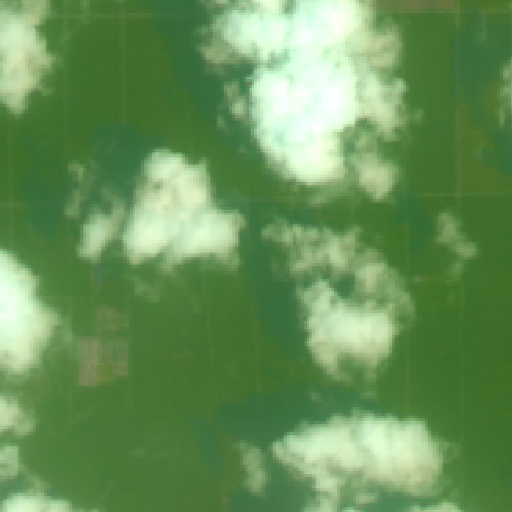

Cloud cover fraction: 0.0


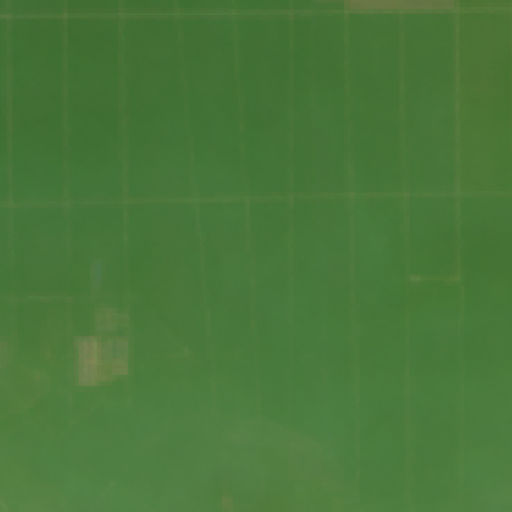

Cloud cover fraction: 0.14887619018554688


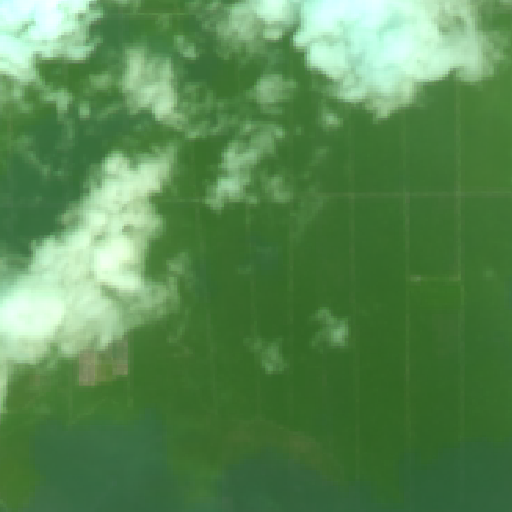

Cloud cover fraction: 0.0


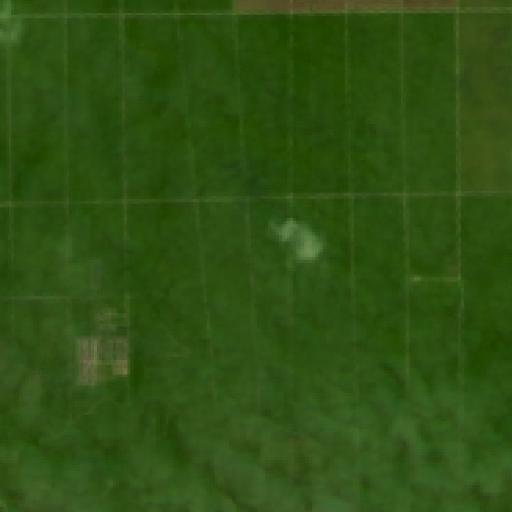

Cloud cover fraction: 0.009979248046875


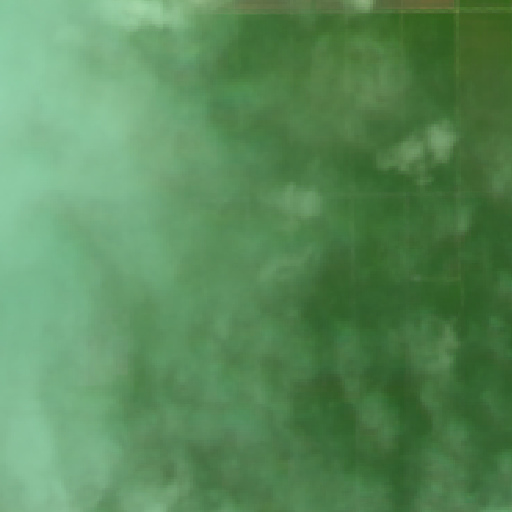

1.525 100.775 2014-07-01 2014-12-31
Cloud cover fraction: 0.00048828125


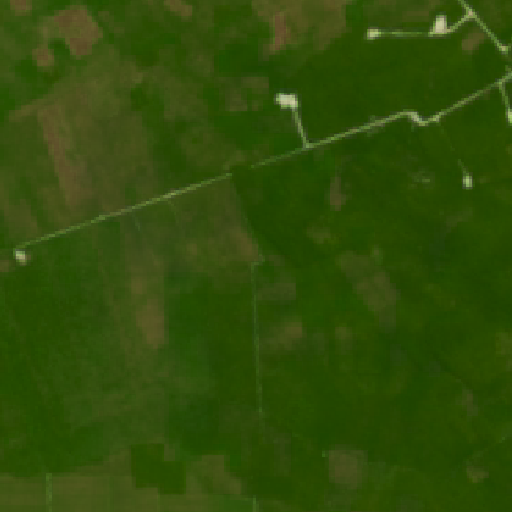

Cloud cover fraction: 0.0


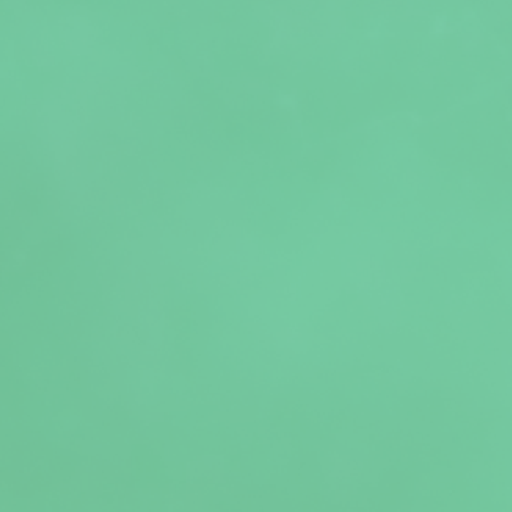

Cloud cover fraction: 0.0


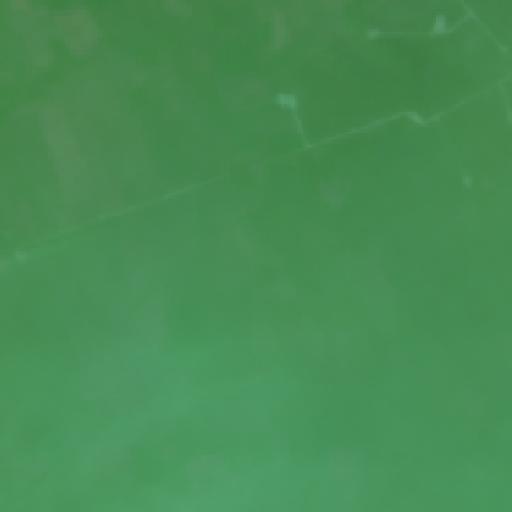

Cloud cover fraction: 0.0


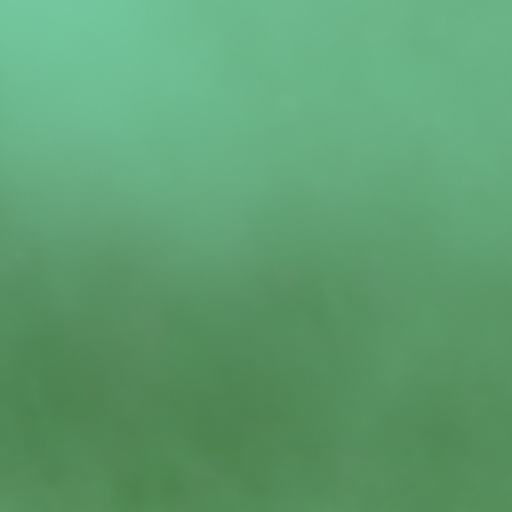

Cloud cover fraction: 0.000530242919921875


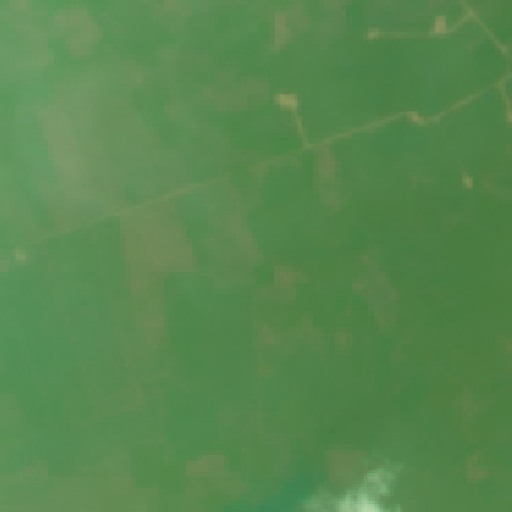

Cloud cover fraction: 0.4684410095214844


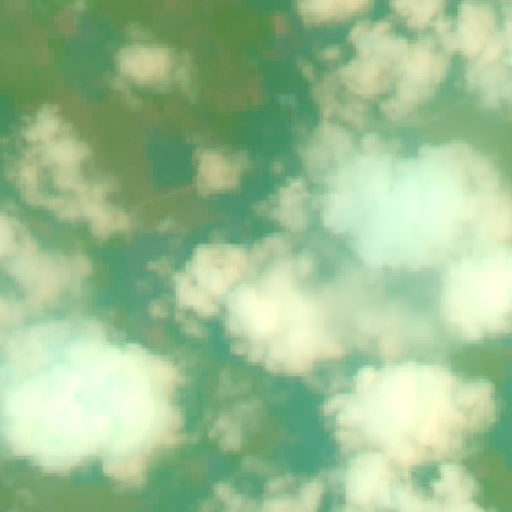

Cloud cover fraction: 0.3014183044433594


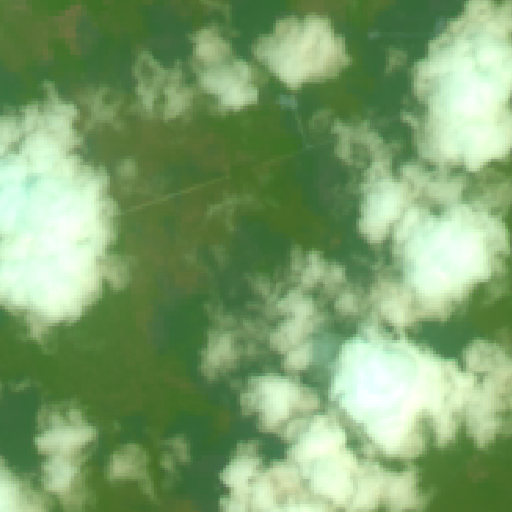

Cloud cover fraction: 0.0


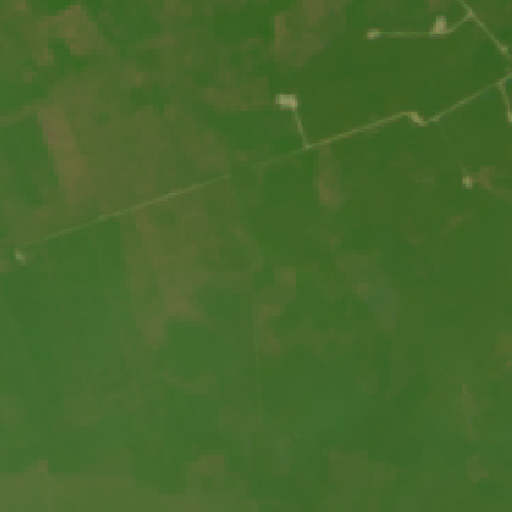

Cloud cover fraction: 0.8916664123535156


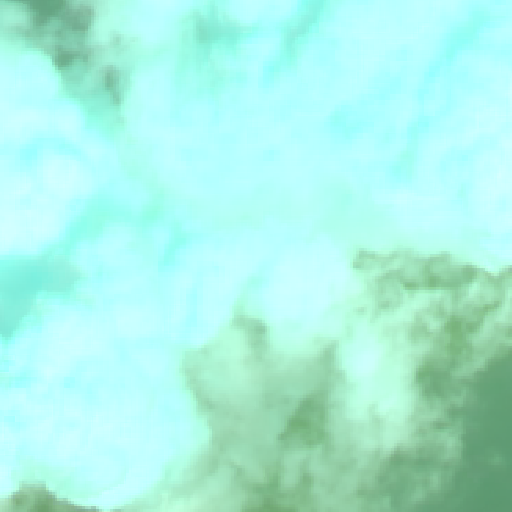

Cloud cover fraction: 0.037204742431640625


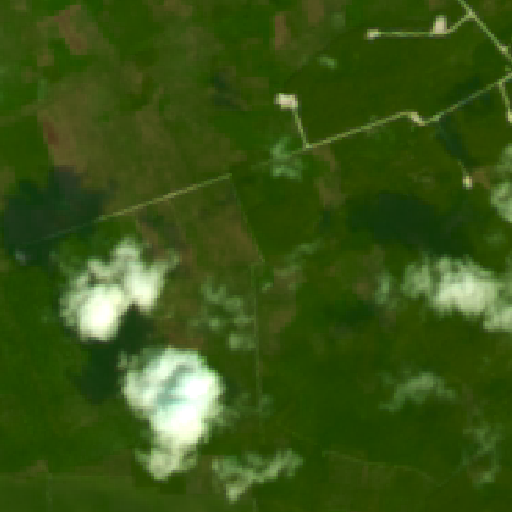

Cloud cover fraction: 0.09752273559570312


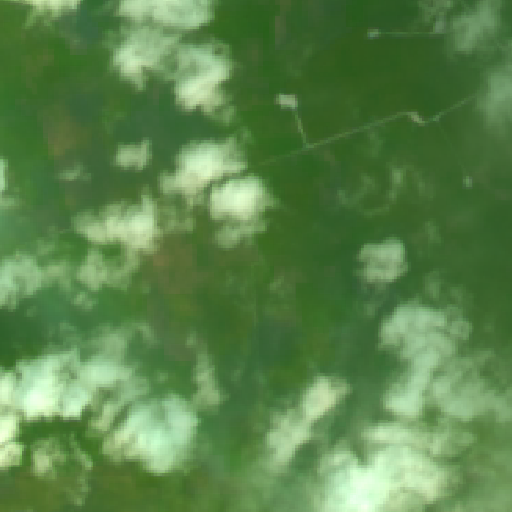

1.475 100.775 2014-07-01 2014-12-31
Cloud cover fraction: 0.0


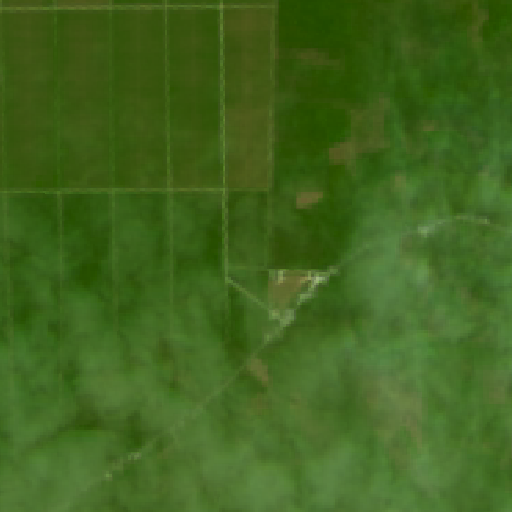

Cloud cover fraction: 0.141448974609375


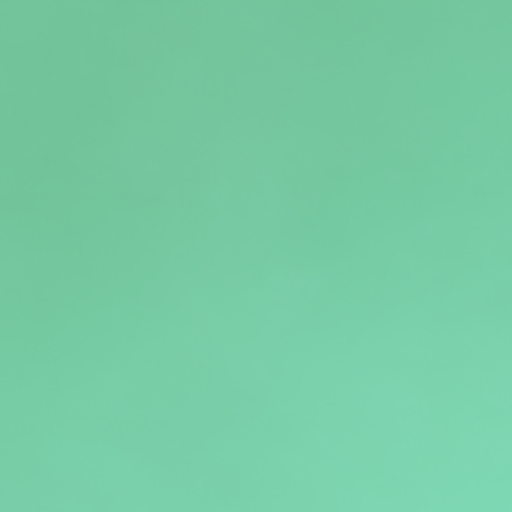

Cloud cover fraction: 0.0


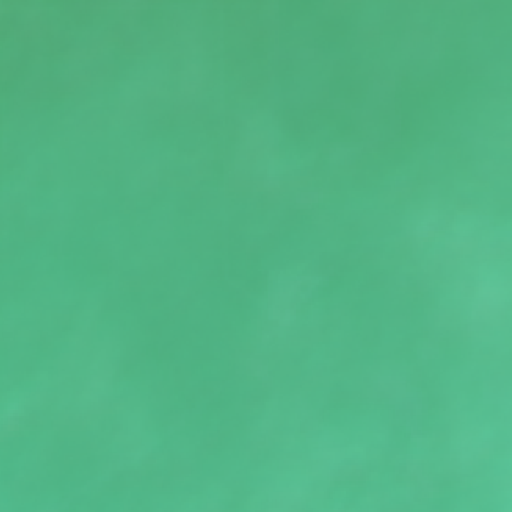

Cloud cover fraction: 0.0


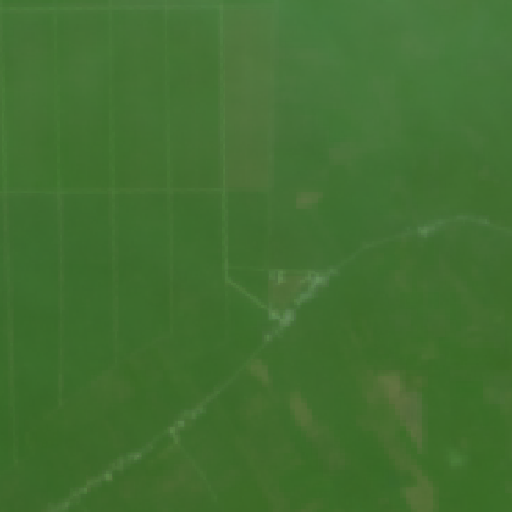

Cloud cover fraction: 0.0


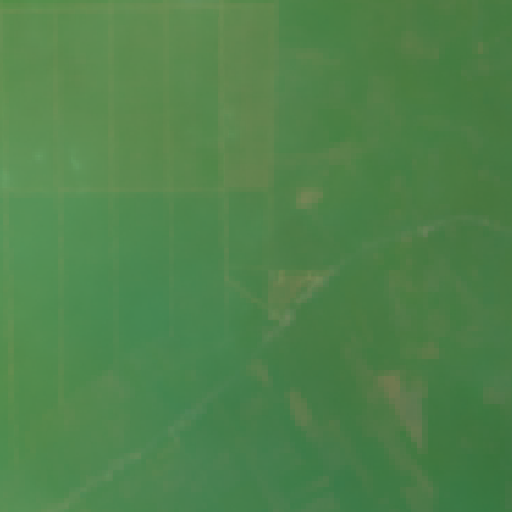

Cloud cover fraction: 0.022960662841796875


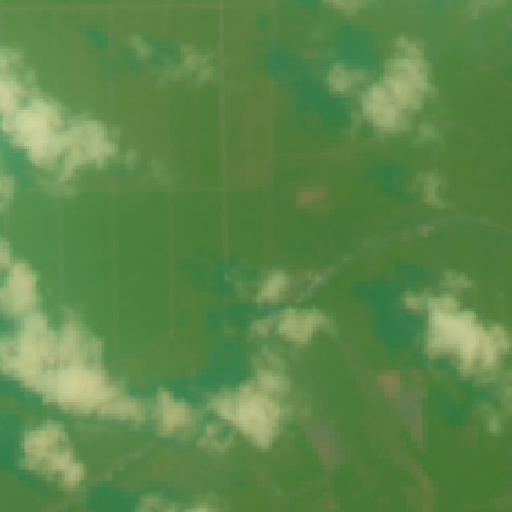

Cloud cover fraction: 0.16089630126953125


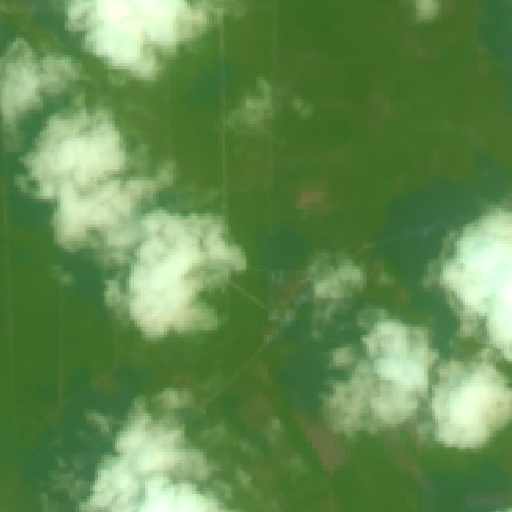

Cloud cover fraction: 0.0


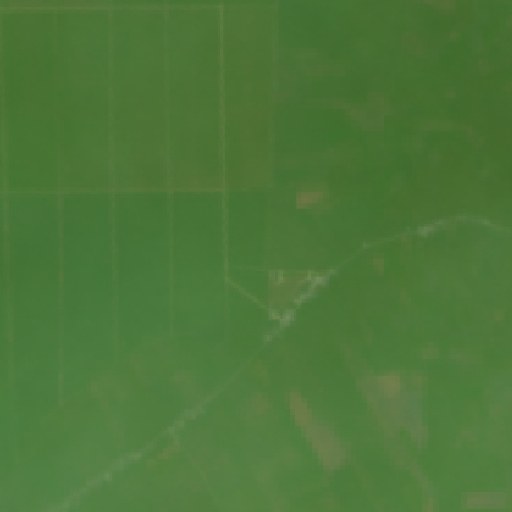

Cloud cover fraction: 0.2382659912109375


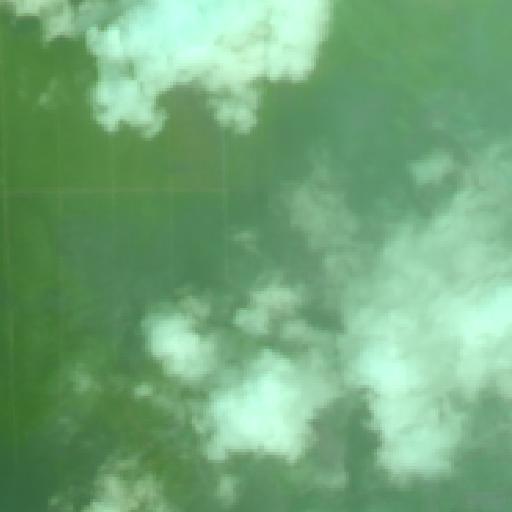

Cloud cover fraction: 0.008396148681640625


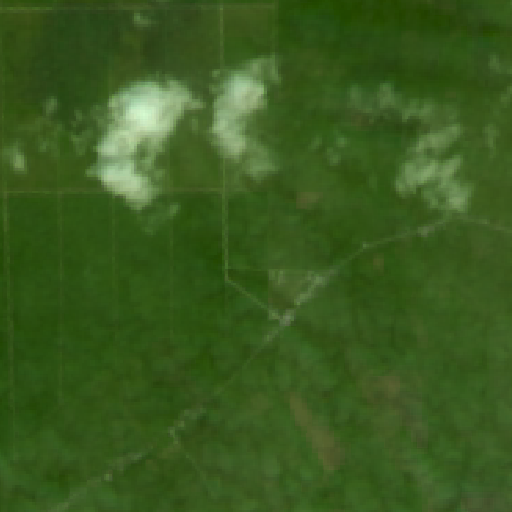

Cloud cover fraction: 0.0


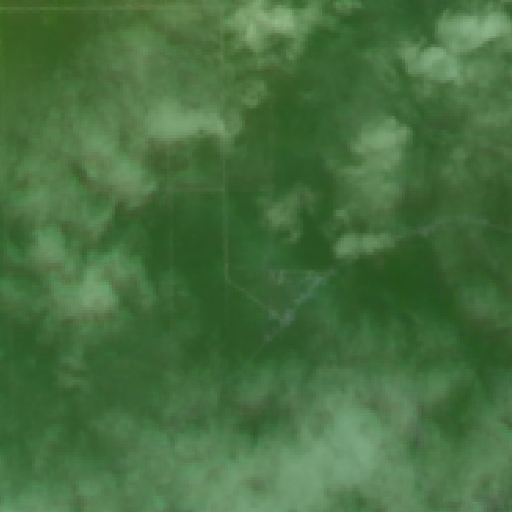

1.525 100.725 2014-07-01 2014-12-31
Cloud cover fraction: 8.7738037109375e-05


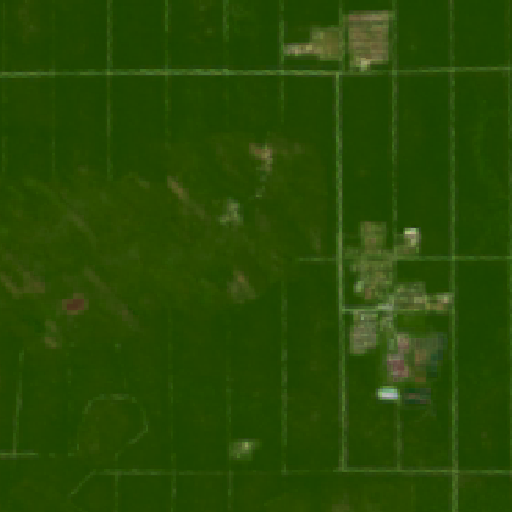

Cloud cover fraction: 0.0


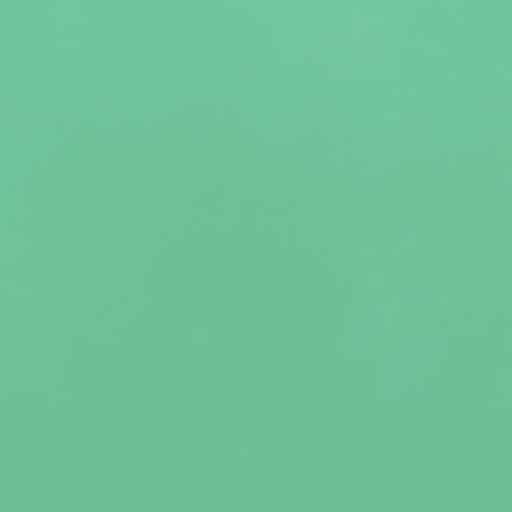

Cloud cover fraction: 0.0


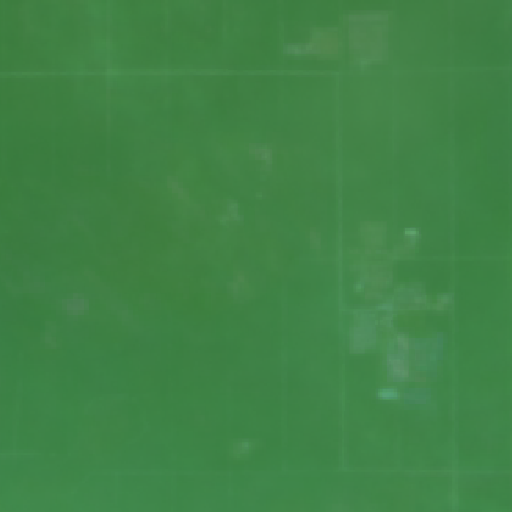

Cloud cover fraction: 0.0


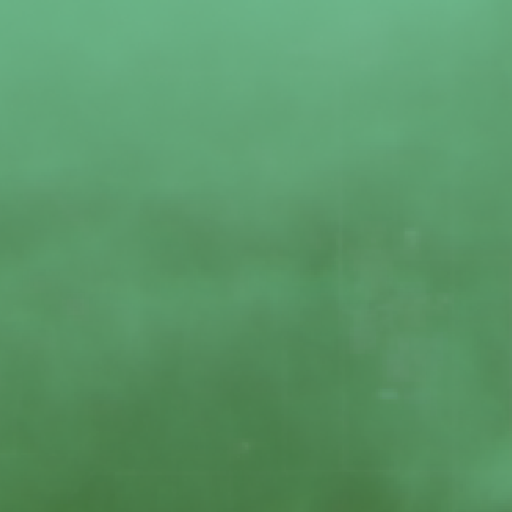

Cloud cover fraction: 0.04601287841796875


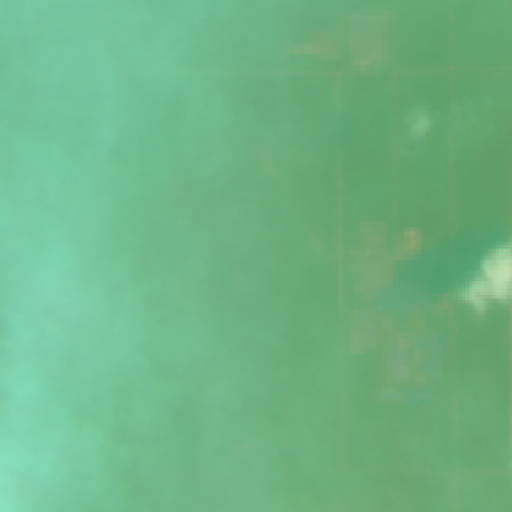

Cloud cover fraction: 0.08289718627929688


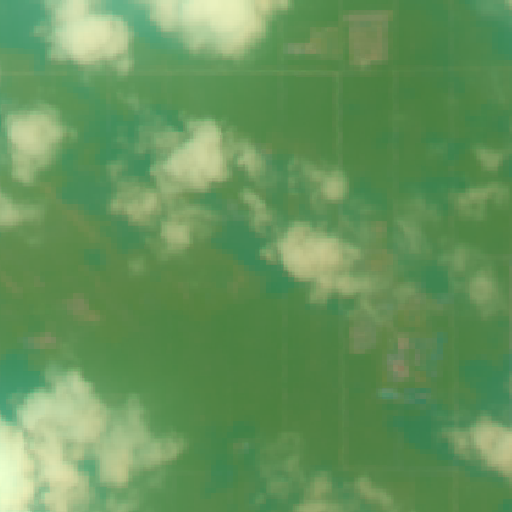

Cloud cover fraction: 0.28376007080078125


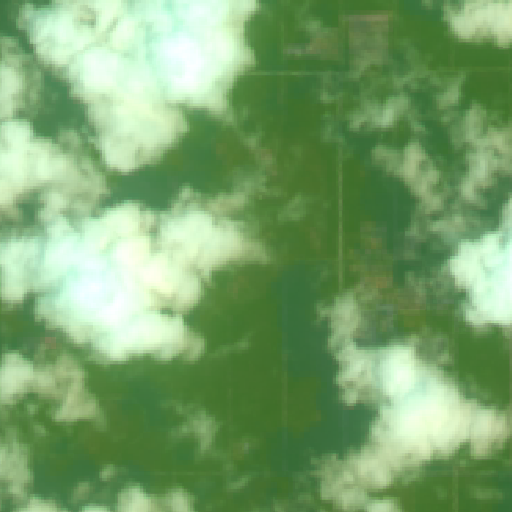

Cloud cover fraction: 0.0


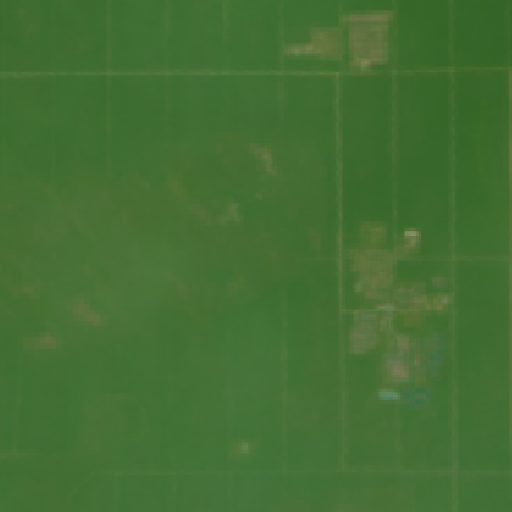

Cloud cover fraction: 0.2542304992675781


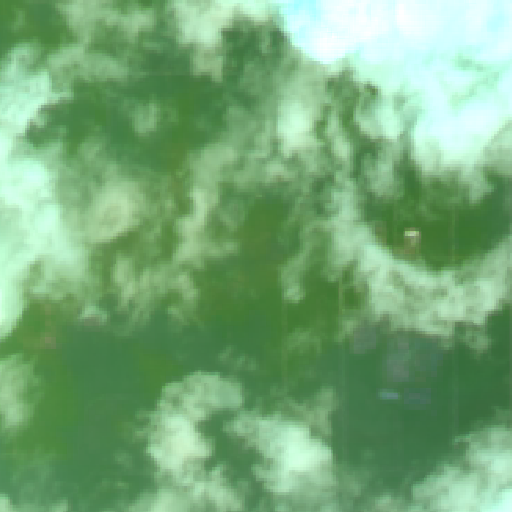

Cloud cover fraction: 0.00682830810546875


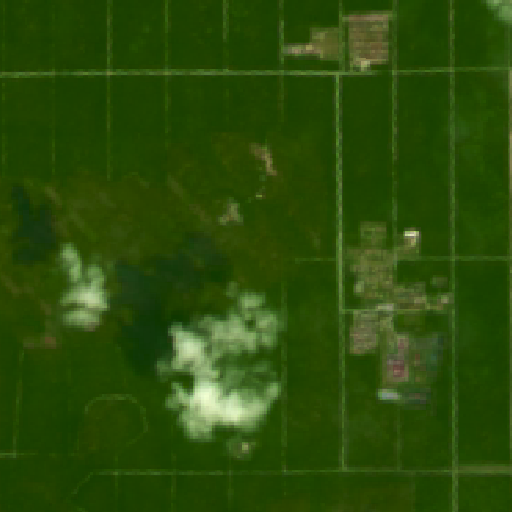

Cloud cover fraction: 0.1014404296875


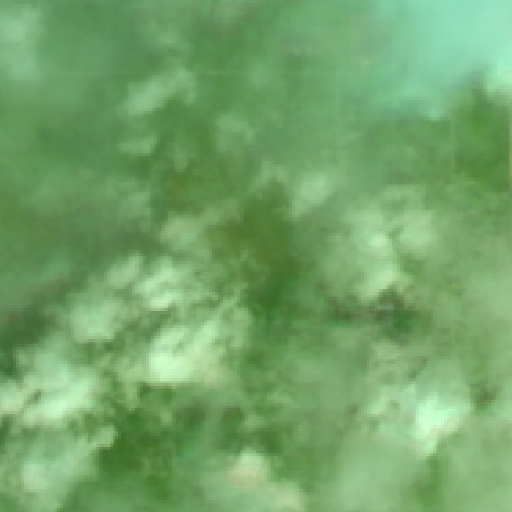

1.475 100.725 2014-07-01 2014-12-31
Cloud cover fraction: 0.0


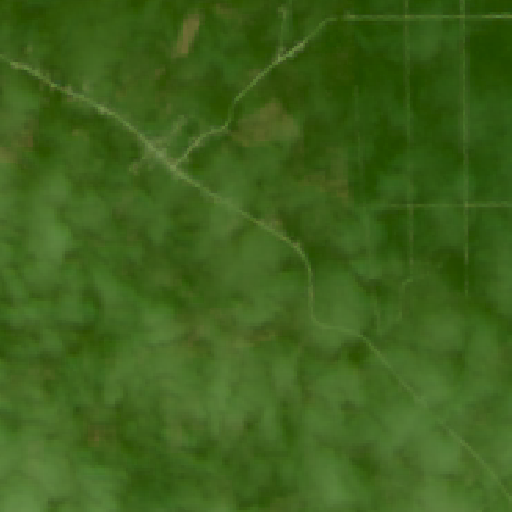

Cloud cover fraction: 0.0


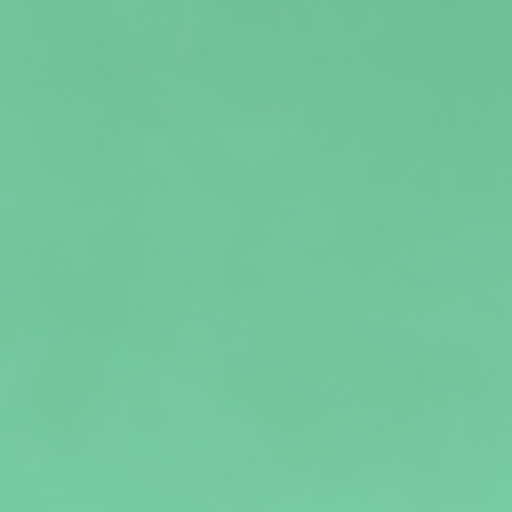

Cloud cover fraction: 0.0


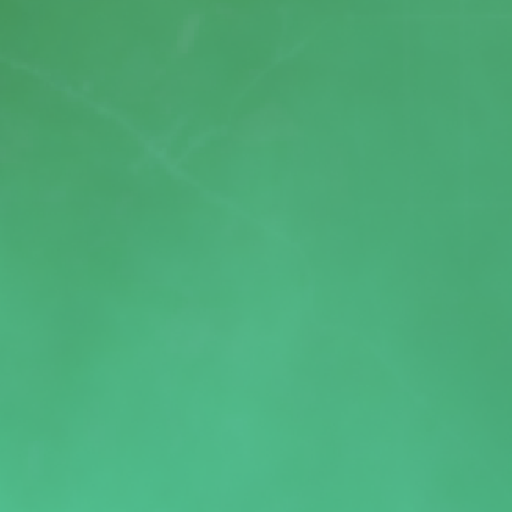

Cloud cover fraction: 0.0


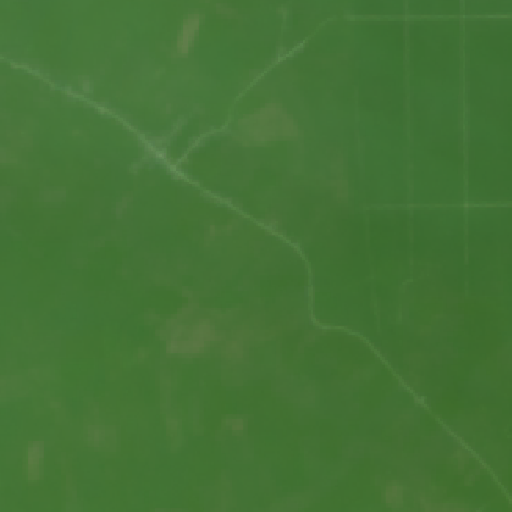

Cloud cover fraction: 0.0


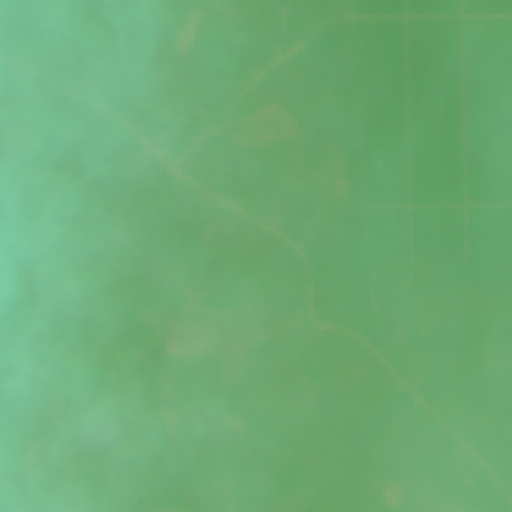

Cloud cover fraction: 0.08100509643554688


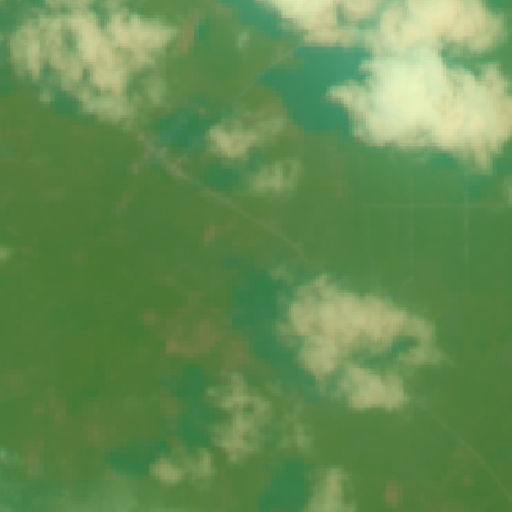

Cloud cover fraction: 0.27516937255859375


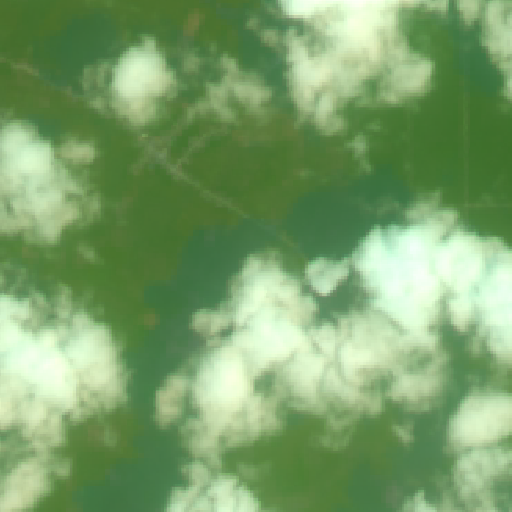

Cloud cover fraction: 0.0


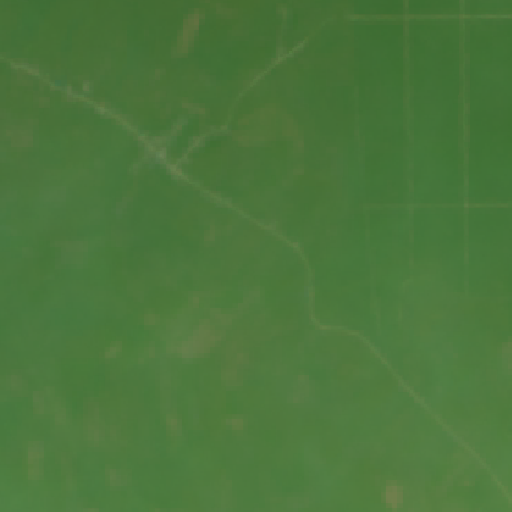

Cloud cover fraction: 0.460693359375


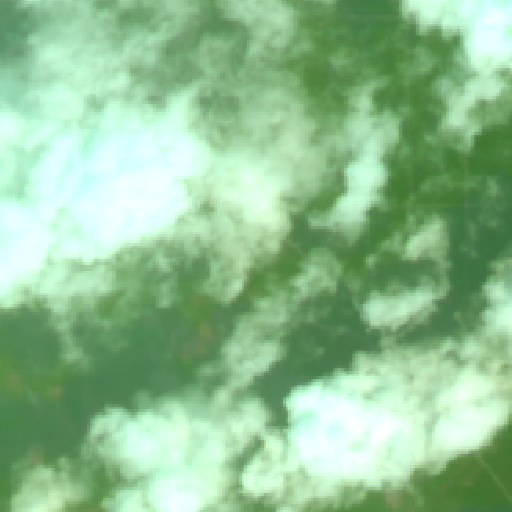

Cloud cover fraction: 0.011474609375


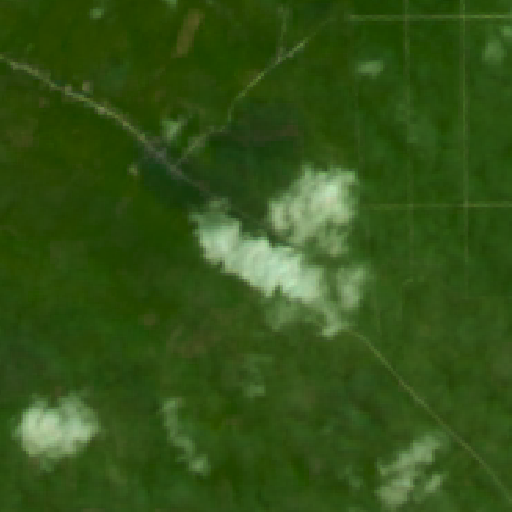

Cloud cover fraction: 0.6889114379882812


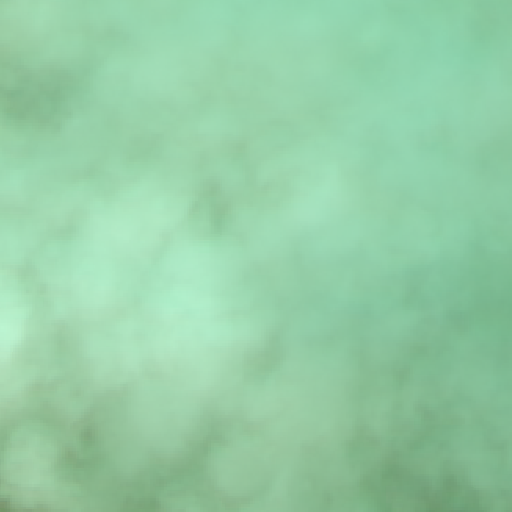

2014-07-01 2014-12-31

The average cloud coverage is: 0.0987439781728417 from 2014-07-01 to 2014-12-31.

1.5 100.75 2015-01-01 2015-06-30
Cloud cover fraction: 0.051055908203125


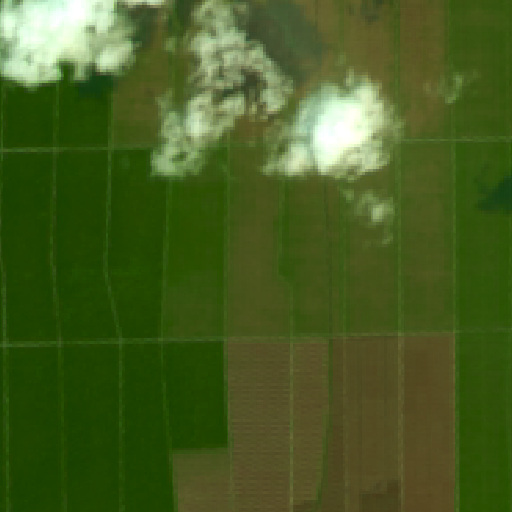

Cloud cover fraction: 0.8939628601074219


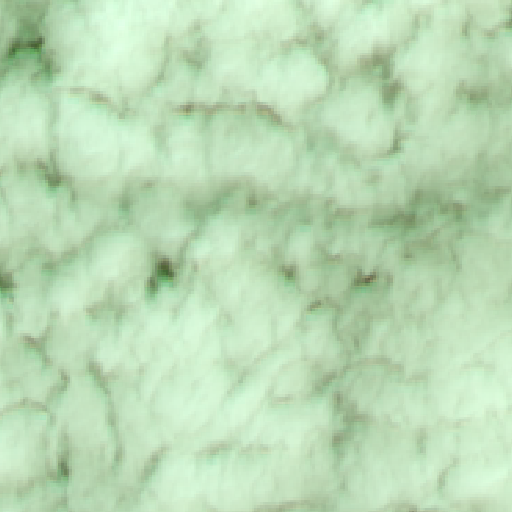

Cloud cover fraction: 0.03759765625


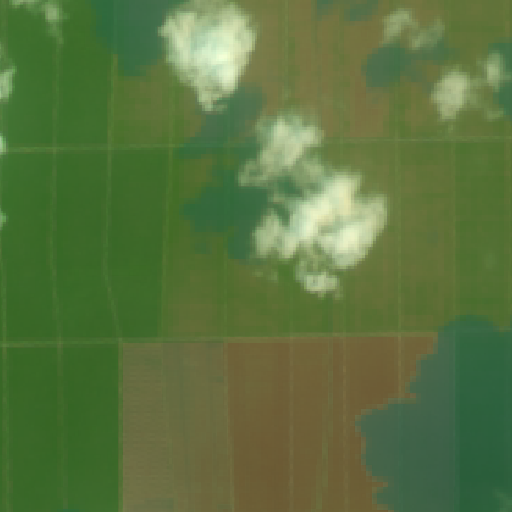

Cloud cover fraction: 0.030941009521484375


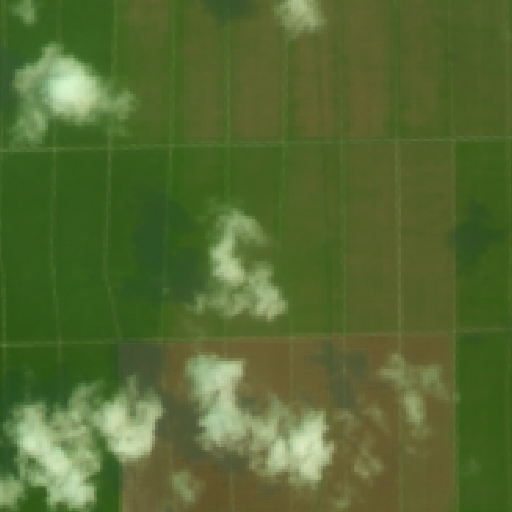

Cloud cover fraction: 0.2544364929199219


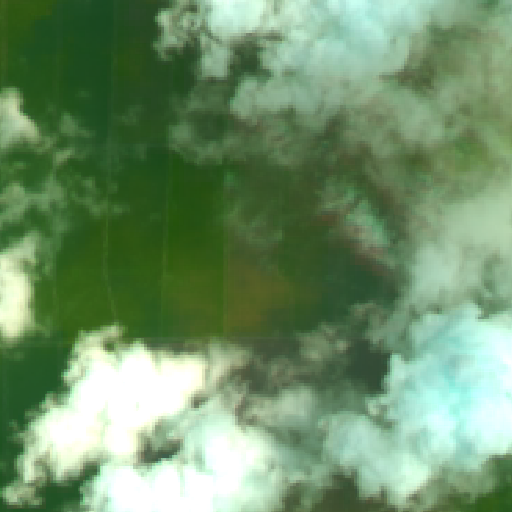

Cloud cover fraction: 0.0022125244140625


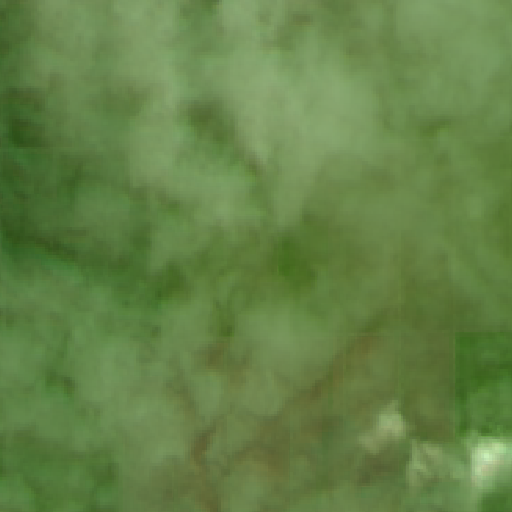

Cloud cover fraction: 0.0


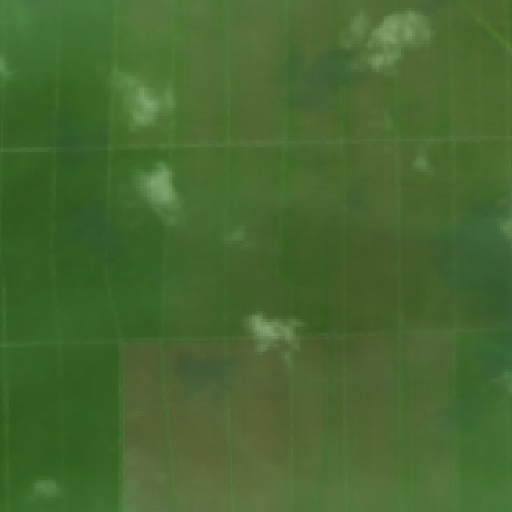

Cloud cover fraction: 0.02496337890625


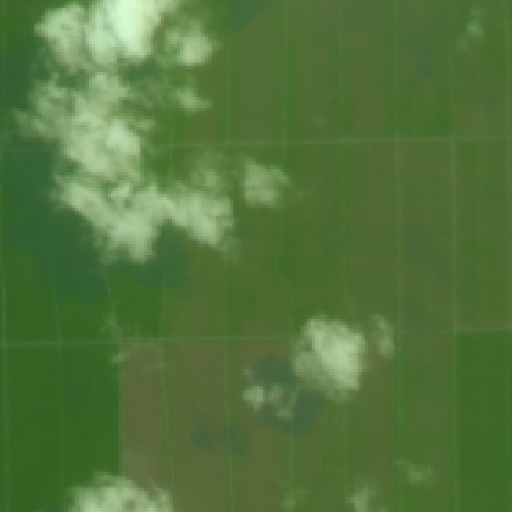

Cloud cover fraction: 0.257476806640625


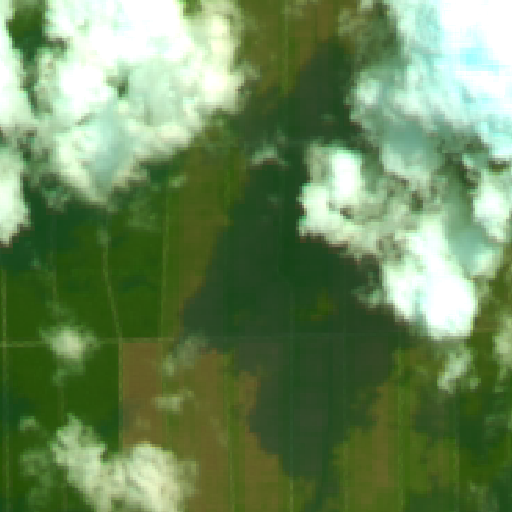

Cloud cover fraction: 0.0


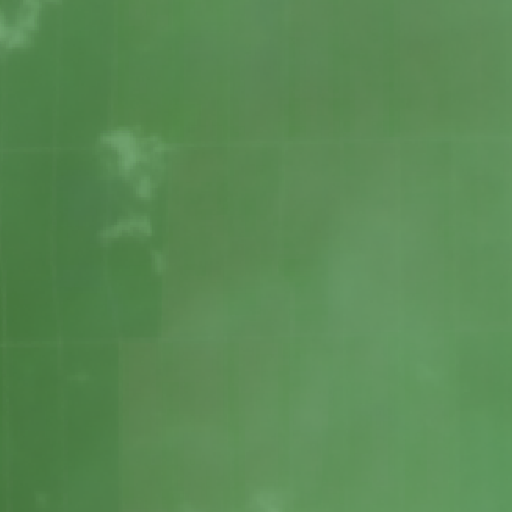

1.5 100.775 2015-01-01 2015-06-30
Cloud cover fraction: 0.01639556884765625


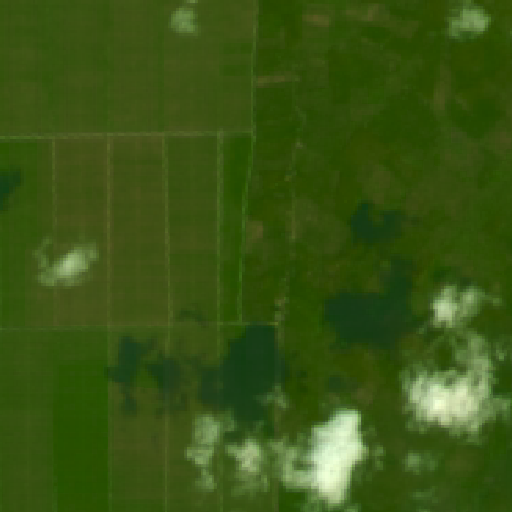

Cloud cover fraction: 0.8790435791015625


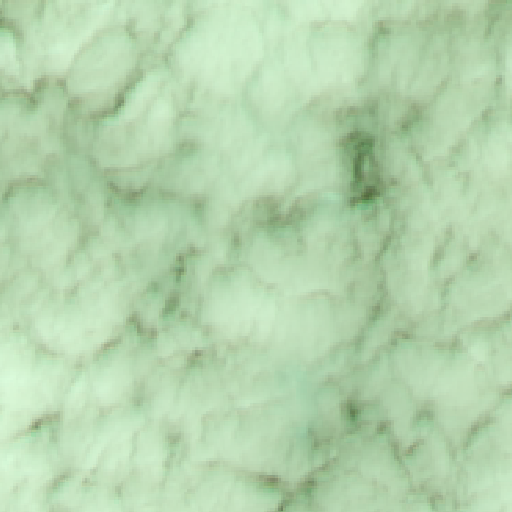

Cloud cover fraction: 0.23900985717773438


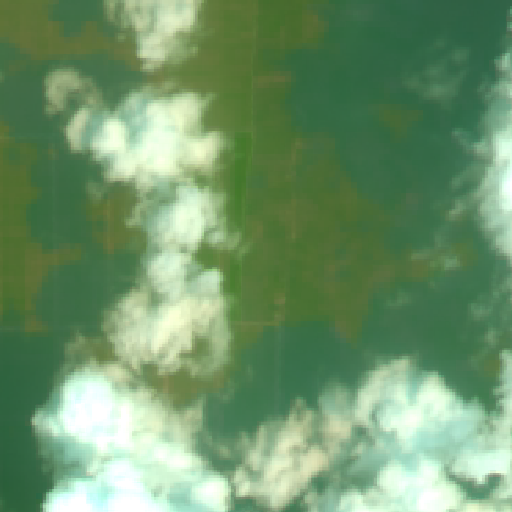

Cloud cover fraction: 0.0027923583984375


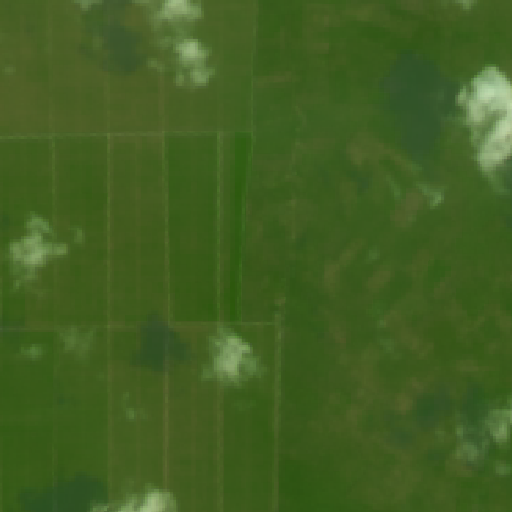

Cloud cover fraction: 0.5658302307128906


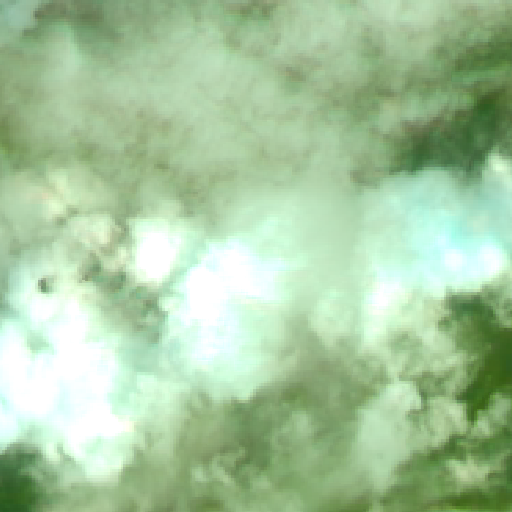

Cloud cover fraction: 0.006008148193359375


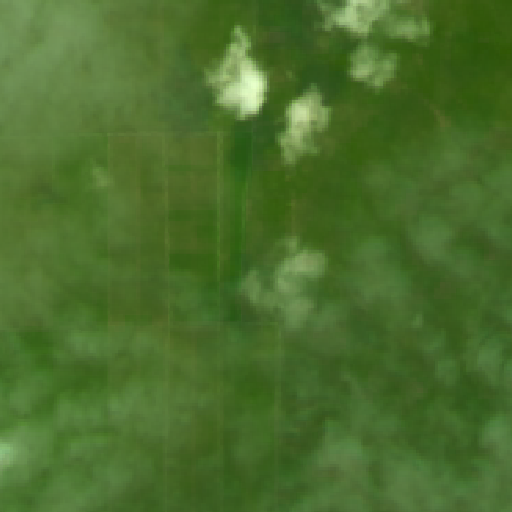

Cloud cover fraction: 0.07043838500976562


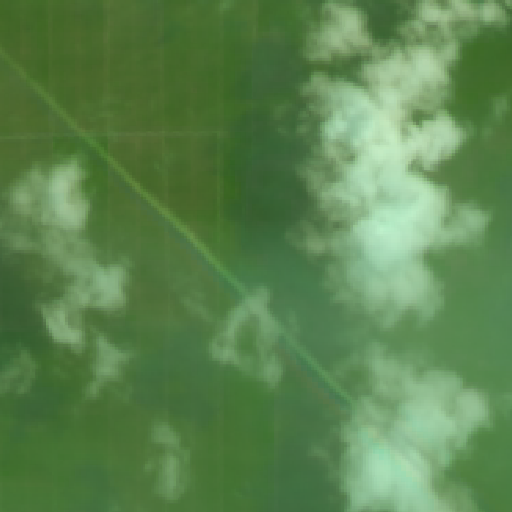

Cloud cover fraction: 0.0


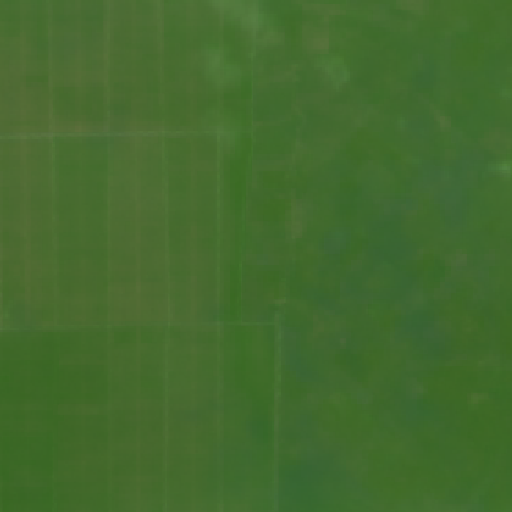

Cloud cover fraction: 0.17275619506835938


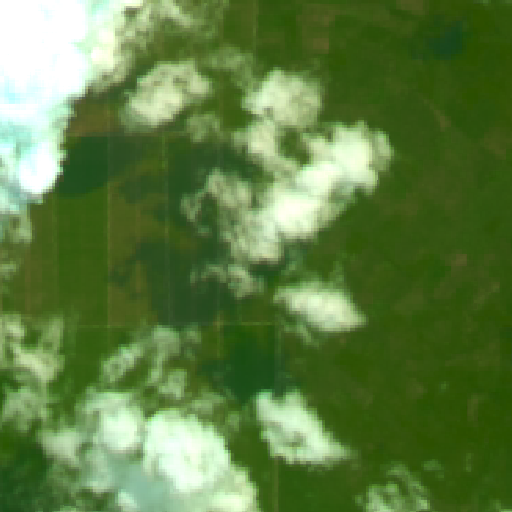

Cloud cover fraction: 0.0


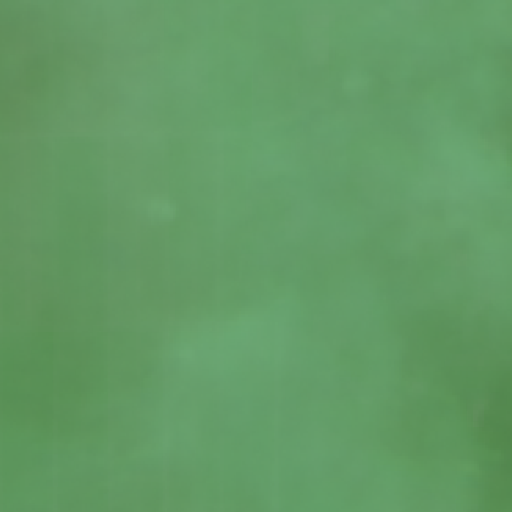

1.5 100.725 2015-01-01 2015-06-30
Cloud cover fraction: 0.000186920166015625


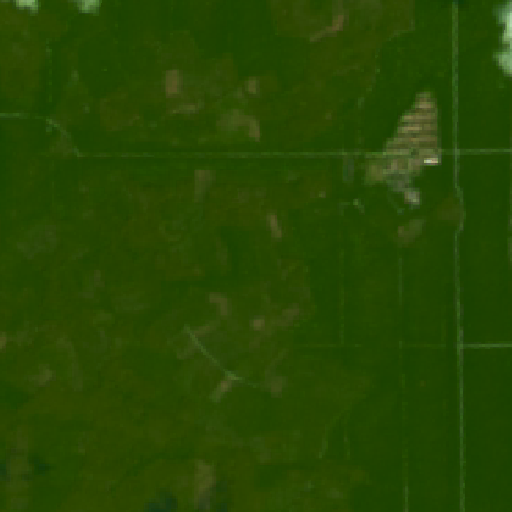

Cloud cover fraction: 0.7976036071777344


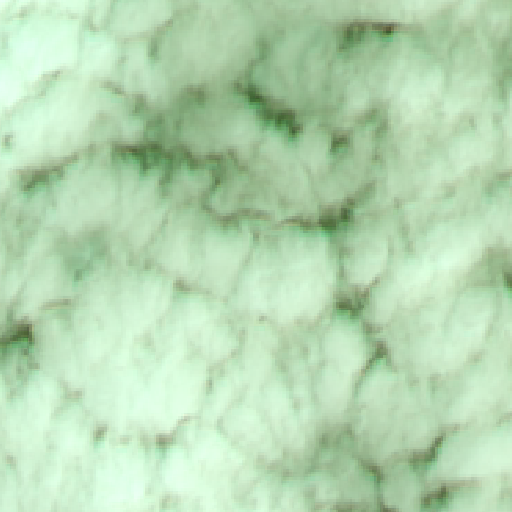

Cloud cover fraction: 0.32700347900390625


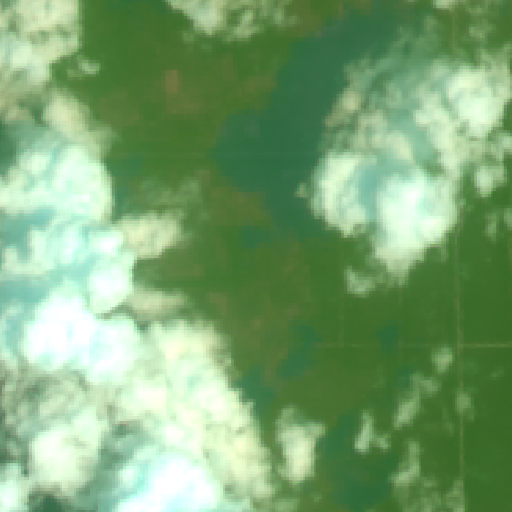

Cloud cover fraction: 0.026401519775390625


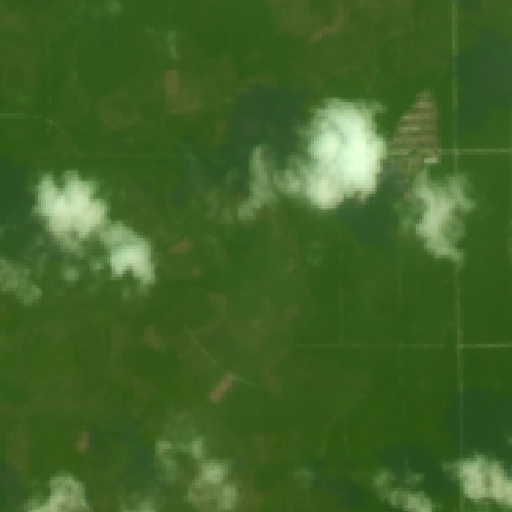

Cloud cover fraction: 0.53607177734375


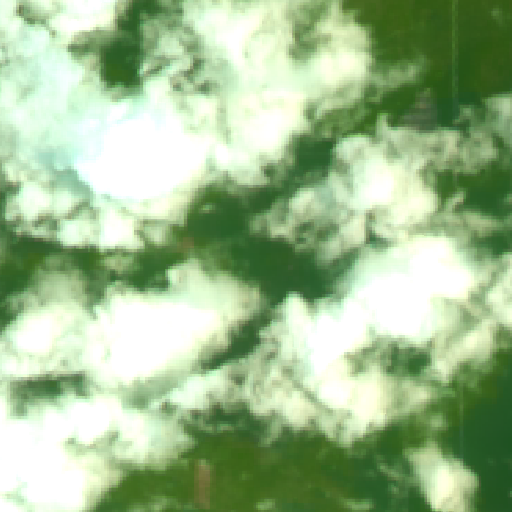

Cloud cover fraction: 0.0


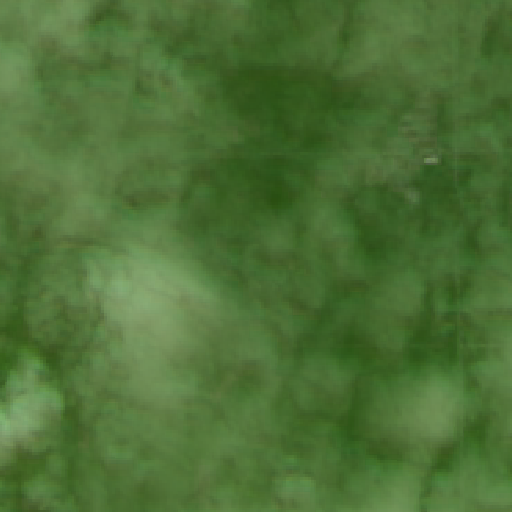

Cloud cover fraction: 0.011806488037109375


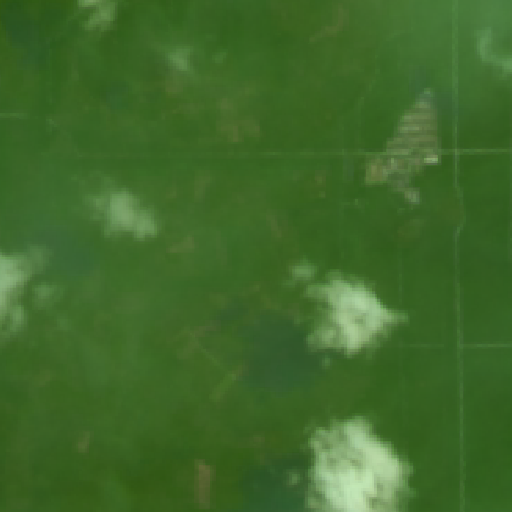

Cloud cover fraction: 0.0


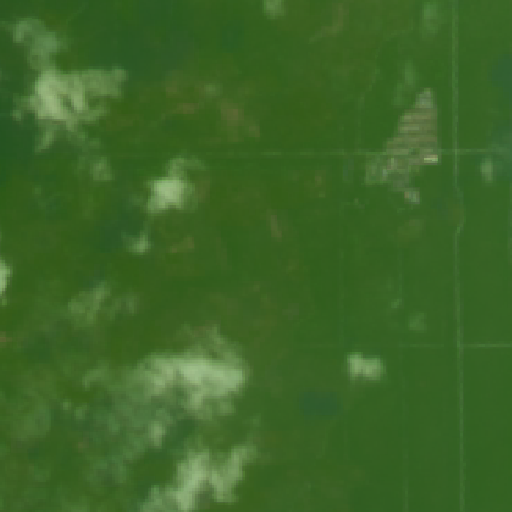

Cloud cover fraction: 0.22458267211914062


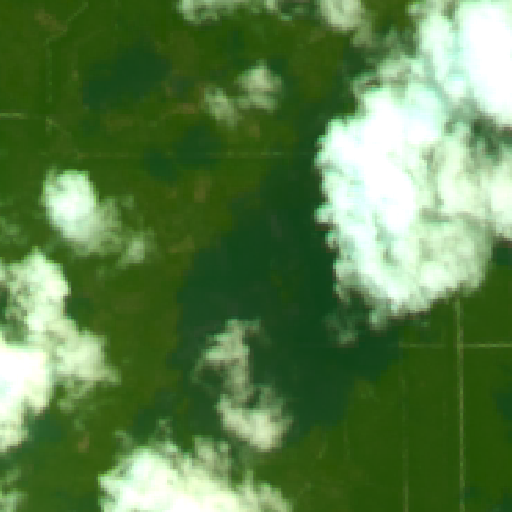

Cloud cover fraction: 0.001110076904296875


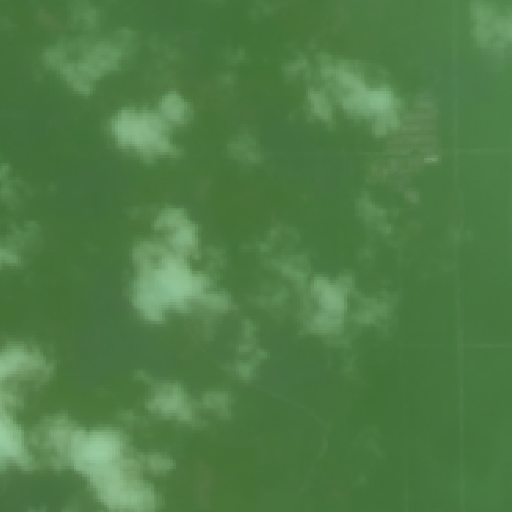

1.525 100.75 2015-01-01 2015-06-30
Cloud cover fraction: 0.0395660400390625


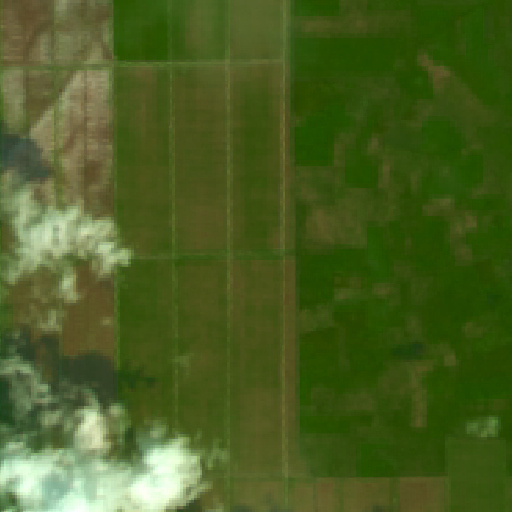

Cloud cover fraction: 0.9859199523925781


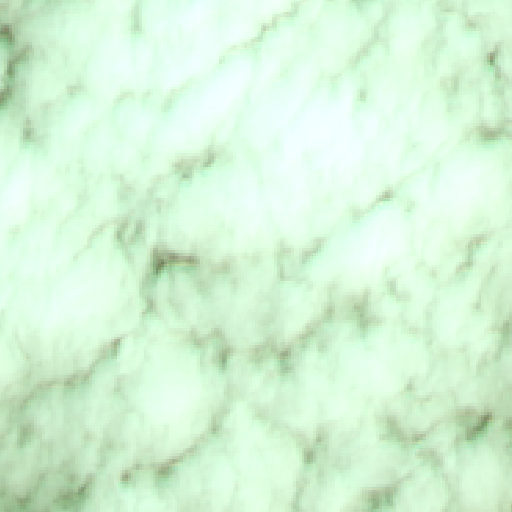

Cloud cover fraction: 0.05066680908203125


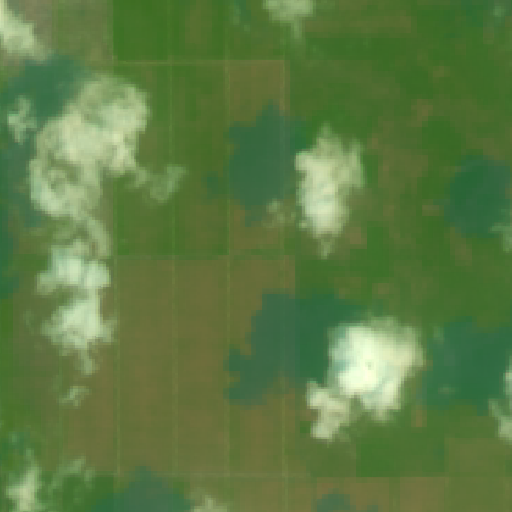

Cloud cover fraction: 0.007160186767578125


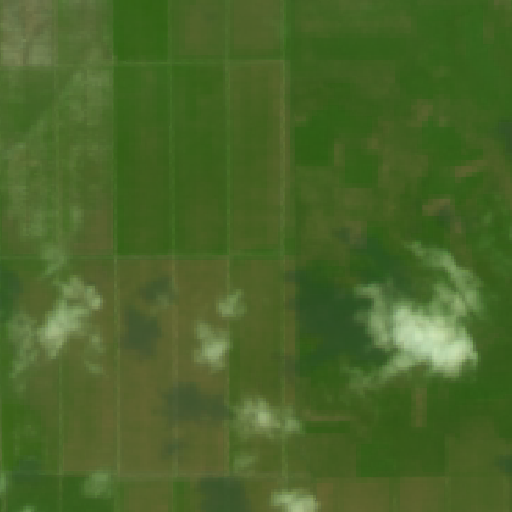

Cloud cover fraction: 0.3196372985839844


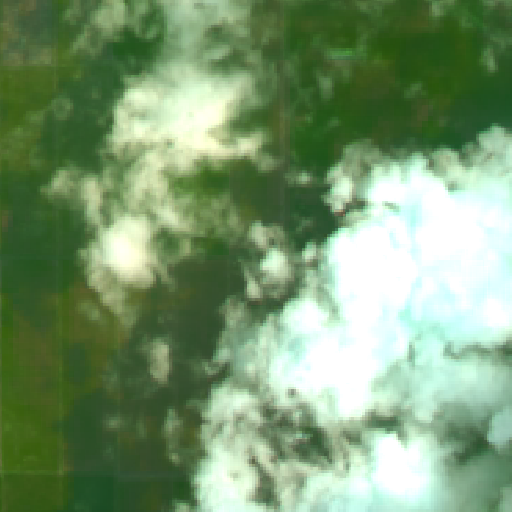

Cloud cover fraction: 0.0


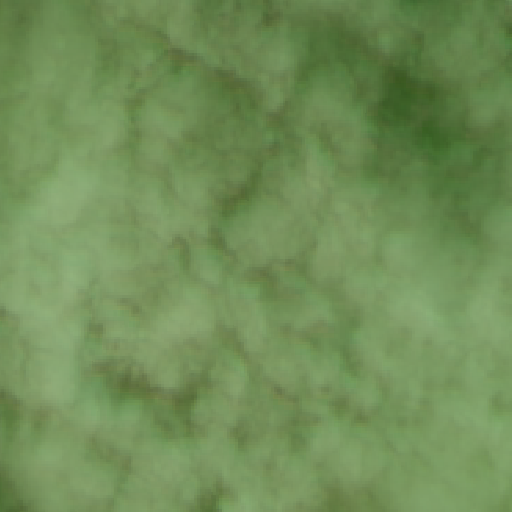

Cloud cover fraction: 0.000652313232421875


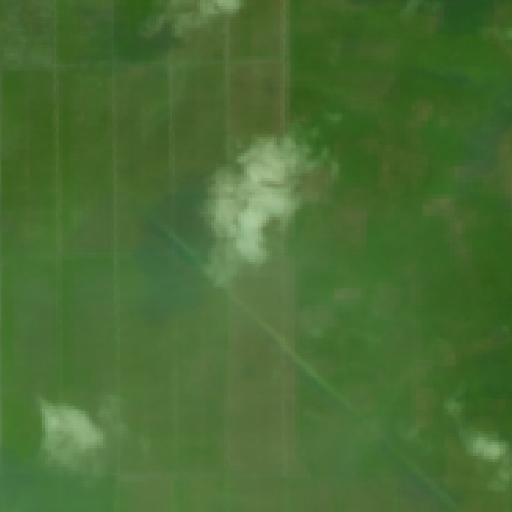

Cloud cover fraction: 0.018184661865234375


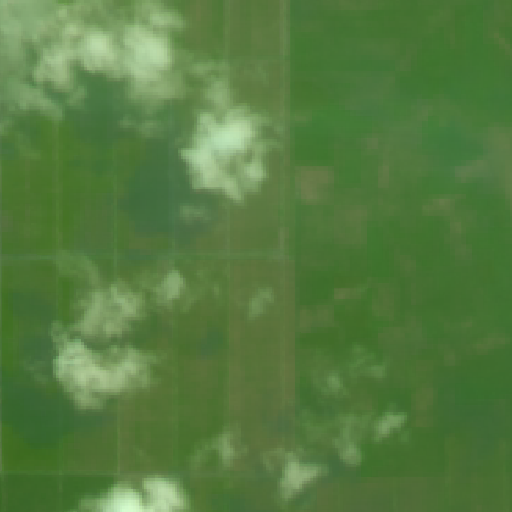

Cloud cover fraction: 0.2587738037109375


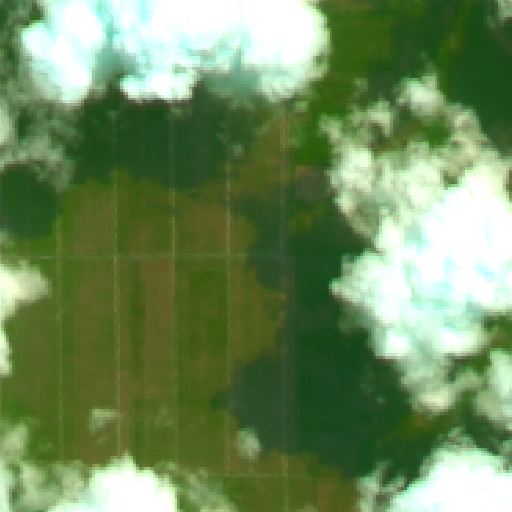

Cloud cover fraction: 0.0


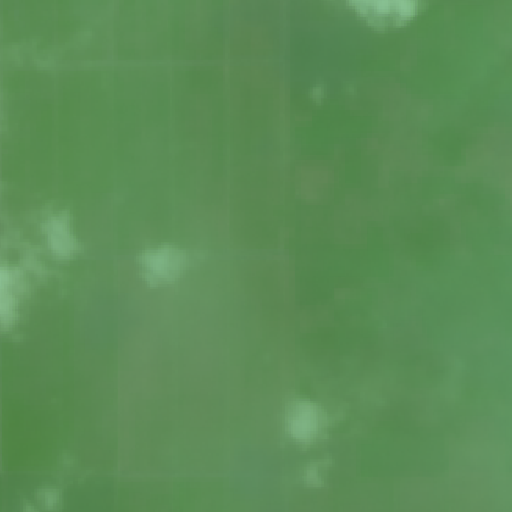

1.475 100.75 2015-01-01 2015-06-30
Cloud cover fraction: 0.06521224975585938


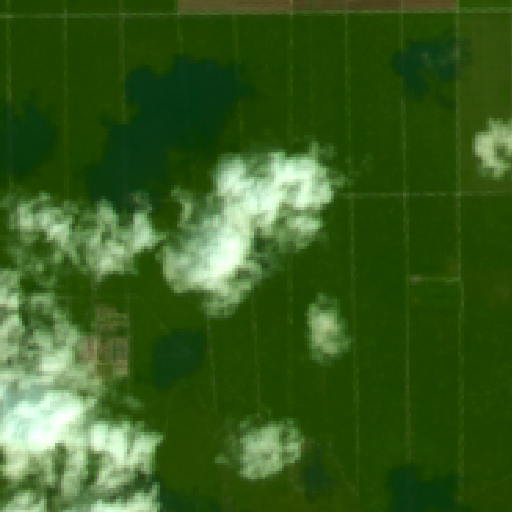

Cloud cover fraction: 0.9578285217285156


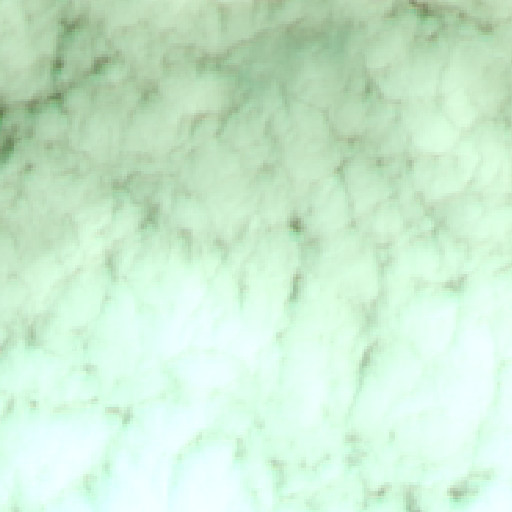

Cloud cover fraction: 0.1535186767578125


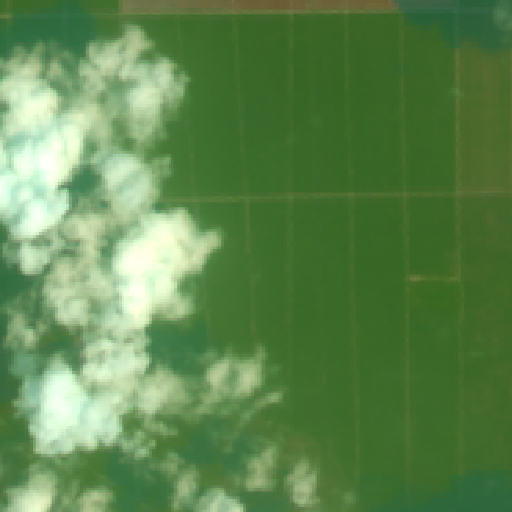

Cloud cover fraction: 0.025737762451171875


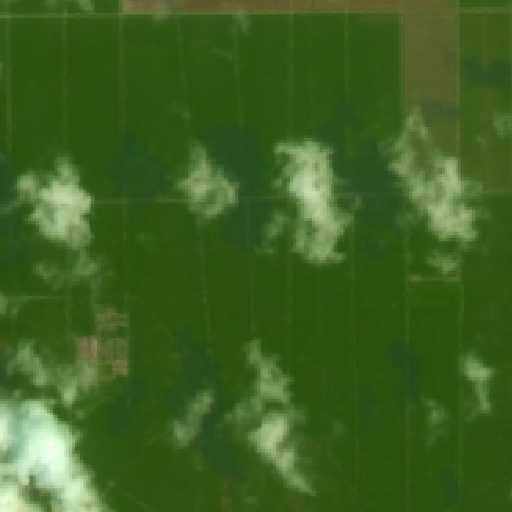

Cloud cover fraction: 0.3496971130371094


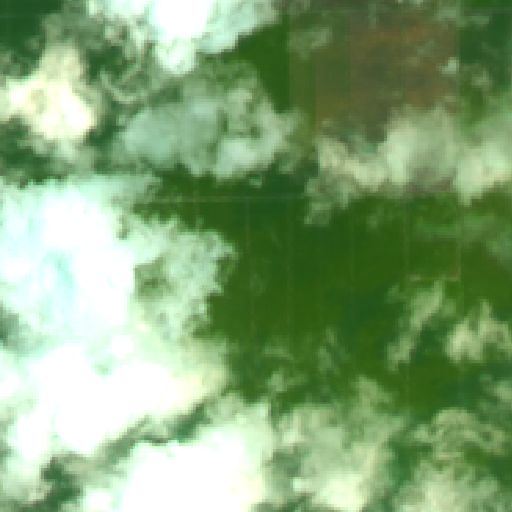

Cloud cover fraction: 0.03934478759765625


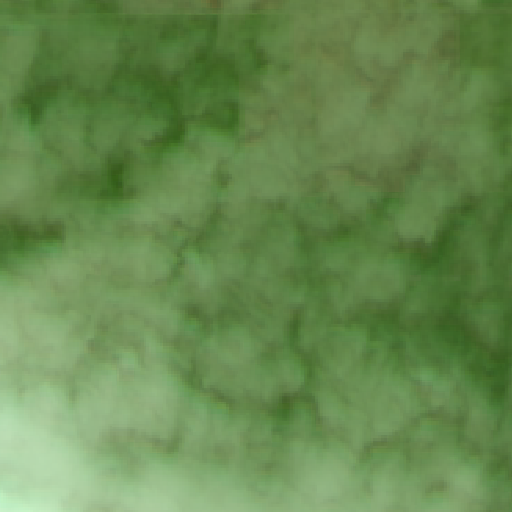

Cloud cover fraction: 0.0


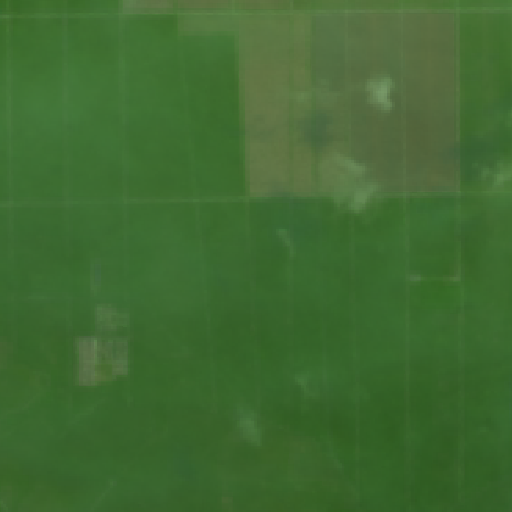

Cloud cover fraction: 0.01300048828125


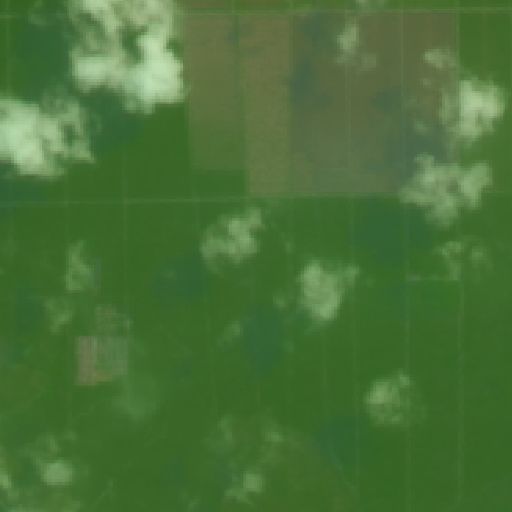

Cloud cover fraction: 0.23073577880859375


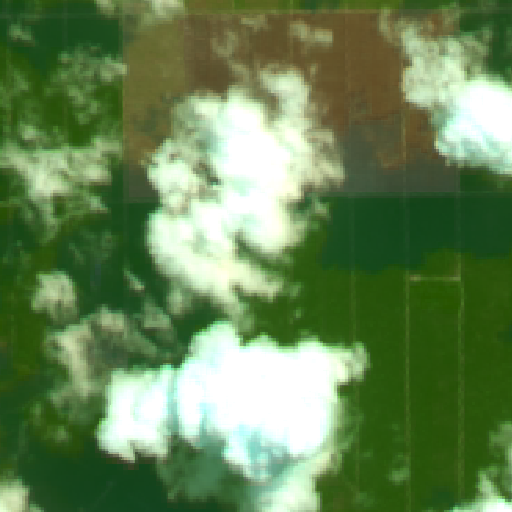

Cloud cover fraction: 0.0


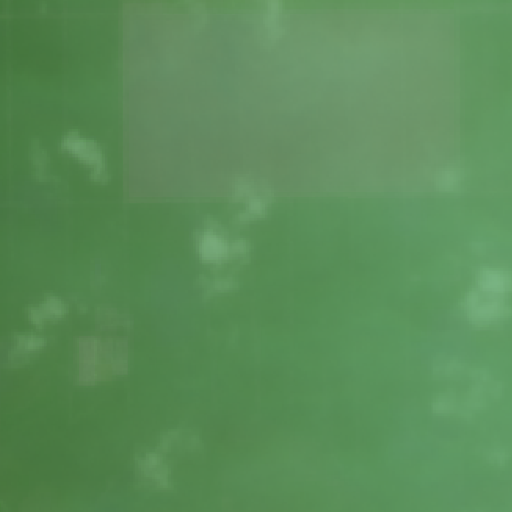

1.525 100.775 2015-01-01 2015-06-30
Cloud cover fraction: 0.0150146484375


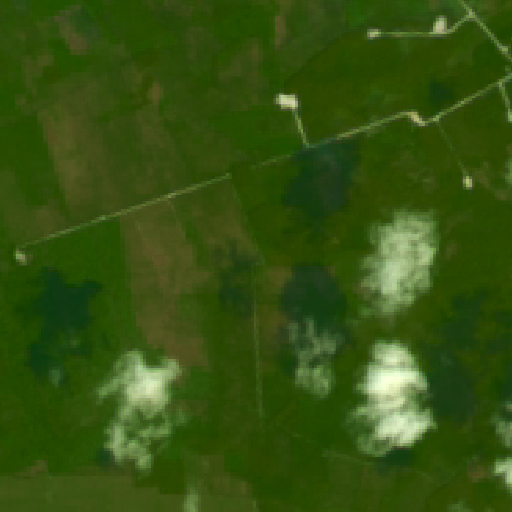

Cloud cover fraction: 0.9683341979980469


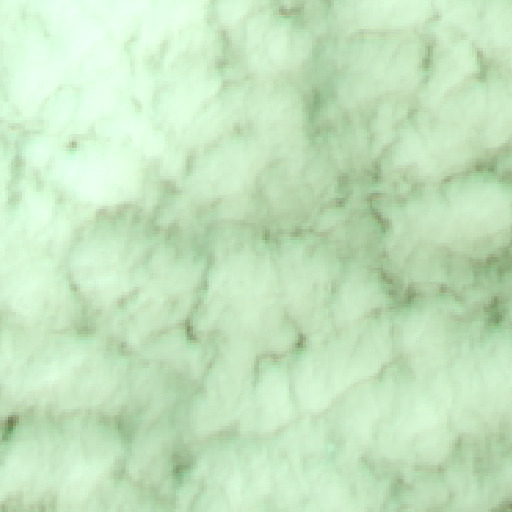

Cloud cover fraction: 0.3028831481933594


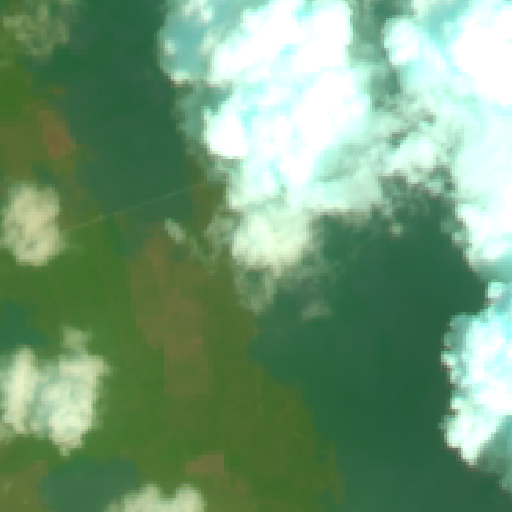

Cloud cover fraction: 0.004459381103515625


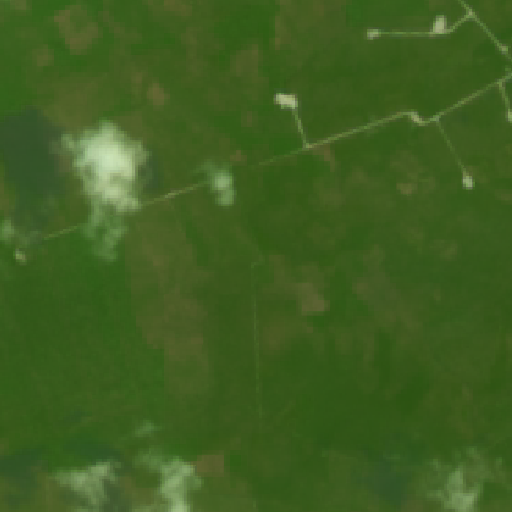

Cloud cover fraction: 0.5829353332519531


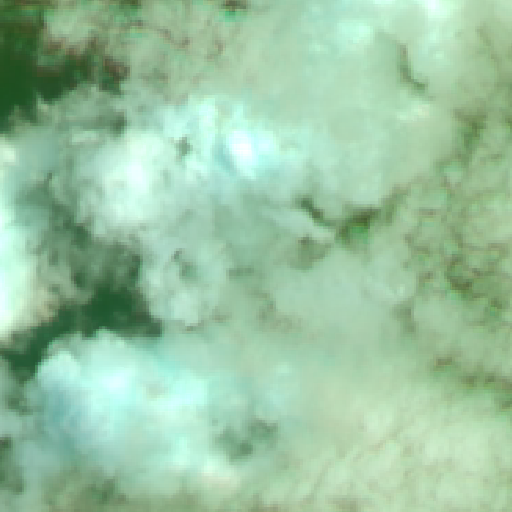

Cloud cover fraction: 0.0035400390625


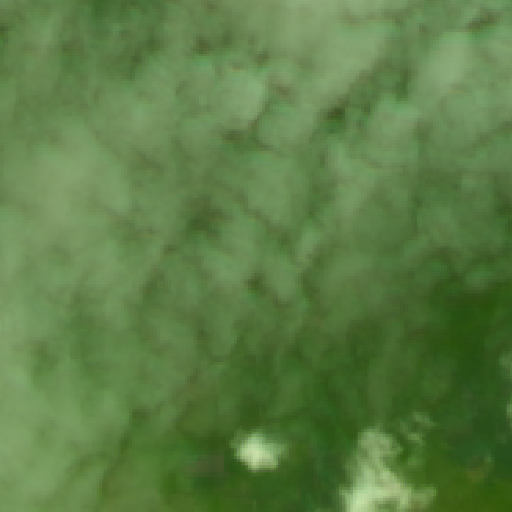

Cloud cover fraction: 0.012920379638671875


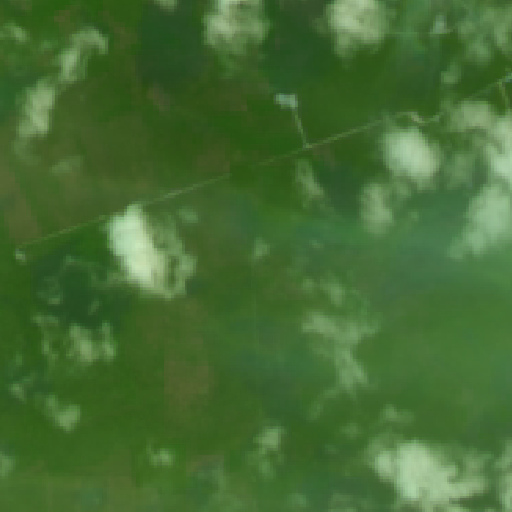

Cloud cover fraction: 0.0


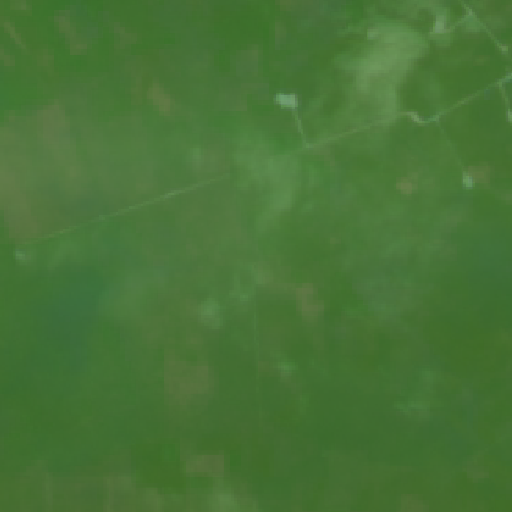

Cloud cover fraction: 0.2513885498046875


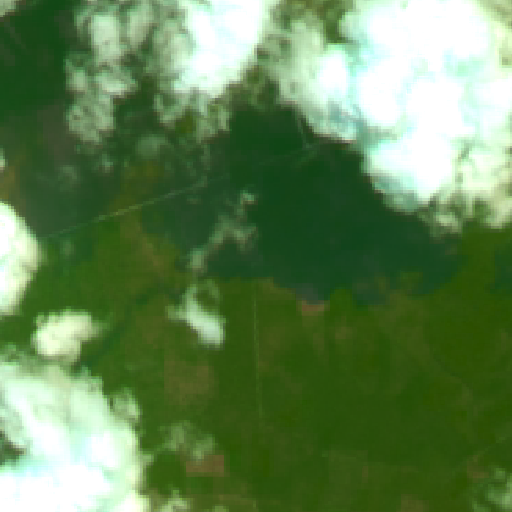

Cloud cover fraction: 0.0


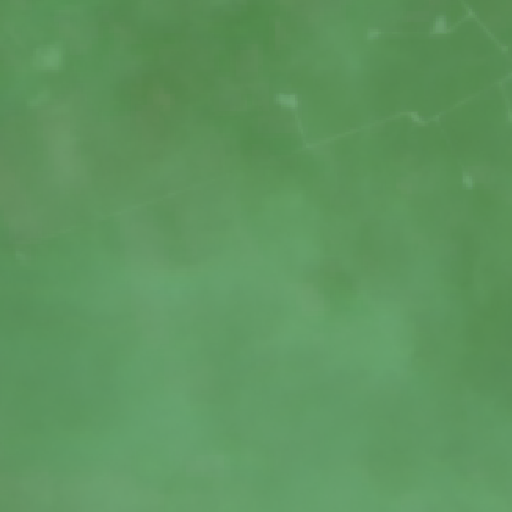

1.475 100.775 2015-01-01 2015-06-30
Cloud cover fraction: 0.00079345703125


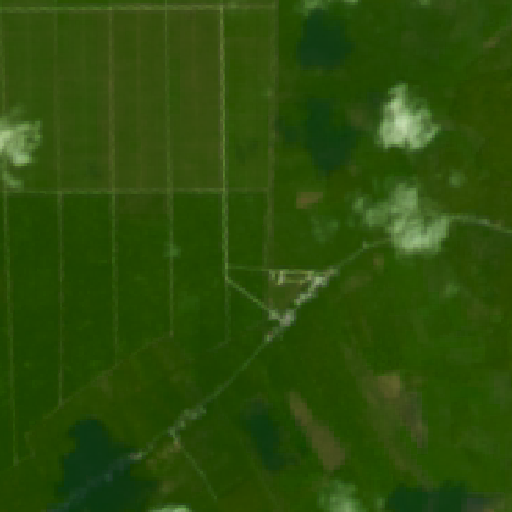

Cloud cover fraction: 0.9758758544921875


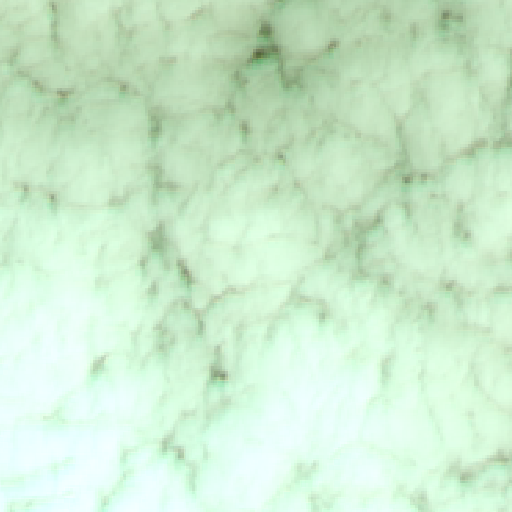

Cloud cover fraction: 0.32677459716796875


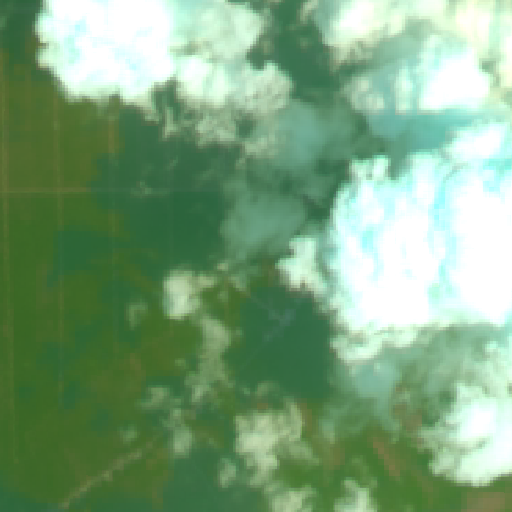

Cloud cover fraction: 0.00043487548828125


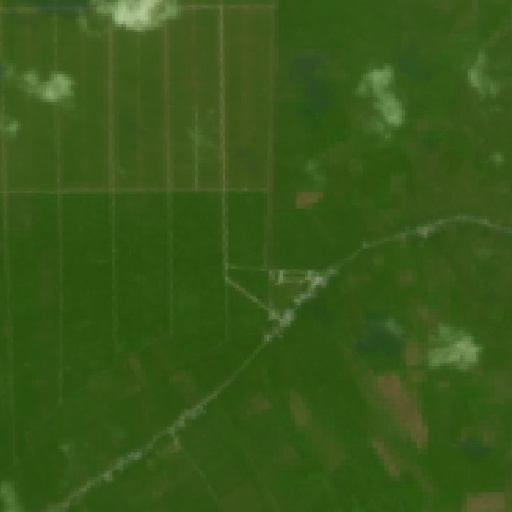

Cloud cover fraction: 0.2195587158203125


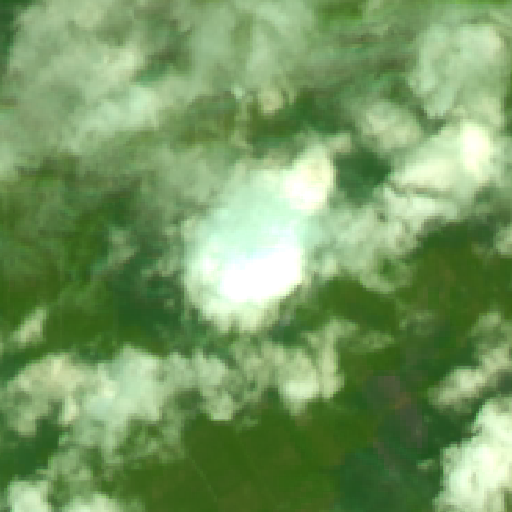

Cloud cover fraction: 0.0


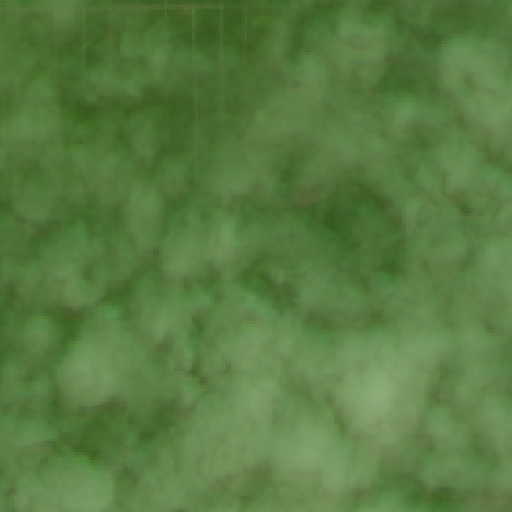

Cloud cover fraction: 0.0035552978515625


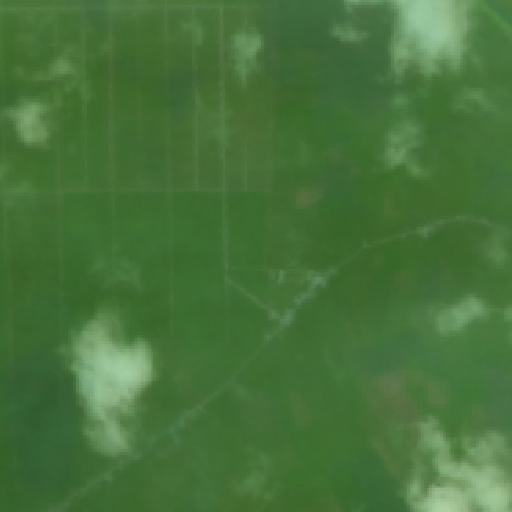

Cloud cover fraction: 0.0


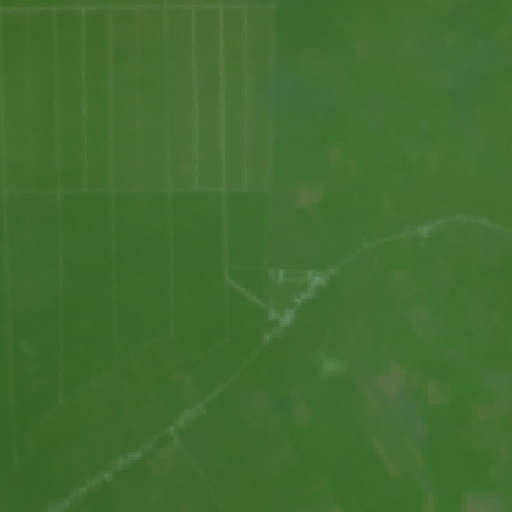

Cloud cover fraction: 0.29566192626953125


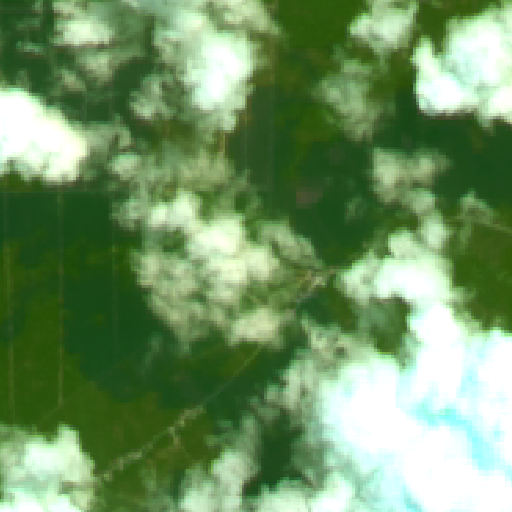

Cloud cover fraction: 0.0


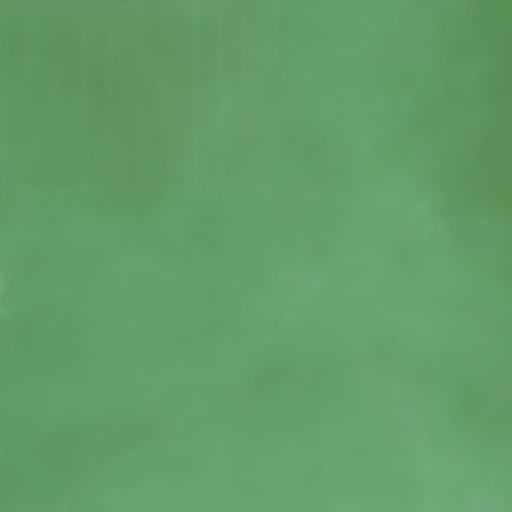

1.525 100.725 2015-01-01 2015-06-30
Cloud cover fraction: 0.051055908203125


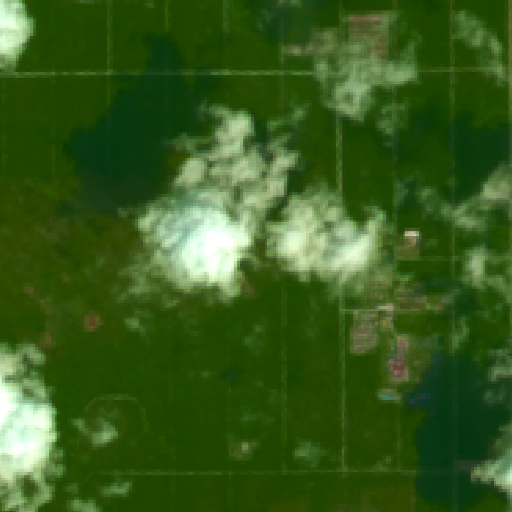

Cloud cover fraction: 0.9489364624023438


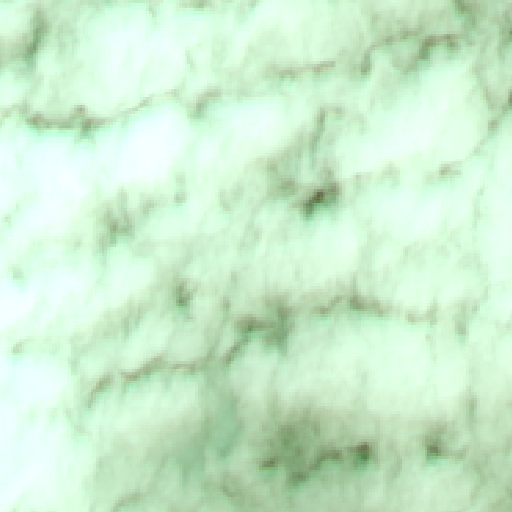

Cloud cover fraction: 0.04868316650390625


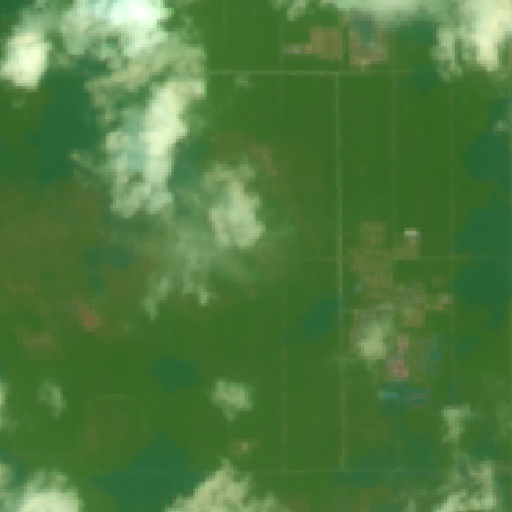

Cloud cover fraction: 1.52587890625e-05


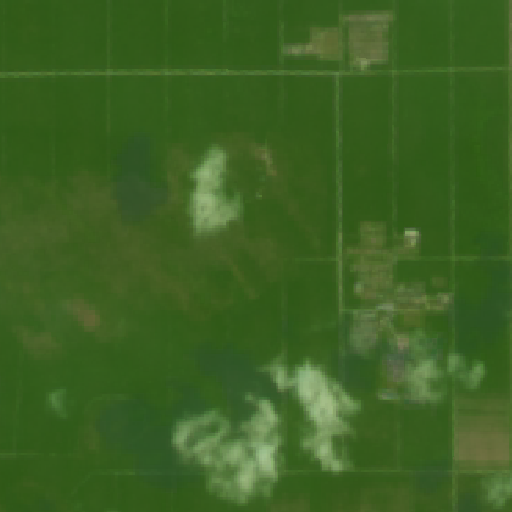

Cloud cover fraction: 0.1116943359375


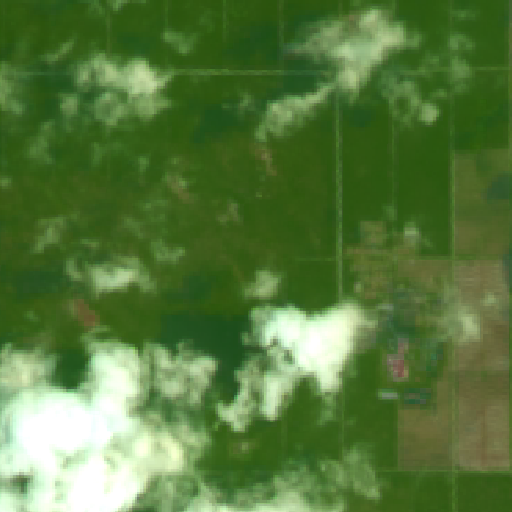

Cloud cover fraction: 0.0


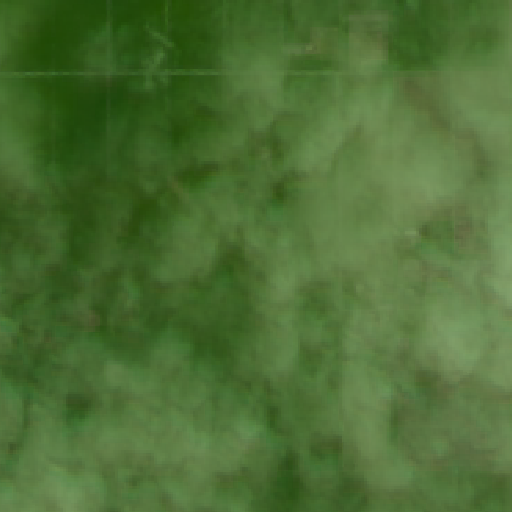

Cloud cover fraction: 0.0


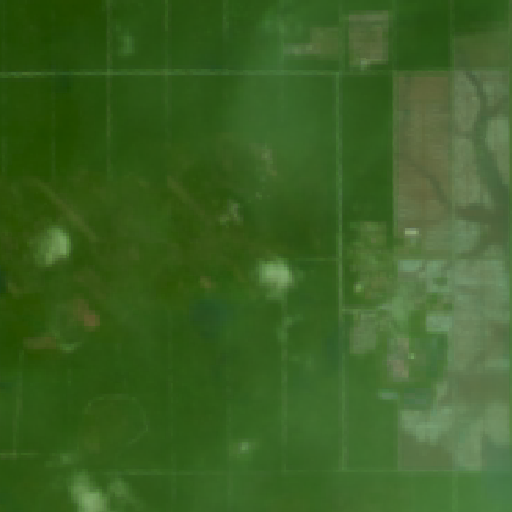

Cloud cover fraction: 0.0


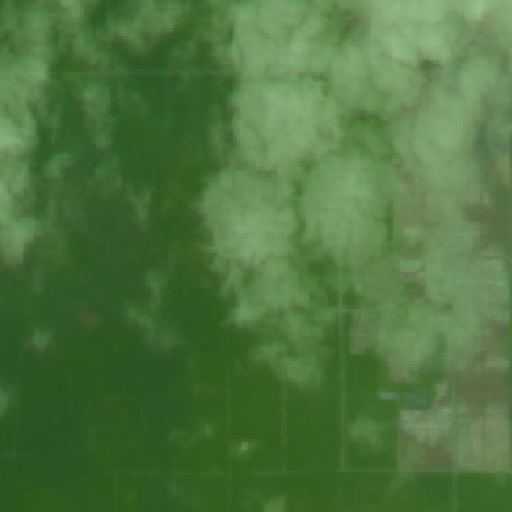

Cloud cover fraction: 0.219024658203125


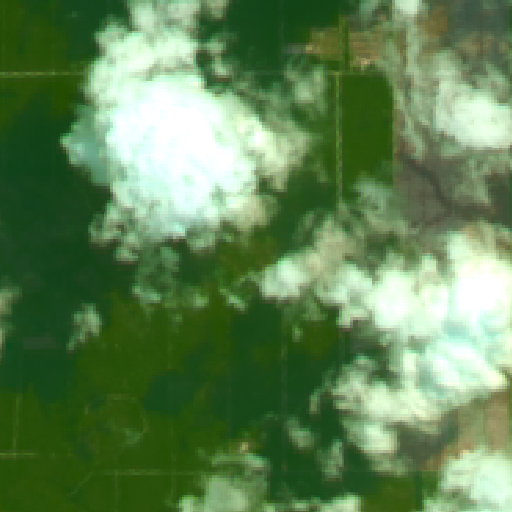

Cloud cover fraction: 0.001522064208984375


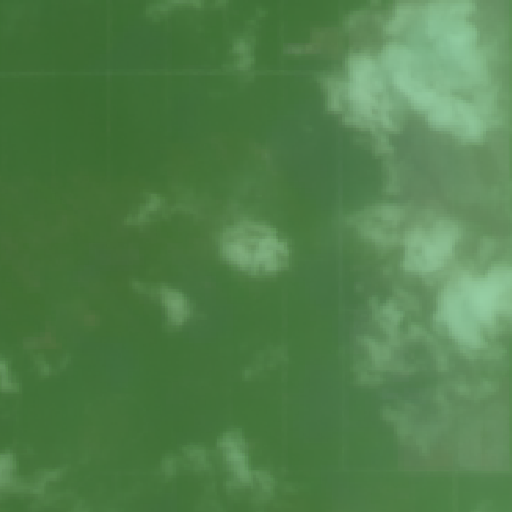

1.475 100.725 2015-01-01 2015-06-30
Cloud cover fraction: 0.11857223510742188


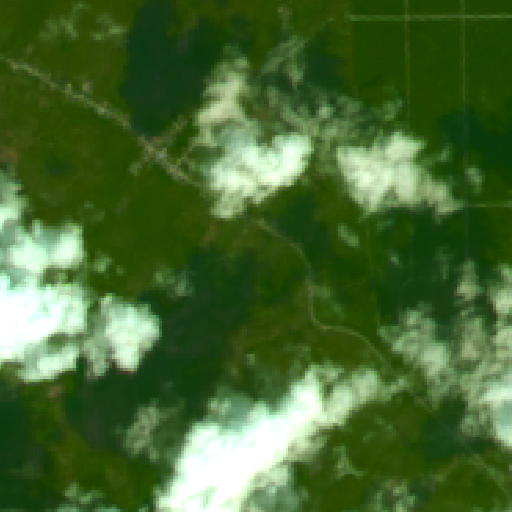

Cloud cover fraction: 0.9626998901367188


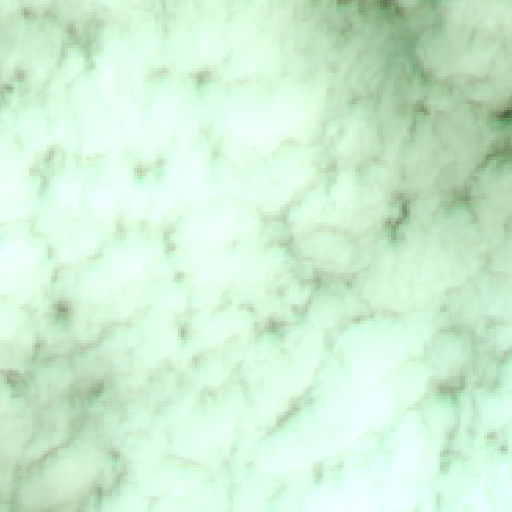

Cloud cover fraction: 0.17735671997070312


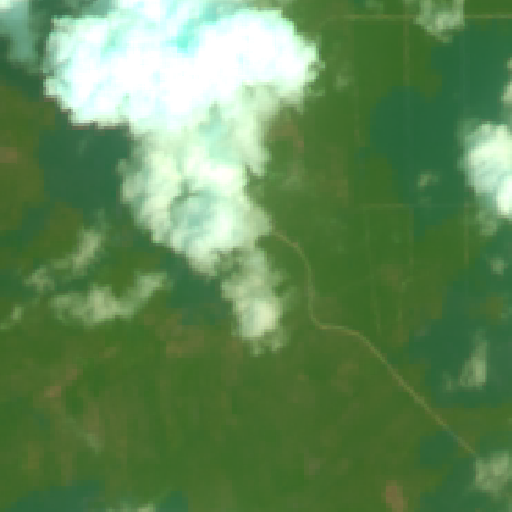

Cloud cover fraction: 0.003475189208984375


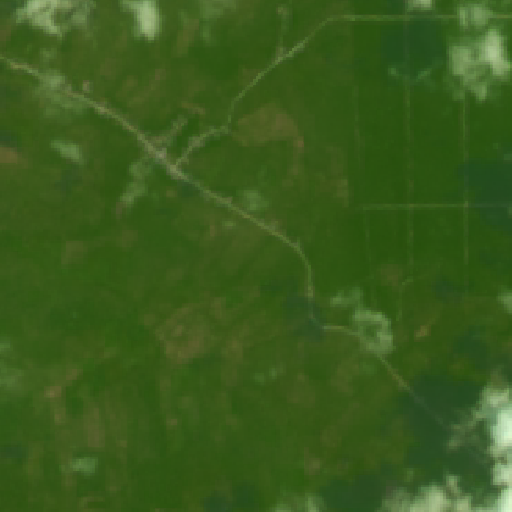

Only 9.9% of your rate limit is remaining!
Only 9.8% of your rate limit is remaining!


Cloud cover fraction: 0.6005630493164062


Only 9.7% of your rate limit is remaining!


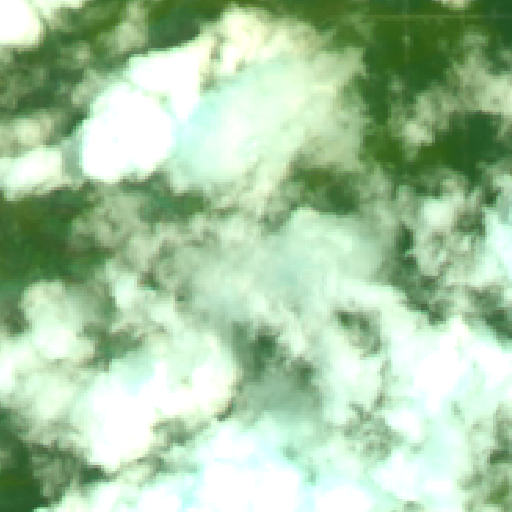

Only 9.6% of your rate limit is remaining!
Only 9.5% of your rate limit is remaining!


Cloud cover fraction: 0.4129447937011719


Only 9.4% of your rate limit is remaining!


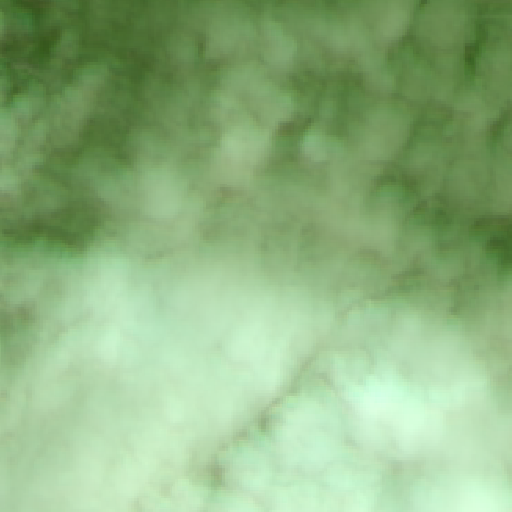

Only 9.3% of your rate limit is remaining!
Only 9.2% of your rate limit is remaining!


Cloud cover fraction: 0.000885009765625


Only 9.1% of your rate limit is remaining!


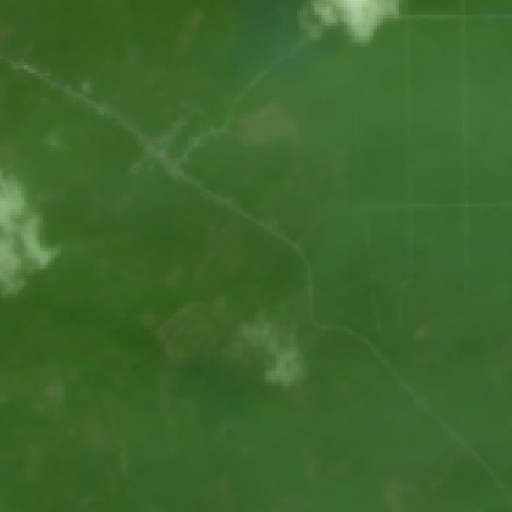

Only 9.0% of your rate limit is remaining!
Only 8.9% of your rate limit is remaining!


Cloud cover fraction: 0.0031585693359375


Only 8.8% of your rate limit is remaining!


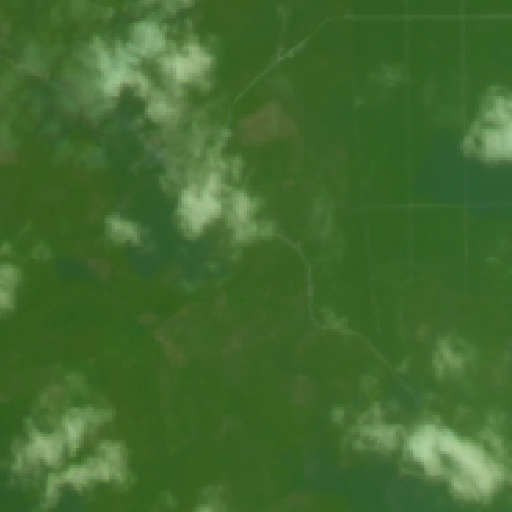

Only 8.7% of your rate limit is remaining!
Only 8.6% of your rate limit is remaining!


Cloud cover fraction: 0.4234123229980469


Only 8.5% of your rate limit is remaining!


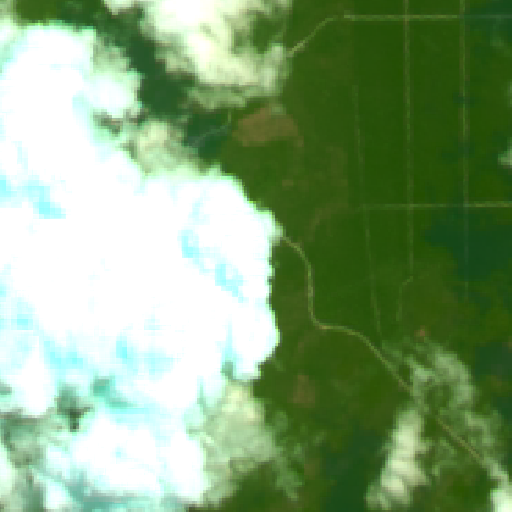

Only 8.4% of your rate limit is remaining!
Only 8.3% of your rate limit is remaining!


Cloud cover fraction: 0.0


Only 8.2% of your rate limit is remaining!


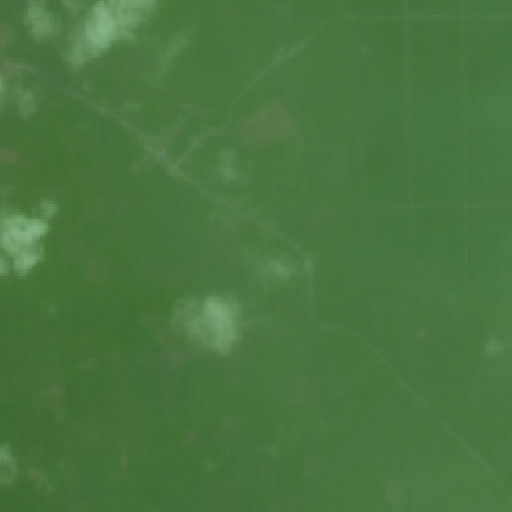

Only 8.1% of your rate limit is remaining!


2015-01-01 2015-06-30

The average cloud coverage is: 0.18881615532769094 from 2015-01-01 to 2015-06-30.

1.5 100.75 2015-07-01 2015-12-31


Only 8.1% of your rate limit is remaining!
Only 7.9% of your rate limit is remaining!


Cloud cover fraction: 0.0


Only 7.8% of your rate limit is remaining!


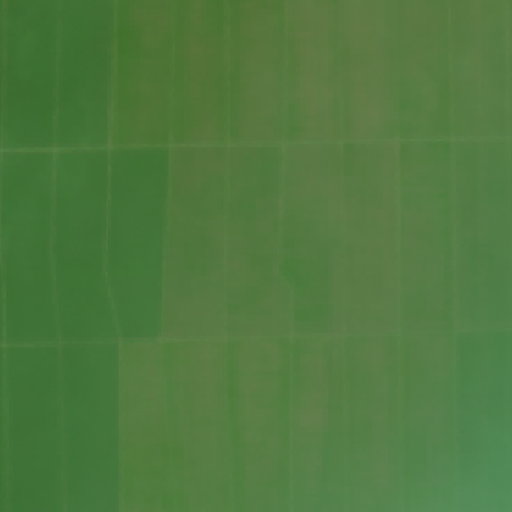

Only 7.7% of your rate limit is remaining!
Only 7.6% of your rate limit is remaining!


Cloud cover fraction: 0.19481658935546875


Only 7.5% of your rate limit is remaining!


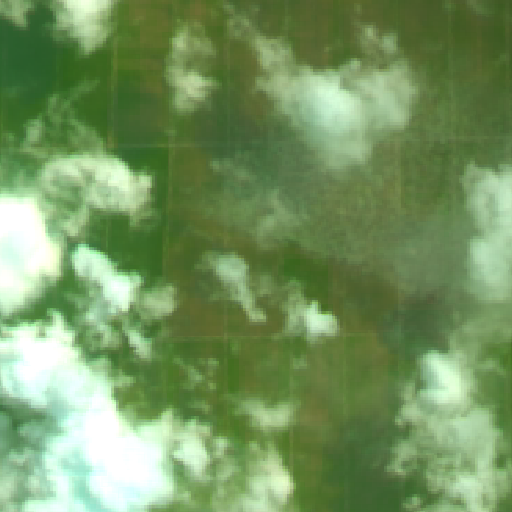

Only 7.4% of your rate limit is remaining!
Only 7.3% of your rate limit is remaining!


Cloud cover fraction: 0.0


Only 7.2% of your rate limit is remaining!


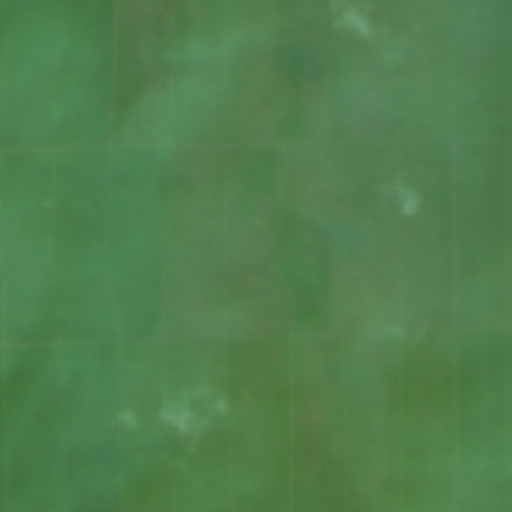

Only 7.1% of your rate limit is remaining!
Only 7.0% of your rate limit is remaining!


Cloud cover fraction: 0.001110076904296875


Only 6.9% of your rate limit is remaining!


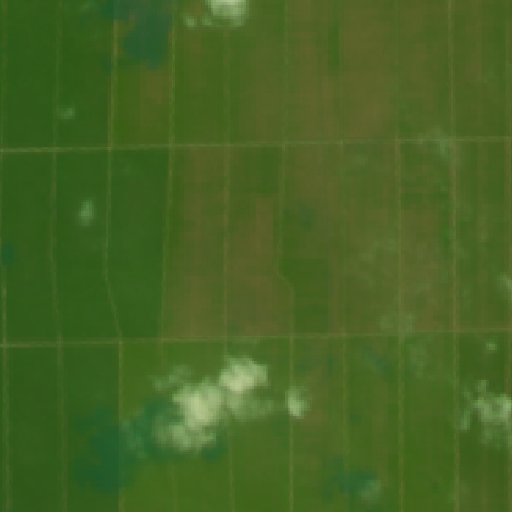

Only 6.8% of your rate limit is remaining!
Only 6.7% of your rate limit is remaining!


Cloud cover fraction: 0.8475532531738281


Only 6.6% of your rate limit is remaining!


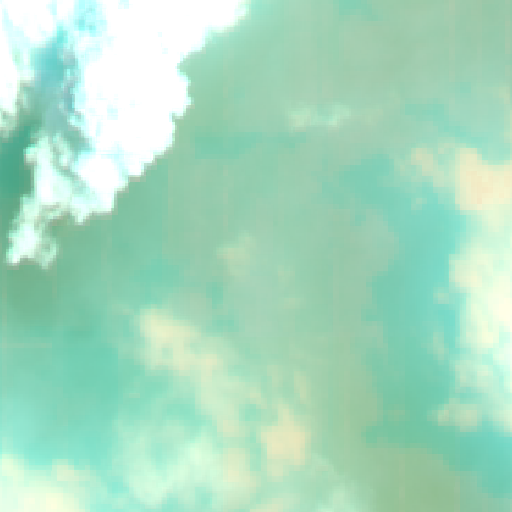

Only 6.5% of your rate limit is remaining!
Only 6.4% of your rate limit is remaining!


Cloud cover fraction: 1.0


Only 6.3% of your rate limit is remaining!


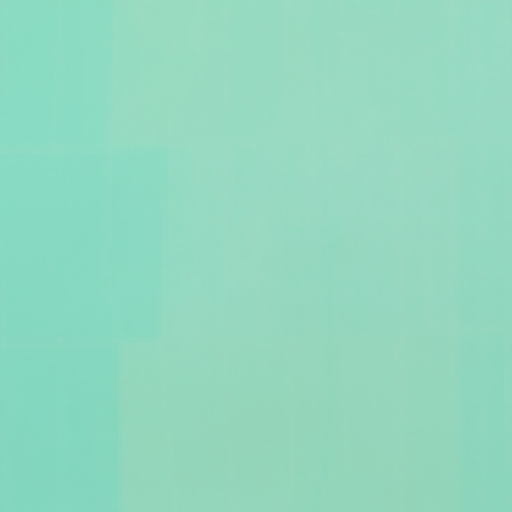

Only 6.2% of your rate limit is remaining!
Only 6.1% of your rate limit is remaining!


Cloud cover fraction: 1.0


Only 6.0% of your rate limit is remaining!


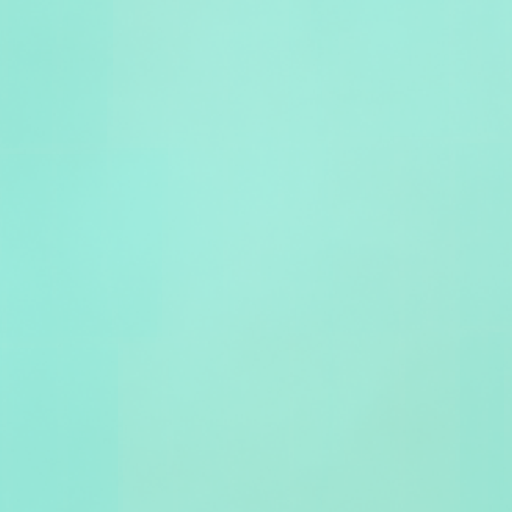

Only 5.9% of your rate limit is remaining!
Only 5.8% of your rate limit is remaining!


Cloud cover fraction: 0.04242706298828125


Only 5.7% of your rate limit is remaining!


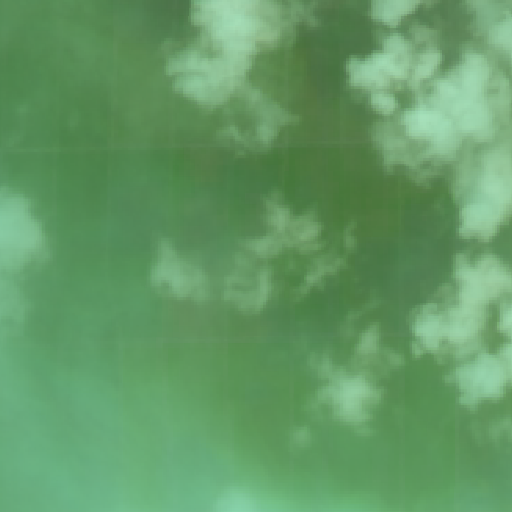

Only 5.6% of your rate limit is remaining!
Only 5.5% of your rate limit is remaining!


Cloud cover fraction: 0.12139511108398438


Only 5.4% of your rate limit is remaining!


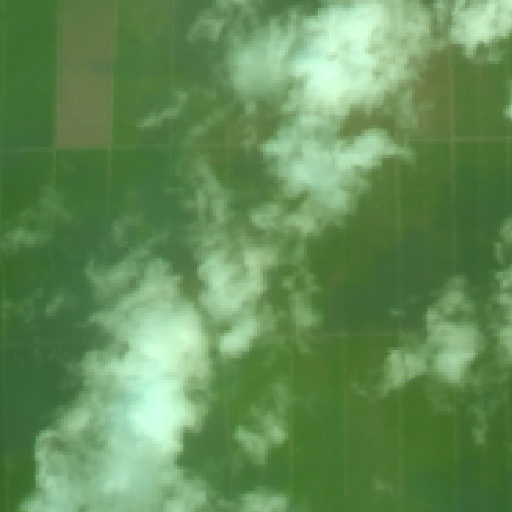

Only 5.3% of your rate limit is remaining!
Only 5.2% of your rate limit is remaining!


Cloud cover fraction: 0.0


Only 5.1% of your rate limit is remaining!


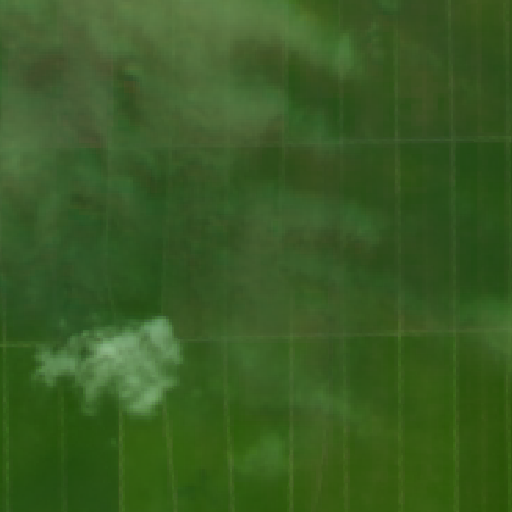

Only 5.0% of your rate limit is remaining!


1.5 100.775 2015-07-01 2015-12-31


Only 4.9% of your rate limit is remaining!
Only 4.8% of your rate limit is remaining!


Cloud cover fraction: 0.0


Only 4.7% of your rate limit is remaining!


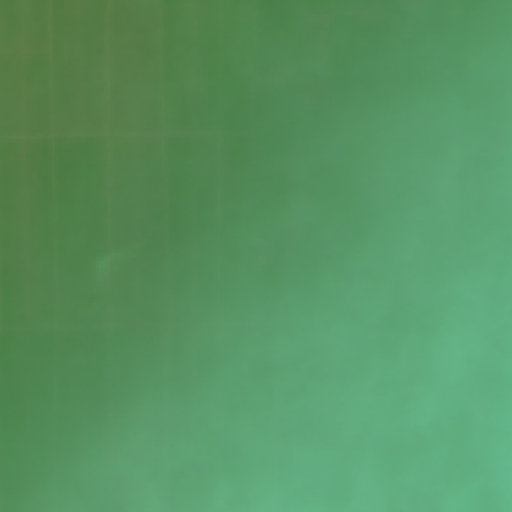

Only 4.6% of your rate limit is remaining!
Only 4.5% of your rate limit is remaining!


Cloud cover fraction: 0.0917205810546875


Only 4.4% of your rate limit is remaining!


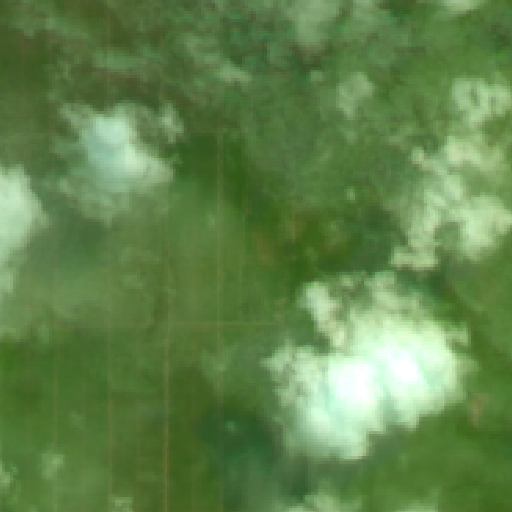

Only 4.3% of your rate limit is remaining!
Only 4.2% of your rate limit is remaining!


Cloud cover fraction: 0.0


Only 4.1% of your rate limit is remaining!


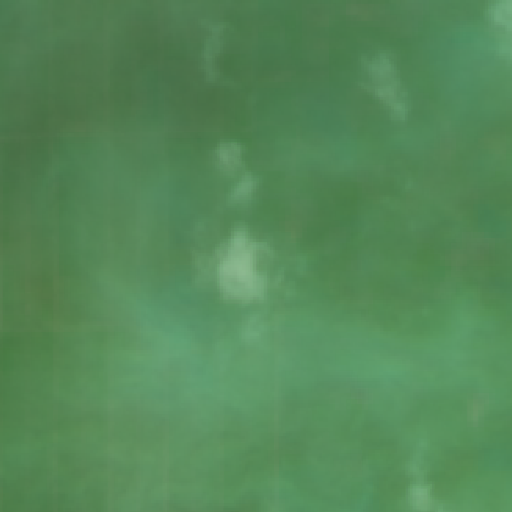

Only 4.0% of your rate limit is remaining!
Only 3.9% of your rate limit is remaining!


Cloud cover fraction: 0.01378631591796875


Only 3.8% of your rate limit is remaining!


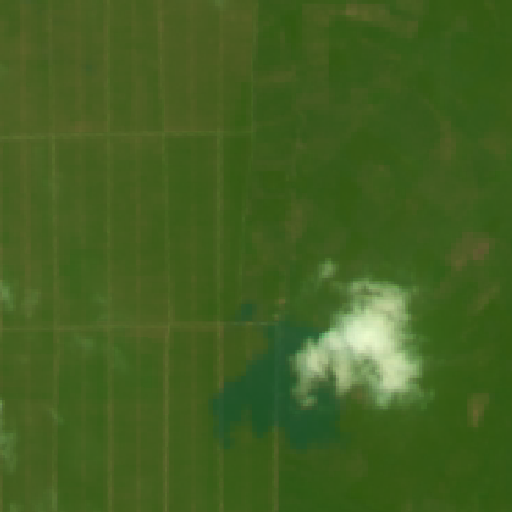

Only 3.7% of your rate limit is remaining!
Only 3.6% of your rate limit is remaining!


Cloud cover fraction: 0.9650230407714844


Only 3.5% of your rate limit is remaining!


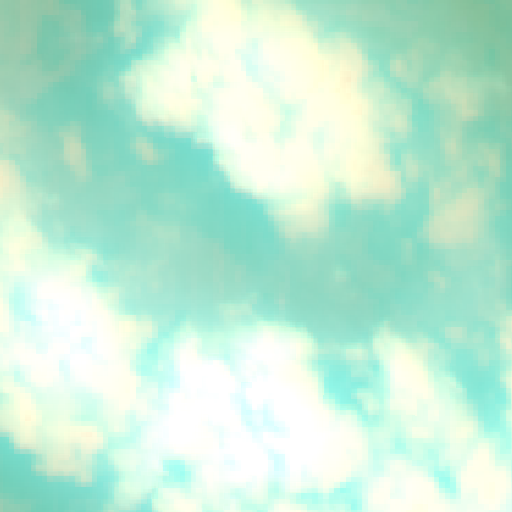

Only 3.4% of your rate limit is remaining!
Only 3.3% of your rate limit is remaining!


Cloud cover fraction: 1.0


Only 3.2% of your rate limit is remaining!


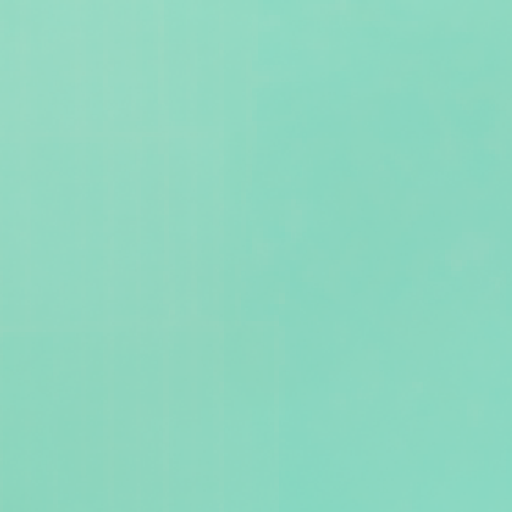

Only 3.1% of your rate limit is remaining!
Only 3.0% of your rate limit is remaining!


Cloud cover fraction: 1.0


Only 2.9% of your rate limit is remaining!


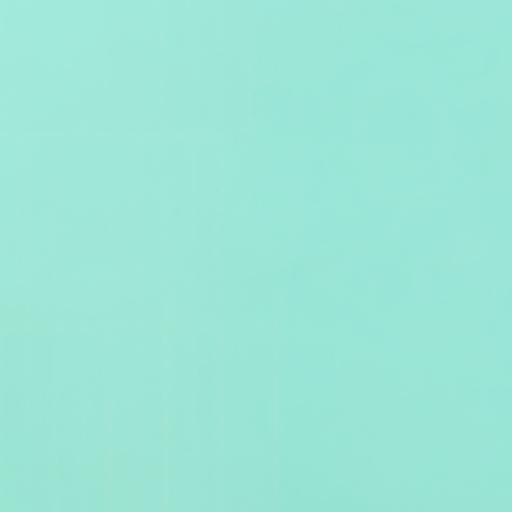

Only 2.8% of your rate limit is remaining!
Only 2.7% of your rate limit is remaining!


Cloud cover fraction: 0.306610107421875


Only 2.6% of your rate limit is remaining!


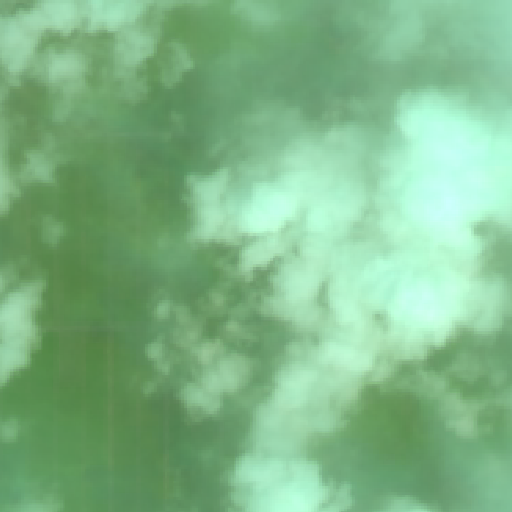

Only 2.5% of your rate limit is remaining!
Only 2.4% of your rate limit is remaining!


Cloud cover fraction: 0.3702583312988281


Only 2.3% of your rate limit is remaining!


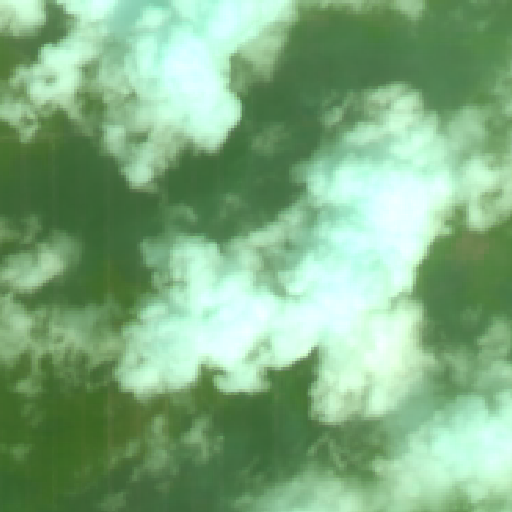

Only 2.2% of your rate limit is remaining!
Only 2.1% of your rate limit is remaining!


Cloud cover fraction: 0.008266448974609375


Only 2.0% of your rate limit is remaining!


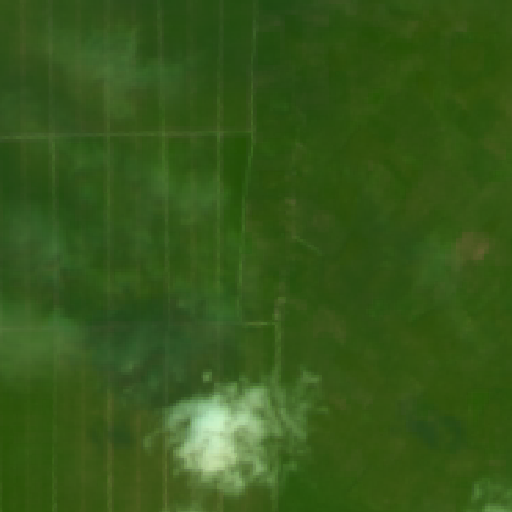

Only 1.9% of your rate limit is remaining!


1.5 100.725 2015-07-01 2015-12-31


Only 1.9% of your rate limit is remaining!
Only 1.7% of your rate limit is remaining!


Cloud cover fraction: 0.0


Only 1.6% of your rate limit is remaining!


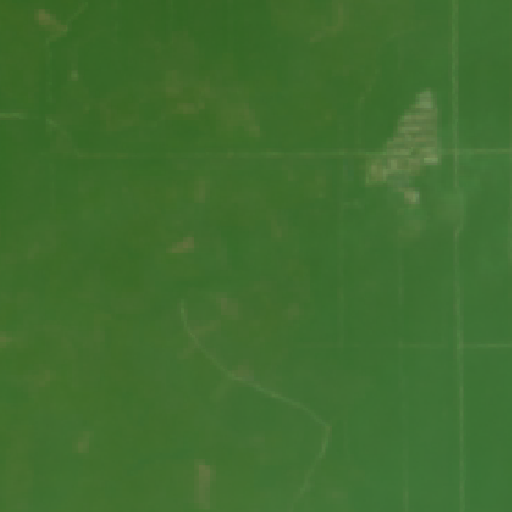

Only 1.5% of your rate limit is remaining!
Only 1.4% of your rate limit is remaining!


Cloud cover fraction: 0.14694595336914062


Only 1.3% of your rate limit is remaining!


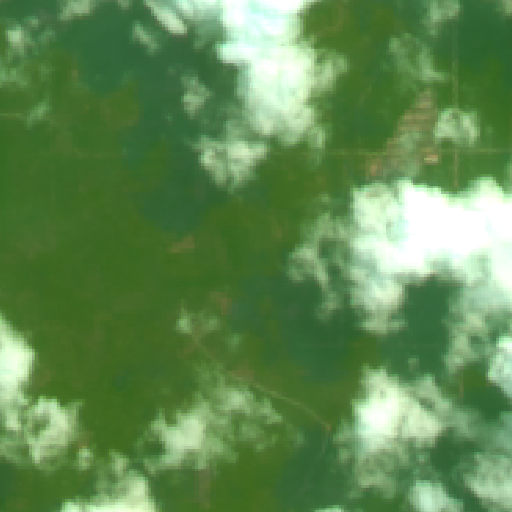

Only 1.2% of your rate limit is remaining!
Only 1.1% of your rate limit is remaining!


Cloud cover fraction: 0.00034332275390625


Only 1.0% of your rate limit is remaining!


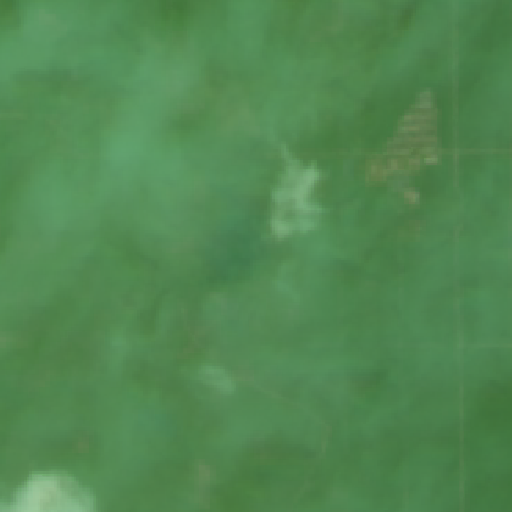

Only 0.9% of your rate limit is remaining!
Only 0.8% of your rate limit is remaining!


Cloud cover fraction: 0.01204681396484375


Only 0.7% of your rate limit is remaining!


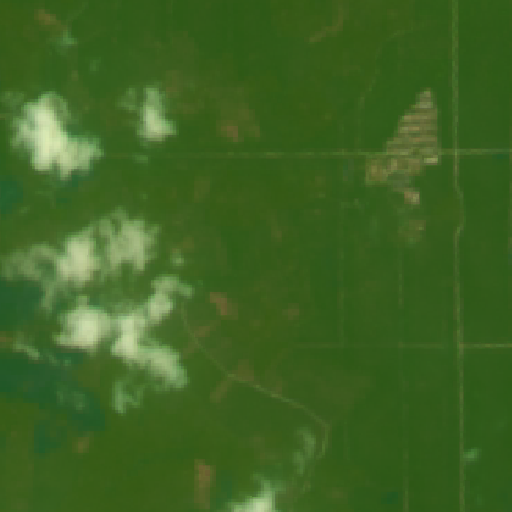

Only 0.6% of your rate limit is remaining!
Only 0.5% of your rate limit is remaining!


Cloud cover fraction: 0.7839431762695312


Only 0.4% of your rate limit is remaining!


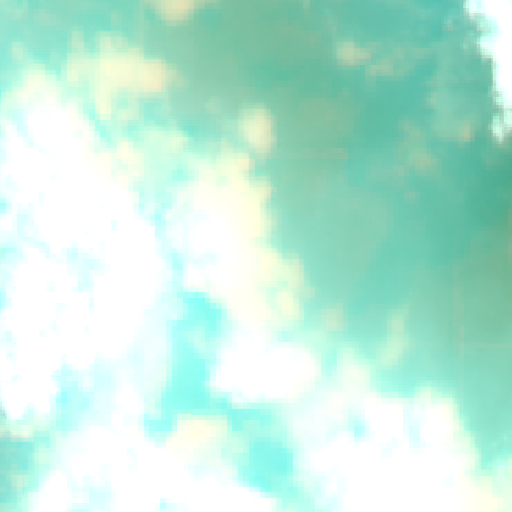

Only 0.3% of your rate limit is remaining!
Only 0.2% of your rate limit is remaining!


Cloud cover fraction: 1.0


Only 0.1% of your rate limit is remaining!


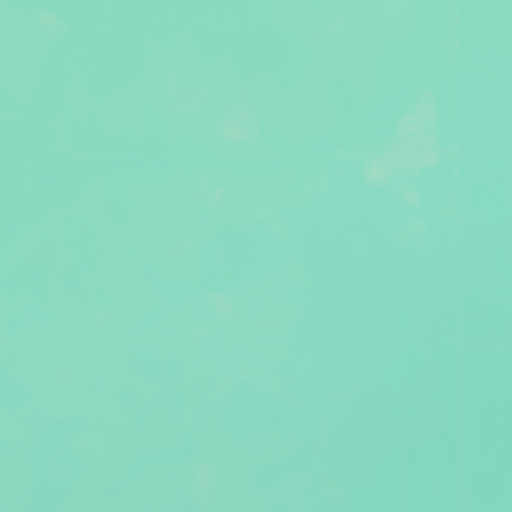

Only 0.0% of your rate limit is remaining!


RateLimitException: You have exceeded your rate limit

In [3]:
# Your code goes here
from nasa import earth
from IPython.display import display
#import image
import os
os.environ["NASA_API_KEY"]="F39Ns48L1oD5eCgTLurLmZFipW6UUyq2t5RkAep6"
#pandas
#stats
#scikit-learn

def fraction_white_pixels(image):
    # Greyscale ranges from 0 (black) to 255 (white). 
    image_dimensions_in_pixels=image.size[0]*image.size[1]
    colors=image.convert('L').getcolors(image_dimensions_in_pixels) #converts image to greyscale then gets colors
    n_pixels_closeto_white=0
    for pixel_count,color in colors:
        if color/255>0.70: # this is checking if it's more than 80% white
            n_pixels_closeto_white+=pixel_count
    return n_pixels_closeto_white/image_dimensions_in_pixels

#def makemorewhite(image):
#    image_dimensions_in_pixels=image.size[0]*image.size[1]
#    for row in range(image.getHeight()):
#        for col in range(image.getWidth()):
#            p = image.getPixel(col, row)
#            if p.getRed() > 215 and p.getBlue() > 215 and p.getGreen() > 215:
#                newpixel = image.Pixel(255, 255, 255)
#                img.setPixel(col, row, newpixel)
#                
#center, top, bottom, right, left, topright, topleft, bottomright, bottomleft
latitudes = [1.5, 1.5, 1.5, 1.525, 1.5 - 0.025, 1.525, 1.5 - 0.025, 1.525, 1.5 - 0.025]
print("run check")
longitudes = [100.75, 100.75 + 0.025, 100.75 - 0.025, 100.75, 100.75,  100.75 + 0.025,  100.75 + 0.025, 100.75 - 0.025, 100.75 - 0.025]

yr = 2014
counter = 0
while yr <= 2016:
    try:
        if counter % 2 == 0:
            begindate = str(yr) + "-01-01"
            enddate = str(yr) + "-06-30"
        else:
            begindate = str(yr) + "-07-01"
            enddate = str(yr) + "-12-31"
            yr += 1
        counter += 1
        avgbig = 0
        for i in range(9):
            assets = earth.assets(latitudes[i], longitudes[i], begindate, enddate)
            print(latitudes[i], longitudes[i], begindate, enddate)
            alldatecoverage = 0
            counter2 = 0
            for a in assets:
                if type(a.get_asset_image().image) == None:
                    continue
                f=fraction_white_pixels(a.get_asset_image().image)
                alldatecoverage += f
                counter2+=1
                print("Cloud cover fraction:",f)
                display(a.get_asset_image().image)
            avgsmall = alldatecoverage/counter2
            avgbig += avgsmall
        avgbig = avgbig/9
        print(begindate, enddate)
        print("\nThe average cloud coverage is: " + str(avgbig) + " from " + begindate + " to " + enddate + ".\n")
    except OSError:
        pass